<a href="https://colab.research.google.com/github/sara81278/ENN_internal/blob/main/ENN_Vectorized_Experiments.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [66]:
!pip install torcheval
import numpy as np
from scipy import special
from scipy.interpolate import griddata
import matplotlib.pyplot as plt
from matplotlib import cm
#from matplotlib.ticker import LinearLocator
from matplotlib.gridspec import GridSpec
import matplotlib.colors
import copy
import torch
import torch.nn as nn
import torchvision.transforms as transforms
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torcheval.metrics.functional import binary_f1_score
from skimage import data
from scipy import ndimage
import os
import random
import torchvision.datasets as datasets
import time as time
!pip install pykan
from kan import *
from IPython.display import clear_output

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

### **Old functions**

In [ ]:
def percep_lag_pro261(xina, yref, coev, coel, indi, lindi, nft, i_ne, isele):
    # Computes output of the linear part
    #x = np.append(1, xina)
    xg = coel[0] + np.dot(coel[1:], xina)

    # Generate snapshot of for the non-linear system
    xuso = ((xg + 1) / 2) * nft
    xsna = np.zeros(lindi)
    for ij in range(lindi):
        xsna[ij] = np.cos((np.pi / (2 * nft)) * (indi[ij] - 1) * (2 * xuso - 1))

    # Computes output (NLC Fourier model)
    ysola = np.dot(coev, xsna)

    # # Saturated sigmoid (1) or ReLU (2)
    # sigm = 0
    # if sigm == 1 and abs(xg) > 1:
    #     ysola = np.sign(xg)
    # elif sigm == 2:
    #     if i_ne == 11:
    #         if abs(xg) > 1:
    #             ysola = np.sign(xg)
    #     else:
    #         ysola = np.maximum(0, xg)

    # Compute error with reference
    errar = 0

    # if i_ne=11 (output layer only) compute error for the given reference
    if i_ne == 11:
        if isele < 9:
            # Classification
            # if ysola > 0:
            #     ya = 1
            # else:
            #     ya = -1
            ya = ysola
            errar = yref - ya
        elif isele > 8:
            # Neuromorphic
            errar = yref - ysola

    return ysola, errar


def percep_lag_lea261(xin,err_salo,xsnalp,coev,coel,indi,lindi,nft,pat,i_ne,il,nlea):
    # Initial setting of parameters of learning (missadjustment, steep-size and forguetting factor din)
    if i_ne == 11:
        alfa1 = 0.0001
        alfa2 = 0.00005
        din = 1
        mu = 4 * alfa1 / lindi  # 0.0001 and 0.00005
    elif i_ne > 20:
        alfa1 = 0.001
        alfa2 = 0.0005
        din = 1
        mu = 4 * alfa1 / lindi  # 0.001 and 0.005

    # Update recursively pat with this factor
    beta = 0.999
    lcoel = len(coel)
    xsna = np.zeros(lindi)
    xsnal = np.zeros(lcoel)

    # Form xuso as the argument for the NLC
    #x = np.append(1, xin)
    xg = coel[0] + np.dot(coel[1:],xin)
    xuso = ((xg + 1) / 2) * nft

    # Snapshot of the NLC
    for ij in range(lindi):
        xsna[ij] = np.cos((np.pi / (2 * nft)) * (indi[ij] - 1) * (2 * xuso - 1))

    # if i_ne=11 (output layer only) compute error for the given reference
    if i_ne == 11:
        error = err_salo
    else:
        # first and hidden layers
        error = err_salo * xsnalp

    # Compute snapshot of the gradient for the NLC and input power paw
    # paw = val^2
    # paw = 0
    dada1 = np.zeros(lcoel)
    dada2 = np.zeros(lcoel)

    # Derivative of the NLC
    for ij in range(lcoel):
        auso = 0
        for ik in range(lindi):
            cuso = (np.pi / (2 * nft)) * (indi[ik] - 1)
            buso = cuso * (2 * xuso - 1)
            auso = auso - coev[ik] * np.sin(buso) * cuso * nft  # *x[ij]

        # # Saturated sigmoid (1) or ReLU (2)
        # sigm = 0
        # if sigm == 1 and abs(xg) > 1:
        #     auso = 0
        # elif sigm == 2:
        #     if i_ne == 11:
        #         if abs(xg) > 1:
        #             auso = 0
        #     else:
        #         if xg > 0:
        #             auso = 1
        #         else:
        #             auso = 0

        dada1[ij] = auso * coel[ij]  # for gradient propagation
        aux=xin[ij-1] if ij>0 else 1
        dada2[ij] = auso * aux #x[ij]  # for the gradient
        # Gradient and power update
        xsnal[ij] = dada2[ij]  # paw = paw + ((auso)^2)

    paw = np.dot(xsnal, xsnal) #I changed this line
    # Gradient to propagate
    xsnalps = dada1
    # update power for LMS of the lineal part
    pat = beta * pat + (1 - beta) * paw
    # Update coefficients of the NLC
    coev = din * coev + mu * error * xsna
    # Compute steep-size for linear coeff.update
    mul = 2 * alfa2 / pat
    # Update coefficientes linear part
    coel = din * coel + mul * error * xsnal
    # Plot the NLC response at every input sample
    # ydibu = np.zeros(nft)
    # for i3 in range(nft):
    #     xuso = i3
    #     for i2 in range(lindi):
    #         ydibu[i3] += coev[i2] * np.cos((np.pi / (2 * nft)) * (indi[i2] - 1) * (2 * xuso - 1))
    # plot(ndix, ydibu, '-b')
    coeln = coel
    coevn = coev
    # Display convergence parameters at the last sample il = nlea
    if il == nlea:
        if i_ne == 11:
            s = 'Node 11.- AlfaNLC=' + str(alfa1) + ' AlfaLS=' + str(alfa2)
            print(s)
        elif i_ne == 21:
            s = 'Node 2x.- AlfaNLC=' + str(alfa1) + ' AlfaLS=' + str(alfa2)
            print(s)

    return coevn,coeln,xsnalps,pat


def generate_data(n_samples, function):
    # Missing: - Add a reference from numbers to functions
    x = 2*( np.random.rand(2,n_samples) -0.5*np.ones((2,n_samples)) )

    #Classification problems
    if function == 1: # Linear discriminant
        y = -np.ones(n_samples)
        a = -0.4
        b = -0.3
        pos = x[0,:] < a*x[1,:] + b
        y[pos] = 1

    elif function == 2: # Linear discriminant
        y = -np.ones(n_samples)
        a = 2
        b = 0.5
        pos = x[0,:] < a*x[1,:] + b
        y[pos] = 1

    elif function == 3: # Linear discriminant
        y = -np.ones(n_samples)
        a=1
        b=0
        pos = x[0,:] < a*x[1,:] + b
        y[pos] = 1

    elif function == 4: # Linear discriminant
        y = -np.ones(n_samples)
        a = 0
        b = 0
        pos = x[0,:] < a*x[1,:] + b
        y[pos] = 1

    elif function == 5: # Ring
        y = -np.ones(n_samples)
        rad_out = 0.65
        rad_in = 0.3
        shift_in = np.array([[0,0]]).T
        pos = (np.linalg.norm(x, axis=0) < rad_out) & (np.linalg.norm(x-shift_in, axis=0) > rad_in)
        y[pos] = 1

    elif function == 6: # Quadratic discriminant
        y = -np.ones(n_samples)
        a = 0.3
        b = -0.2
        c = 0.1
        pos = x[0,:] < a*x[1,:]**2 + b*x[1,:] + c
        y[pos] = 1

    elif function == 7: # Cubic discriminant
        y = -np.ones(n_samples)
        a = -0.3
        b = 0.2
        c = 0.0
        d = 0.1
        pos = x[0,:] < a*(x[1,:]**3) + b*(x[1,:]**2) + c*(x[1,:]**2) + d
        y[pos] = 1

    elif function == 8: # Stripes
        y = -np.ones(n_samples)
        pos = x[0,:] < 300*np.sin( 10*(x[1,:]+0.15) )
        y[pos] = 1

    elif function == 9: # Sine
        y = -np.ones(n_samples)
        pos = x[0,:] < np.sqrt(0.5)*np.sin( 10*(x[1,:]+0.15) )
        y[pos] = 1

    elif function == 10: # Cirlce and ellipse
        y = -np.ones(n_samples)
        rad_in = 0.35
        cen_1 = np.array([[0.3,0.45]]).T
        cen_2 = np.array([[-0.3,-0.4]]).T
        exce = np.array([[2,1]]).T
        pos = (np.linalg.norm((x-cen_1)/exce, axis=0) < rad_in) | (np.linalg.norm(x-cen_2, axis=0) < rad_in)
        y[pos] = 1

    elif function == 11: # Face
        y = -np.ones(n_samples)
        rad_out = 0.65
        rad_in = 0.3
        shift_out = np.array([[0,-0.2]]).T
        shift_in = np.array([[0,-0.2]]).T
        cir_l = np.array([[-0.35,0.7]]).T
        cir_r = np.array([[0.35,0.7]]).T
        rad_circ = 0.2
        pos_ring = (np.linalg.norm(x-shift_out, axis=0) < rad_out) & (np.linalg.norm(x-shift_in, axis=0) > rad_in)
        pos_circ = (np.linalg.norm(x-cir_l, axis=0) < rad_circ) | (np.linalg.norm(x-cir_r, axis=0) < rad_circ)
        y[pos_ring | pos_circ] = 1

    #Regression problems
    elif function == 12: # Sum
        y = np.sum(x, axis=0)/2

    elif function == 13: # Norm
        y = np.linalg.norm(x, axis=0)**2/2

    elif function == 14: # Product
        y = np.prod(x, axis=0)

    return x, y



def process_layer(xina, yref, F, W, Q, nft):
    xg = W[[0],:].T + W[1:,:].T @ xina #shape=(6,1)

    # Generate snapshot of for the non-linear system
    xuso = ((xg + 1) / 2) * nft
    xsna = np.cos( (np.pi / (2 * nft)) * (Q-1).T * (2*xuso-1) ).T #shape=(6,6) with xsna[:,i] as the cosines for the i-th neuron

    # Computes output (NLC Fourier model)
    ysola = np.sum(F*xsna, 0, keepdims=True).T #keepdims=False. Output for every neuron, shape(6,)

    #EXPAND THIS FUNCTIONALITY LATER WHEN REQUIRED
    # Saturated sigmoid (1) or ReLU (2)
    # sigm = 0
    # if sigm == 1 and abs(xg) > 1:
    #     ysola = np.sign(xg)
    # elif sigm == 2:
    #     if i_ne == 11:
    #         if abs(xg) > 1:
    #             ysola = np.sign(xg)
    #     else:
    #         ysola = np.maximum(0, xg)

    # Compute error with reference (only makes sense for the output layer)
    errar = yref - ysola

    return ysola, errar


def learn_layer(xin, err_salo, xsnalp, F, W, Q, nft, pat, alfa1, alfa2, din, beta):
    mu = 4 * alfa1 / F.shape[0]

    # Form xuso as the argument for the NLC
    xg = W[[0],:].T + W[1:,:].T @ xin
    xuso = ((xg + 1) / 2) * nft
    xsna = np.cos( (np.pi / (2 * nft)) * (Q-1).T * (2*xuso-1) ).T

    error = err_salo if not xsnalp.any() else err_salo * xsnalp #Maybe this is not perfect, but avoids introducing another variable
    cuso = (np.pi / (2*nft)) * (Q - 1)
    buso = (cuso.T * (2*xuso - 1)).T
    auso = -np.sum(F * np.sin(buso) * cuso * nft, 0, keepdims=True) #Just one dimension with len(auso)=number of neurons at that layer
    dada1 = auso * W  # for gradient propagation. With shape (3, 6) or (7,1), i.e., rows are number of linear weights and a column per neuron
    dada2 = np.concatenate((auso, auso*xin), axis=0) #Same shape as dada1
    xsnal = dada2

    paw = np.linalg.norm(xsnal, axis=0, keepdims=True)**2 #shape (6,1) or (1,1), i.e., number of neurons
    # Gradient to propagate
    xsnalps = dada1
    # update power for LMS of the lineal part
    pat = beta * pat + (1 - beta) * paw

    # Update coefficients of the NLC
    coevn = din*F + mu*error*xsna
    # Compute steep-size for linear coeff.update
    mul = 2 * alfa2 / pat #(1,6) or (1,1) vector
    # Update coefficientes linear part
    coeln = din*W + mul*error*xsnal

    return coevn, coeln, xsnalps, pat


def initialize(n_input, width, nft, n_coeffs):
    # Generalize W_hid and W_out so that they accept different number of inputs
    # Expand this function to include several initial coefficients (linear, sigmoidal, random)
    # Make sure that n_dct is an even number. Now limited up to n_coeffs=6
    # Assume n_dct is the same for all neurons in the network
    # Try random initializations for the linear weights, W_out=[0;gam*(rand(6,1)-0.5*ones(6,1))] for random

    # Define order of the DCT
    if n_coeffs%2 != 0:
        print('n_coeffs is not even, n_coeffs=6 assumed.')
        n_coeffs = 6
    idx = np.arange(2, 2*n_coeffs+1, 2)

    # Define initial coefficients neuron
    coeffs = (2/nft) * np.array([-207.6068,-23.1526,-8.3292,-4.2629,-2.5883,-1.5147])[:n_coeffs]

    # DCT coefficients and indeces. The same for all neurons.
    F_out = coeffs[...,None] #F_out.shape=(n_coeffs,1) with a unique neuron at the output layer
    Q_out = idx[...,None] #Q_out.shape=(n_coeffs,1) with a unique neuron at the output layer
    F_hid = np.tile(coeffs,(width,1)).T #F_hid.shape=(n_coeffs,width) with F_hid[:,i] as the non-linear coeffs of the i-th neuron in the hidden layer
    Q_hid = np.tile(idx, (width,1)).T #Q_hid.shape=(n_coeffs,width) with Q_hid[:,i] as the indeces of the non-linear coeffs of the i-th neuron in the hidden layer

    # Random or deterministic initial coefficientes
    # Define intial dynamic range
    gam = 0.5;
    W_out = gam * np.array([0, 1, -1, 1, -1, 1, -1], ndmin=2).T #W.shape=(width+1,1) with only one neuron at the output layer
    coel21 = gam * np.array([0, 1, 0], ndmin=2)
    coel22 = gam * np.array([0, 0, 1], ndmin=2)
    coel23 = gam * np.array([0, np.cos(np.pi/6), np.sin(np.pi/6)], ndmin=2)
    coel24 = gam * np.array([0, -np.sin(np.pi/6), np.cos(np.pi/6)], ndmin=2)
    coel25 = gam * np.array([0, np.cos(2*np.pi/6), np.sin(2*np.pi/6)], ndmin=2)
    coel26 = gam * np.array([0, -np.sin(2*np.pi/6), np.cos(2*np.pi/6)], ndmin=2)
    W_hid = np.concatenate((coel21,coel22,coel23,coel24,coel25,coel26), axis=0).T #W_hid.shape=(n_input,width) with W_hid[:,i] as the linear weights of the i-th neuron in the hidden layer

    p_out = 1
    p_hid = np.ones((1,width)) #p_hid.shape=(1,width) with W_hid[0,i] as the linear power of the i-th neuron in the hidden layer

    return W_hid, F_hid, W_out, F_out, Q_hid, Q_out, p_hid, p_out


def train(data, W_hid, F_hid, W_out, F_out, Q_hid, Q_out, p_hid, p_out, nft, alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta):
    # Make a dict for the parameters of the network. Maybe create an object at some point
    # Create another dict for the LMS parameters
    # Allow only SGD, this is, just one sample at each pass
    #Maybe add two functions: forward and backward pass
    #Change name of pro and lea functions
    #Output accuracy as well as a metric at each iteration
    #Loss = error
    x = data.x
    y = data.y
    n_samples = x.shape[1]
    width = Q_hid.shape[1]
    loss = np.zeros(n_samples)

    nstopl=n_samples/5;
    for i in range(n_samples):
        print('Sample', i,'/',n_samples) if i%(n_samples/5)==0 else 0
        _, loss[i], x_proc = forward(x[:,[i]], y[i], W_hid, F_hid, W_out, F_out, Q_hid, Q_out, nft)
        W_hid, F_hid, p_hid, F_out, W_out, p_out = backprop(x[:,[i]], x_proc, loss[i], W_hid, F_hid, W_out, F_out, Q_hid, Q_out, p_hid, p_out, nft, alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

    return W_hid, F_hid, W_out, F_out, loss


def test(data, W_hid, F_hid, W_out, F_out, Q_hid, Q_out, nft, isele):
    # Create a function to compute the associated metric

    # Processing new data of the learned net
    x = data.x
    y = data.y
    n_samples = x.shape[1]
    y_pred = np.zeros(n_samples)
    error = np.zeros(n_samples)

    for i in range(n_samples):
        print('Sample', i,'/',n_samples) if i%(n_samples/5)==0 else 0
        y_pred[i], error[i], _ = forward(x[:,[i]], y[i], W_hid, F_hid, W_out, F_out, Q_hid, Q_out, nft)
        #xing, _ = percep_lag_pro(x[:,[i]], y[i], F_hid, W_hid, Q_hid, nft)
        #y_pred[i], error[i] = percep_lag_pro(xing, y[i], F_out, W_out, Q_out, nft)

    if data.category=="classification": # Accuracy
        y_hard = np.ones(n_samples)
        y_hard[y_pred<0] = -1
        acc = 100 * np.sum((y-y_hard)!=0)/n_samples
        return y_hard, error, acc

    else: # Regression. MSE
        mse = np.mean(error**2)
        return y_pred, error, mse


def forward(x_batch, y_batch, W_hid, F_hid, W_out, F_out, Q_hid, Q_out, nft):
    x_proc, _ = process_layer(x_batch, y_batch, F_hid, W_hid, Q_hid, nft)
    y_pred, error = process_layer(x_proc, y_batch, F_out, W_out, Q_out, nft)
    return y_pred, error, x_proc


def backprop(x_batch, x_proc, loss, W_hid, F_hid, W_out, F_out, Q_hid, Q_out, p_hid, p_out, nft, alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta):
    F_out, W_out, grad, p_out = learn_layer(x_proc, loss, np.zeros((F_hid.shape[1])), F_out, W_out, Q_out, nft, p_out, alpha_F_out, alpha_W_out, 1, beta)
    F_hid, W_hid, _, p_hid = learn_layer(x_batch, loss, grad[1:,:].T, F_hid, W_hid, Q_hid, nft, p_hid, alpha_F_hid, alpha_W_hid, 1, beta)
    return W_hid, F_hid, p_hid, F_out, W_out, p_out



### **New functions**

In [67]:
class Dataset:
  def __init__(self, n_samples, function, x0=0.45,imgscale = 1, input_image = None, torchTensor = False):
    self.n_samples = n_samples
    self.function = function
    self.x = 2*( np.random.rand(2,n_samples) -0.5*np.ones((2,n_samples)) )

    #Classification problems
    if function == 1: # Linear discriminant
        y = -np.ones(n_samples)
        a = -0.4
        b = -0.3
        pos = self.x[0,:] < a*self.x[1,:] + b
        y[pos] = 1
        self.y = y
        self.category = 'classification'

    elif function == 2: # Linear discriminant
        y = -np.ones(n_samples)
        a = 2
        b = 0.5
        pos = self.x[0,:] < a*self.x[1,:] + b
        y[pos] = 1
        self.y = y
        self.category = 'classification'

    elif function == 3: # Linear discriminant
        y = -np.ones(n_samples)
        a=1
        b=0
        pos = self.x[0,:] < a*self.x[1,:] + b
        y[pos] = 1
        self.y = y
        self.category = 'classification'

    elif function == 4: # Linear discriminant
        y = -np.ones(n_samples)
        a = 0
        b = 0
        pos = self.x[0,:] < a*self.x[1,:] + b
        y[pos] = 1
        self.y = y
        self.category = 'classification'

    elif function == 5: # Ring
        y = -np.ones(n_samples)
        rad_out = 0.65
        rad_in = 0.3
        shift_in = np.array([[0,0]]).T
        pos = (np.linalg.norm(self.x, axis=0) < rad_out) & (np.linalg.norm(self.x-shift_in, axis=0) > rad_in)
        y[pos] = 1
        self.y = y
        self.category = 'classification'

    elif function == 6: # Quadratic discriminant
        y = -np.ones(n_samples)
        a = 0.3
        b = -0.2
        c = 0.1
        pos = self.x[0,:] < a*self.x[1,:]**2 + b*self.x[1,:] + c
        y[pos] = 1
        self.y = y
        self.category = 'classification'

    elif function == 7: # Cubic discriminant
        y = -np.ones(n_samples)
        a = -0.3
        b = 0.2
        c = 0.0
        d = 0.1
        pos = self.x[0,:] < a*(self.x[1,:]**3) + b*(self.x[1,:]**2) + c*(self.x[1,:]**2) + d
        y[pos] = 1
        self.y = y
        self.category = 'classification'

    elif function == 8: # Stripes
        y = -np.ones(n_samples)
        pos = self.x[0,:] < 300*np.sin( 10*(self.x[1,:]+0.15) )
        y[pos] = 1
        self.y = y
        self.category = 'classification'

    elif function == 9: # Sine
        y = -np.ones(n_samples)
        pos = self.x[0,:] < np.sqrt(0.5)*np.sin( 10*(self.x[1,:]+0.15) )
        y[pos] = 1
        self.y = y
        self.category = 'classification'

    elif function == 10: # Cirlce and ellipse
        y = -np.ones(n_samples)
        rad_in = 0.35
        cen_1 = np.array([[0.3,0.45]]).T
        cen_2 = np.array([[-0.3,-0.4]]).T
        exce = np.array([[2,1]]).T
        pos = (np.linalg.norm((self.x-cen_1)/exce, axis=0) < rad_in) | (np.linalg.norm(self.x-cen_2, axis=0) < rad_in)
        y[pos] = 1
        self.y = y
        self.category = 'classification'

    elif function == 11: # Face
        y = -np.ones(n_samples)
        rad_out = 0.65
        rad_in = 0.3
        shift_out = np.array([[0,-0.2]]).T
        shift_in = np.array([[0,-0.2]]).T
        cir_l = np.array([[-0.35,0.7]]).T
        cir_r = np.array([[0.35,0.7]]).T
        rad_circ = 0.2
        pos_ring = (np.linalg.norm(self.x-shift_out, axis=0) < rad_out) & (np.linalg.norm(self.x-shift_in, axis=0) > rad_in)
        pos_circ = (np.linalg.norm(self.x-cir_l, axis=0) < rad_circ) | (np.linalg.norm(self.x-cir_r, axis=0) < rad_circ)
        y[pos_ring | pos_circ] = 1
        self.y = y
        self.category = 'classification'

    elif function == 12: # High-frequency sine
        y = -np.ones(n_samples)
        pos = self.x[0,:] < np.sqrt(0.005)*np.sin( 30*(self.x[1,:]+0.15) )
        y[pos] = 1
        self.y = y
        self.category = 'classification'

    elif function == 30: ## Exponential Chirp
        y = np.ones(n_samples)
        f0 = 1.5  # Initial frequency (Hz)
        k = 1/2  # Exponential growth factor
        t = self.x[0,:]
        frequency = f0 * np.exp(k * self.x[1,:])
        f_x = self.x[0,:] >= 300* np.sin(2 * np.pi * frequency * self.x[1,:])
        y[f_x]=-1
        self.y = y
        self.category = 'classification'
    elif function == 31: ## Exponential Chirp with medium growth
        y = np.ones(n_samples)
        f0 = 1.5  # Initial frequency (Hz)
        k = 1  # Exponential growth factor
        t = self.x[0,:]
        frequency = f0 * np.exp(k * self.x[1,:])
        f_x = self.x[0,:] >= 300* np.sin(2 * np.pi * frequency * self.x[1,:])
        y[f_x]=-1
        self.y = y
        self.category = 'classification'
    elif function == 32: ## Exponential Chirp with large growth
        y = np.ones(n_samples)
        f0 = 1.5  # Initial frequency (Hz)
        k = 1.5  # Exponential growth factor
        t = self.x[0,:]
        frequency = f0 * np.exp(k * self.x[1,:])
        f_x = self.x[0,:] >= 300* np.sin(2 * np.pi * frequency * self.x[1,:])
        y[f_x]=-1
        self.y = y
        self.category = 'classification'

    #Regression problems (2D)
    elif function == 13: # Sum
        y = np.sum(self.x, axis=0)/2
        self.y = y
        self.category = 'regression2D'

    elif function == 14: # Norm
        y = np.linalg.norm(self.x, axis=0)**2/2
        self.y = y
        self.category = 'regression2D'

    elif function == 15: # Product
        y = np.prod(self.x, axis=0)
        self.y = y
        self.category = 'regression2D'

    elif function == 16: # Exponential of sine (This does not work)
        self.x = ( np.random.rand(2,n_samples) -0.5*np.ones((2,n_samples)) )# *np.array(([4],[3]))
        y = np.exp( np.sin(np.pi*self.x[0,:]) + self.x[1,:]**2 )
        #y = np.sin(self.x[0,:]**2 + self.x[1,:]**2)
        self.y = y/np.max(y)
        self.category = 'regression2D'

    elif function == 17: # Gravity (it rules out all neurons but one)
        self.x = 6*np.random.rand(2,n_samples) +2
        y =  self.x[0,:] * (1/self.x[1,:]-1)
        self.y = y
        self.category = 'regression2D'

    elif function == 18: # Norm
        self.x = 2*( np.random.rand(2,n_samples) -0.5*np.ones((2,n_samples)) )
        y = np.sqrt( 1 + self.x[0,:]**2 + self.x[1,:]**2 )
        self.y = y
        self.category = 'regression2D'
    elif function == 33: # Image representation
        image = data.camera()
        image = ndimage.zoom(image, imgscale)
        image = image*(2/np.max(image)) - 1  # center output between -1 and 1
        image_shape = image.shape[0]
        centering_factor = (image_shape-1)/2

        #scaling between -1 and 1
        self.x = np.random.randint(low = 0, high = image_shape, size =(2, n_samples))
        self.x = self.x/centering_factor - 1 # center input between -1 and 1
        y = image[((self.x[0,:]+1)*centering_factor).astype(int), ((self.x[1,:]+1)*centering_factor).astype(int)]

        # centering around 0
        #self.x = np.random.randint(low = 0, high = image_shape, size =(2, n_samples))
        #self.x = self.x - centering_factor
        #y = image[(self.x[0,:]+centering_factor).astype(int), (self.x[1,:]+centering_factor).astype(int)]

        self.y = y
        self.category = 'image_representation'
    elif function == 34: #image representation of a generic image, used for representing a single image block
        image_shape = input_image.shape[0]
        centering_factor = (image_shape-1)/2

        self.x = np.random.randint(low = 0, high = image_shape, size =(2, n_samples))
        self.x = self.x/centering_factor - 1 # center input between -1 and 1
        y = input_image[((self.x[0,:]+1)*centering_factor).astype(int), ((self.x[1,:]+1)*centering_factor).astype(int)]

        self.y = y
        self.category = 'image_representation'


    # Regression problems (1D)
    elif function == 19: # Quadratic
        self.x = np.zeros((2,n_samples))
        self.x[0,0] = x0
        a = 1
        b = 1.6
        for n in range(1,n_samples):
            self.x[0,n] = b - a*self.x[0,n-1]**2
        self.x[0,:] = self.x[0,:] - np.mean(self.x[0,:])
        self.x = self.x/np.max(np.abs(self.x))
        self.y = self.x[0,1:]
        self.x = self.x[:,:-1]
        self.category = 'chaos'

    elif function == 20: # Cosine
        self.x = np.zeros((2,n_samples))
        self.x[0,0] = x0
        a = 2.2 #a in [2.18, 2.27]
        b = 47*np.pi/64 #b exact
        for n in range(1,n_samples):
            self.x[0,n] = a*np.cos(self.x[0,n-1]+b)
        self.x[0,:] = self.x[0,:] - np.mean(self.x[0,:])
        self.x = self.x/np.max(np.abs(self.x))
        self.y = self.x[0,1:]
        self.x = self.x[:,:-1]
        self.category = 'chaos'

    elif function == 21: # Exponential
        self.x = np.zeros((2,n_samples))
        self.x[0,0] = x0
        a = 1 #a exact
        b = 4 #b in [3.8, 5.8]
        for n in range(1,n_samples):
            self.x[0,n] = self.x[0,n-1]*np.exp(b*(a-self.x[0,n-1]))
        self.x[0,:] = self.x[0,:] - np.mean(self.x[0,:])
        self.x = self.x/np.max(np.abs(self.x))
        self.y = self.x[0,1:]
        self.x = self.x[:,:-1]
        self.category = 'chaos'

    elif function == 22: # Chebyshev
        self.x = np.zeros((2,n_samples))
        self.x[0,0] = x0
        a = 3 #a in [3, 6]
        for n in range(1,n_samples):
            self.x[0,n] = np.cos( a * np.arccos(self.x[0,n-1]) )
        self.x[0,:] = self.x[0,:] - np.mean(self.x[0,:])
        self.x = self.x/np.max(np.abs(self.x))
        self.y = self.x[0,1:]
        self.x = self.x[:,:-1]
        self.category = 'chaos'

    elif function == 23: # Logistic
        self.x = np.zeros((2,n_samples))
        self.x[0,0] = x0
        a = 3.7 #a in [3.68, 3.93]
        b = 0.5 #b not specified
        for n in range(1,n_samples):
            self.x[0,n] = b*(a**2 - self.x[0,n-1]**2) - a
        self.x[0,:] = self.x[0,:] - np.mean(self.x[0,:])
        self.x = self.x/np.max(np.abs(self.x))
        self.y = self.x[0,1:]
        self.x = self.x[:,:-1]
        self.category = 'chaos'

    elif function == 24: # Bernouilli
        self.x = np.zeros((2,n_samples))
        self.x[0,0] = x0
        a = 3 #a in [2, 3.8]
        for n in range(1,n_samples):
            self.x[0,n] = (a*self.x[0,n-1]) % 1
        self.x[0,:] = self.x[0,:] - np.mean(self.x[0,:])
        self.x = self.x/np.max(np.abs(self.x))
        self.y = self.x[0,1:]
        self.x = self.x[:,:-1]
        self.category = 'chaos'

    elif function == 25: # Cubic
        self.x = np.zeros((2,n_samples))
        self.x[0,0] = x0
        a = -1.9 #a in [-1.99, -1.88]
        for n in range(1,n_samples):
            self.x[0,n] = (1-a)*self.x[0,n-1] + a*self.x[0,n-1]**3
        self.x[0,:] = self.x[0,:] - np.mean(self.x[0,:])
        self.x = self.x/np.max(np.abs(self.x))
        self.y = self.x[0,1:]
        self.x = self.x[:,:-1]
        self.category = 'chaos'
        print(np.min(self.x[0,:]), np.max(self.x[0,:]))



    elif function == 26: # Bessel function, first kind
        self.x = np.zeros((2,n_samples))
        self.x[0,:] = 2*( np.random.rand(n_samples) -0.5*np.ones((n_samples)) )
        y = special.jv(0, 10*self.x[0,:])
        self.y = y
        self.category = 'regression1D'

    elif function == 27: # Exp of sine of a square
        self.x = np.zeros((2,n_samples))
        self.x[0,:] = 2*( np.random.rand(n_samples) -0.5*np.ones((n_samples)) )
        y = np.exp(np.sin((3*self.x[0,:])**2))
        y = y-np.mean(y)
        y = y/np.max(np.abs(y))
        self.y = y
        self.category = 'regression1D'

    elif function == 28: # Bessel function, second kind (to explain steeps)
        self.x = np.zeros((2,n_samples))
        self.x[0,:] = 2*( np.random.rand(n_samples) -0.5*np.ones((n_samples)) )
        #self.x[0,:] = np.random.rand(n_samples)
        y = special.yv(0, 5*(self.x[0,:]+1))
        y = y-np.mean(y)
        y = y/np.max(np.abs(y))
        self.y = y
        self.category = 'regression1D'

    elif function == 29: # Legendre (to explain steeps when second parameter is large)
        self.x = np.zeros((2,n_samples))
        self.x[0,:] = 2*( np.random.rand(n_samples) -0.5*np.ones((n_samples)) )
        y = special.lpmv(1, 4, self.x[0,:])
        y = y-np.mean(y)
        y = y/np.max(np.abs(y))
        self.y = y
        self.category = 'regression1D'

    if torchTensor:
        self.x = torch.from_numpy(self.x.astype(np.float32))
        self.y = torch.from_numpy(self.y.astype(np.float32))

In [68]:
class LMS:
    def __init__(self, alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta):
        self.alpha_F_hid = alpha_F_hid
        self.alpha_W_hid = alpha_W_hid
        self.alpha_F_out = alpha_F_out
        self.alpha_W_out = alpha_W_out
        self.beta = beta

In [69]:
class ENN:
    def __init__(self, n_input, width, nft, n_coeffs):
        self.n_input = n_input
        self.width = width
        self.nft = nft
        self.n_coeffs = n_coeffs
        # if n_coeffs%2 != 0:
        #     print('n_coeffs is not even, n_coeffs=6 assumed.')
        #     self.n_coeffs = 6

        # DCT coefficients and indeces. The same for all neurons.
        idx = np.arange(2, 2*n_coeffs+1, 2)
        starting_coeff = np.concatenate((np.array([-207.6068,-23.1526,-8.3292,-4.2629,-2.5883,-1.5147, -0.3, -0.3, -0.3, -0.3, -0.3, -0.3]),np.repeat(-0.3, 36))) ## Max number of DCT coefficients = 48
        coeffs = (2/nft) * starting_coeff[:n_coeffs]
        self.F_hid = np.tile(coeffs,(width,1)).T #F_hid.shape=(n_coeffs,width) with F_hid[:,i] as the non-linear coeffs of the i-th neuron in the hidden layer
        self.Q_hid = np.tile(idx, (width,1)).T #Q_hid.shape=(n_coeffs,width) with Q_hid[:,i] as the indeces of the non-linear coeffs of the i-th neuron in the hidden layer
        self.F_out = coeffs[...,None] #F_out.shape=(n_coeffs,1) with a unique neuron at the output layer
        self.Q_out = idx[...,None] #Q_out.shape=(n_coeffs,1) with a unique neuron at the output layer

        # Random or deterministic initial coefficientes
        self.W_hid = np.zeros((n_input+1,width)) #W_hid.shape=(n_input+1,width) with W_hid[:,i] as the linear weights of the i-th neuron in the hidden layer
        gam = 0.5 # Define intial dynamic range
        rad = 2*np.pi/(2*width)
        for i in range(width):
            self.W_hid[:,i] = gam * np.array([0, np.cos(i*rad), np.sin(i*rad)], ndmin=2)

        self.W_out = np.zeros((width+1,1)) #W.shape=(width+1,1) with only one neuron at the output layer
        self.W_out[1::2] = 1
        self.W_out[2::2] = -1
        if width%2==1:
            self.W_out[-2:] = -0.5
        self.W_out = gam * self.W_out

        self.p_out = 1
        self.p_hid = np.ones((1,width)) #p_hid.shape=(1,width) with W_hid[0,i] as the linear power of the i-th neuron in the hidden layer


    def train(self, data, lms, verbose=False):
        x = data.x
        y = data.y
        n_samples = x.shape[1]
        width = self.width
        loss = np.zeros(n_samples)
        self.W_hid_hist = np.zeros((self.n_input + 1, width, n_samples+1))
        self.F_hid_hist = np.zeros((self.n_coeffs , width, n_samples+1))
        self.W_out_hist = np.zeros((width + 1, 1, n_samples+1))
        self.F_out_hist = np.zeros((self.n_coeffs, 1, n_samples+1))
        self.W_hid_hist[:,:,0] = self.W_hid
        self.F_hid_hist[:,:,0] = self.F_hid
        self.W_out_hist[:,:,0] = self.W_out
        self.F_out_hist[:,:,0] = self.F_out


        if verbose:
            print('Training ENN...')
        for i in range(n_samples):
            if verbose:
                print('Sample', i,'/',n_samples) if i%(n_samples/5)==0 else 0
            _, loss[i], x_proc = self.forward(x[:,[i]], y[i])
            self.backprop(x[:,[i]], x_proc, loss[i], lms)
            self.W_hid_hist[:,:,i+1] = self.W_hid
            self.F_hid_hist[:,:,i+1] = self.F_hid
            self.W_out_hist[:,:,i+1] = self.W_out
            self.F_out_hist[:,:,i+1] = self.F_out
        return loss


    def test(self, data, verbose=False):
        # Create a function to compute the associated metric

        # Processing new data of the learned net
        x = data.x
        y = data.y
        n_samples = x.shape[1]
        y_pred = np.zeros(n_samples)
        error = np.zeros(n_samples)

        if verbose:
            print('Testing ENN...')
        for i in range(n_samples):
            if verbose:
                print('Sample', i,'/',n_samples) if i%(n_samples/5)==0 else 0
            # if i>0:
            #     x[0,i] = (x[0,i] + y_pred[i-1])/2
            y_pred[i], error[i], _ = self.forward(x[:,[i]], y[i])

        if data.category=="classification": # Accuracy
            y_hard = np.ones(n_samples)
            y_hard[y_pred<0] = -1
            acc = 100 * np.sum((y-y_hard)!=0)/n_samples
            return y_hard, error, acc

        else: # Regression (MSE)
            mse = np.mean(error**2)
            return y_pred, error, mse


    def forward(self, x_batch, y_batch):
        x_proc, _ = self.process_layer(x_batch)
        y_pred, error = self.process_layer(x_proc, y_batch)
        return y_pred, error, x_proc


    def backprop(self, x_batch, x_proc, loss, lms):
        self.F_out, self.W_out, grad, self.p_out = self.learn_layer(x_proc, loss, np.zeros(self.width), lms.alpha_F_out, lms.alpha_W_out, 1, lms.beta)
        self.F_hid, self.W_hid, _, self.p_hid = self.learn_layer(x_batch, loss, grad[1:,:].T, lms.alpha_F_hid, lms.alpha_W_hid, 1, lms.beta)
        #return self.W_hid, self.F_hid, self.W_out, self.F_out


    def process_layer(self, x_batch, y_batch=float('NaN')):
        if np.isnan(y_batch): # Hidden layer
            W = self.W_hid
            F = self.F_hid
            Q = self.Q_hid
        else: #Output layer
            W = self.W_out
            F = self.F_out
            Q = self.Q_out

        xg = W[[0],:].T + W[1:,:].T @ x_batch #shape=(6,1)

        # Generate snapshot of for the non-linear system
        xuso = ((xg + 1) / 2) * self.nft
        xsna = np.cos( (np.pi / (2 * self.nft)) * (Q-1).T * (2*xuso-1) ).T #shape=(6,6) with xsna[:,i] as the cosines for the i-th neuron

        # Computes output (NLC Fourier model)
        y_pred = np.sum(F*xsna, 0, keepdims=True).T #keepdims=False. Output for every neuron, shape(6,)

        # Compute error with reference (only makes sense for the output layer)
        error = y_batch - y_pred

        return y_pred, error


    def learn_layer(self, xin, err_salo, xsnalp, alfa1, alfa2, din, beta):
        #Change the names of these variables

        if not xsnalp.any(): # Output layer. Maybe this is not perfect, but avoids introducing another variable
            W = self.W_out
            F = self.F_out
            Q = self.Q_out
            pat = self.p_out
            error = err_salo
        else: #Hidden layer
            W = self.W_hid
            F = self.F_hid
            Q = self.Q_hid
            pat = self.p_hid
            error = err_salo * xsnalp

        mu = 4 * alfa1 / F.shape[0]

        # Form xuso as the argument for the NLC
        xg = W[[0],:].T + W[1:,:].T @ xin
        xuso = ((xg + 1) / 2) * nft
        xsna = np.cos( (np.pi / (2 * nft)) * (Q-1).T * (2*xuso-1) ).T

        #error = err_salo if not xsnalp.any() else err_salo * xsnalp
        cuso = (np.pi / (2*nft)) * (Q - 1)
        buso = (cuso.T * (2*xuso - 1)).T
        auso = -np.sum(F * np.sin(buso) * cuso * nft, 0, keepdims=True) #Just one dimension with len(auso)=number of neurons at that layer
        grad = auso * W  # for gradient propagation. With shape (3, 6) or (7,1), i.e., rows are number of linear weights and a column per neuron
        xsnal = np.concatenate((auso, auso*xin), axis=0) #Same shape as grad

        paw = np.linalg.norm(xsnal, axis=0, keepdims=True)**2 #shape (6,1) or (1,1), i.e., number of neurons
        # update power for LMS of the lineal part
        pat = beta * pat + (1 - beta) * paw

        # Update coefficients of the NLC
        coevn = din*F + mu*error*xsna
        # Compute steep-size for linear coeff.update
        mul = 2 * alfa2 / pat #(1,6) or (1,1) vector
        # Update coefficientes linear part
        coeln = din*W + mul*error*xsnal

        return coevn, coeln, grad, pat

    def get_number_of_parameters(self):
      return (self.n_input+1)*self.width + self.n_coeffs*self.width + (self.width+1)*self.p_out + self.n_coeffs*self.p_out

In [70]:
def plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric, figsize=(18, 6), n_samples=201, angle=(30,-60)):
    print('Plotting results...')
    width = enn.width
    fig = plt.figure( figsize=tuple((int(enn.width/6+1)*figsize[0], figsize[1])) )
    gs = GridSpec(2, 2+width+1, figure=fig, height_ratios=[1, 3])

    plot_aaf(fig, gs, enn)
    bump_samples = 201
    if data_train.category=="classification" or data_train.category=="regression2D" or data_train.category=="image_representation":
        plot_bumps(fig, gs, enn, bump_samples, angle)
    #else: TBD
    surf = plot_response(fig, gs, enn, data_test, n_samples)
    plot_maps(fig, gs, width, data_test, surf, metric, n_samples)
    plot_loss(fig, gs, width, data_test, y_pred, error_train, error_test)

    fig.tight_layout()


def plot_aaf(fig, gs, enn, ranges=[-1,1]):
    W = enn.W_hid
    F = enn.F_hid
    Q = enn.Q_hid
    W_out = enn.W_out
    F_out = enn.F_out
    Q_out = enn.Q_out
    nft = enn.nft
    width = enn.width

    X,Y = np.meshgrid(np.linspace(-1,1,nft),np.linspace(-1,1,nft))
    idx = np.arange(1,nft+1)
    z = np.sum(F[...,None]*np.cos((np.pi/(2*nft))*(Q[...,None]-1)*(2*idx[None,None,...]-1)), axis=0)
    z_out = np.sum(F_out*np.cos((np.pi/(2*nft))*(Q_out-1)*(2*idx-1)), axis=0)
    x = np.linspace(-1,1,nft)

    for i in range(width):
        plt_height = 1 if data_train.category=="classification" or data_train.category=="regression2D" or data_train.category=="image_representation" else 2
        ax = fig.add_subplot(gs[:plt_height, i])

        out_linear = W[0,i] + W[1,i]*Y + W[2,i]*X
        range_min = np.min(out_linear)
        range_max = np.max(out_linear)
        nrep = int(np.ceil( (np.maximum(np.abs(range_min), np.abs(range_max))-1)/2 ))
        x_extended = np.linspace(-(2*nrep+1), 2*nrep+1, (2*nrep+1)*nft-2*nrep)
        z_extended = z[i,:]
        for j in range(nrep):
            z_extended = np.concatenate((z[i,:][::-1], z_extended[1:-1], z[i,:][::-1]))

        plt.axvline(np.min(out_linear), color='r', linewidth=2)
        plt.axvline(np.max(out_linear), color='g', linewidth=2)
        ax.plot(x_extended, z_extended,'-k', linewidth=2)
        ax.grid()
        ax.set_xlim(-(2*nrep+1),2*nrep+1)
        ax.set_ylim(np.min(z)-0.1, np.max(z)+0.1)
        ax.set_title(f'Neuron {i+1} (W_out={W_out[i+1][0].round(3)})')

    lin_out = z.T @ W_out[1:,:] #Output neuron
    out_min = x[np.argmin(lin_out)]
    out_max = x[np.argmax(lin_out)]
    ax = fig.add_subplot(gs[0, i+1])
    plt.axvline(out_min, color='r', linewidth=2)
    plt.axvline(out_max, color='g', linewidth=2)
    ax.plot(x, z_out,'-k', linewidth=2)
    ax.grid()
    ax.set_xlim(-1,1)
    ax.set_ylim(np.min(z_out)-0.1, np.max(z_out)+0.1)
    ax.set_title(f'Output neuron')


def plot_bumps(fig, gs, enn, n_samples=201, angle=(30,-60)):
    W = enn.W_hid
    F = enn.F_hid
    Q = enn.Q_hid
    W_out = enn.W_out
    nft = enn.nft
    width = enn.width
    n_coeffs = enn.n_coeffs
    x = np.linspace(-1,1,n_samples)
    y = np.linspace(-1,1,n_samples)
    X,Y = np.meshgrid(x,y)
    Z = np.zeros((width, n_samples, n_samples))

    for k in range(width):
        out_linear = W[0,k] + W[1,k]*Y + W[2,k]*X
        input_aaf = (nft/2) * (out_linear+1)
        for ij in range(n_coeffs):
            Z[k,:,:] += F[ij,k] * np.cos((np.pi/(2*nft))*(Q[ij,k]-1)*(2*input_aaf-1))

    for k in range(width):
        ax = fig.add_subplot(gs[1, k], projection='3d')
        surf = ax.plot_surface(X, Y, Z[k,:,:], cmap=cm.viridis)
        ax.set_zlim(np.min(Z),np.max(Z))
        surf.set_clim(np.min(Z),np.max(Z))
        ax.view_init(angle[0], angle[1])
        plt.xlabel('x1')
        plt.ylabel('x2')
        plt.title('W_out={0}'.format(W_out[k+1][0].round(3)))


def plot_response(fig, gs, enn, data_test, n_samples=201, angle=(30,-60)):
    width = enn.width
    min_x = np.min(data_test.x[0,:])-0.01
    max_x = np.max(data_test.x[0,:])+0.01
    x = np.linspace(min_x, max_x, n_samples)

    min_y = np.min(data_test.x[1,:])-0.01
    max_y = np.max(data_test.x[1,:])+0.01
    y = np.linspace(min_y, max_y, n_samples)

    X,Y = np.meshgrid(x,y)

    Z = np.zeros((n_samples,n_samples))

    for i in range(n_samples):
        for j in range(n_samples):
            x_in = np.array([x[i],y[j]])
            Z[i,j], _, _ = enn.forward(x_in[..., None], 0)

    if data_test.category=="classification" or data_test.category=="regression2D" or data_train.category=="image_representation":
        ax = fig.add_subplot(gs[1, width], projection='3d')
        surf = ax.plot_surface(X, Y, Z, cmap=cm.viridis)
        ax.view_init(angle[0], angle[1])
        plt.xlabel('x1')
        plt.ylabel('x2')
        plt.title('Global response')
    else:
        data_test2 = copy.deepcopy(data_test)
        x = data_test2.x[0,:]
        y = data_test2.y
        sorted_indices = np.argsort(x)
        x = x[sorted_indices]
        y = y[sorted_indices]
        data_test2.x[0,:] = x
        data_test2.y = y
        y_pred, _, _ = enn.test(data_test2)

        ax = fig.add_subplot(gs[1, width])
        ax.plot(x, y_pred, '-', linewidth=2, color=(22/255,99/255,186/255,200/255),label='ENN')
        ax.plot(x, y, '--', linewidth=2, color=(193/255,0/255,1/255,100/255), label='Ground truth')
        ax.grid()
        ax.set_xlim(-1,1)
        plt.xlabel('x')
        plt.ylabel('f(x)')
        ax.legend()
        plt.title('Global response')

    if(data_train.category == 'image_representation'):
        #handle discrete input of image representation
        x = np.array(list(set(data_test.x[0,:])))
        y = np.array(list(set(data_test.x[1,:])))

        Z = np.zeros((len(x),len(y)))

        for i in range(len(x)):
            for j in range(len(y)):
                x_in = np.array([x[i], y[j]])
                Z[i,j], _, _ = enn.forward(x_in[..., None], 0)


    return Z


def plot_maps(fig, gs, width, data_test, surf, metric, n_samples=201):

    if data_train.category=="classification":
        ax = fig.add_subplot(gs[1, width+1])
        ax.scatter(data_test.x[1,:], data_test.x[0,:], data_test.y, 'k')
        plt.xlim(-1,1)
        plt.ylim(-1,1)
        plt.xticks([])
        plt.yticks([])
        ax.set_aspect('equal', adjustable='box')
        ax.set_title('Ideal map')

        ax = fig.add_subplot(gs[1, width+2])
        cmap =  matplotlib.colors.ListedColormap([[1,1,1],[0,0,0]])
        x = np.linspace(-1, 1, n_samples)
        y = np.linspace(-1, 1, n_samples)
        ax.contourf(x, y, surf, 1, cmap=cmap)
        plt.xlim(-1,1)
        plt.ylim(-1,1)
        plt.xticks([])
        plt.yticks([])
        ax.set_aspect('equal', adjustable='box')
        plt.title(f'Acc.= {(100-metric).round(1)} %')

    elif data_train.category=="regression2D":
        ax = fig.add_subplot(gs[1, width+1])

        min_x = np.min(data_test.x[0,:])-0.01
        max_x = np.max(data_test.x[0,:])+0.01
        x = np.linspace(min_x, max_x, n_samples)

        min_y = np.min(data_test.x[1,:])-0.01
        max_y = np.max(data_test.x[1,:])+0.01
        y = np.linspace(min_y, max_y, n_samples)

        X, Y = np.meshgrid(x, y)
        z = griddata((data_test.x[0,:], data_test.x[1,:]), data_test.y, (X, Y), method='linear')
        colorbar = ax.contourf(x, y, z, 50, cmap='viridis')
        fig.colorbar(colorbar, ax=ax)
        plt.xlim(min_x,max_x)
        plt.ylim(min_y,max_y)
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_aspect('equal', adjustable='box')
        ax.set_title('Ideal map')


        ax = fig.add_subplot(gs[1, width+2])
        #z = griddata((x,y), surf, (X, Y), method='linear')
        colorbar = ax.contourf(x, y, surf.T, 50, cmap='viridis')
        fig.colorbar(colorbar, ax=ax)
        plt.xlim(min_x,max_x)
        plt.ylim(min_y,max_y)
        plt.xticks([])
        plt.yticks([])
        ax.set_aspect('equal', adjustable='box')
        ax.set_title(f'Test MSE = {round(metric,6)}')

    elif data_train.category=="image_representation":
        x = data_test.x[0,:]
        y = data_test.x[1,:]
        ax = fig.add_subplot(gs[1, width+1])
        min_color = np.array([np.min(data_test.y), np.min(surf.T.flatten())])
        max_color = np.array([np.max(data_test.y), np.max(surf.T.flatten())])
        min_color = np.min(min_color)
        max_color = np.max(max_color)
        cbar = ax.scatter(x,y, c=data_test.y, vmin=min_color, vmax = max_color)
        fig.colorbar(cbar, ax=ax)
        ax.set_title('Ideal map')
        ax.set_aspect('equal', adjustable='box')

        x = np.array(list(set(x)))
        y = np.array(list(set(y)))
        X, Y = np.meshgrid(x, y)
        ax = fig.add_subplot(gs[1, width+2])
        #z = griddata((x,y), surf, (X, Y), method='linear')
        cbar = ax.scatter(X.flatten(), Y.flatten(), c=surf.T.flatten(), vmin=min_color, vmax = max_color)
        fig.colorbar(cbar, ax=ax)
        ax.set_aspect('equal', adjustable='box')
        ax.set_title(f'Test MSE = {round(metric,6)}')


    else: #chaos and regression1D
        ax = fig.add_subplot(gs[1, width+1:])
        ax.plot(data_test.y[-64:], '-o', color=(193/255,0/255,1/255,180/255), linewidth=2, markerfacecolor='none', markersize=7, label='Ground truth')
        ax.plot(y_pred[-64:], '--o', color=(22/255,99/255,156/255,180/255), linewidth=2, markerfacecolor=(22/255,99/255,156/255,180/255), label='Prediction')
        ax.plot(error_test[-64:], '-', color=(0/255,0/255,0/255,150/255), label='Error')
        ax.grid()
        plt.xlabel('Iteration')
        plt.ylabel('Error')
        ax.set_title(f'Test MSE = {round(metric,6)}')
        plt.legend()


def plot_loss(fig, gs, width, data_test, y_pred, error_train, error_test):
    if data_train.category=="classification":
        ax = fig.add_subplot(gs[0, width+1:])
        ax.plot(data_test.y[-200:], label='ground', color ='k', linewidth=2)
        ax.plot(y_pred[-200:], label='pred', color = '#2ca02c', linewidth=2)
        ax.plot(error_test[-200:], label='error', color=(230/255,85/255,13/255,150/255), linewidth=2)
        ax.grid()
        plt.xlabel('Iteration')
        plt.ylabel('Error')
        plt.title('Test error in the last 200 samples')
        plt.legend()

    else: #Regression
        ax = fig.add_subplot(gs[0, width+1:])
        ax.plot(error_train**2, color=(230/255,85/255,13/255,150/255))
        ax.grid()
        plt.xlabel('Iteration')
        plt.ylabel('MSE')
        plt.title('MSE during training')


def plot_params_hist(enn, n_samples, interval = 100):
    W_hid_hist = enn.W_hid_hist
    F_hid_hist = enn.F_hid_hist
    W_out_hist = enn.W_out_hist
    F_out_hist = enn.F_out_hist
    n_input = enn.n_input
    width = enn.width
    n_coeffs = enn.n_coeffs

    fig = plt.figure(figsize=(3*(width+1), 5))
    gs = GridSpec(2, width+1, figure=fig)

    num_stored_samples = n_samples // interval

    #W_hid
    for i in range(width):
        ax = fig.add_subplot(gs[0,i])
        for j in range(n_input+1):
            ax.plot(np.arange(0, n_samples, interval), W_hid_hist[j,i,:num_stored_samples])
        ax.grid()
        ax.set_title('Hidden neuron '+str(i+1))
        ax.set_xlabel('Iteration')
        ax.set_ylabel('W')

    #W_out
    ax = fig.add_subplot(gs[0,width])
    for j in range(width+1):
        ax.plot(np.arange(0, n_samples, interval), W_out_hist[j,0,:num_stored_samples])
    ax.grid()
    ax.set_title('Output neuron')
    ax.set_xlabel('Iteration')
    ax.set_ylabel('W')

    #F_hid
    for i in range(width):
        ax = fig.add_subplot(gs[1,i])
        for j in range(n_coeffs):
            ax.plot(np.arange(0, n_samples, interval), F_hid_hist[j,i,:num_stored_samples])
        ax.grid()
        ax.set_xlabel('Iteration')
        ax.set_ylabel('F')

    #F_out
    ax = fig.add_subplot(gs[1,width])
    for j in range(n_coeffs):
        ax.plot(np.arange(0, n_samples, interval), F_out_hist[j,0,:num_stored_samples])
    ax.grid()
    ax.set_xlabel('Iteration')
    ax.set_ylabel('F')

    fig.tight_layout()



In [71]:
#Not working
class MLP:
    def __init__(self, n_input, width, nft):
        self.n_input = n_input
        self.width = width
        self.nft = nft

        # DCT coefficients and indeces. The same for all neurons.
        idx = np.arange(2, 2*n_coeffs+1, 2)
        coeffs = (2/nft) * np.array([-207.6068,-23.1526,-8.3292,-4.2629,-2.5883,-1.5147])[:n_coeffs]
        self.F_hid = np.tile(coeffs,(width,1)).T #F_hid.shape=(n_coeffs,width) with F_hid[:,i] as the non-linear coeffs of the i-th neuron in the hidden layer
        self.Q_hid = np.tile(idx, (width,1)).T #Q_hid.shape=(n_coeffs,width) with Q_hid[:,i] as the indeces of the non-linear coeffs of the i-th neuron in the hidden layer
        self.F_out = coeffs[...,None] #F_out.shape=(n_coeffs,1) with a unique neuron at the output layer
        self.Q_out = idx[...,None] #Q_out.shape=(n_coeffs,1) with a unique neuron at the output layer

        # Random or deterministic initial coefficientes
        self.W_hid = np.zeros((n_input+1,width)) #W_hid.shape=(n_input+1,width) with W_hid[:,i] as the linear weights of the i-th neuron in the hidden layer
        gam = 0.5 # Define intial dynamic range
        rad = 2*np.pi/(2*width)
        for i in range(width):
            self.W_hid[:,i] = gam * np.array([0, np.cos(i*rad), np.sin(i*rad)], ndmin=2)

        self.W_out = np.zeros((width+1,1)) #W.shape=(width+1,1) with only one neuron at the output layer
        self.W_out[1::2] = 1
        self.W_out[2::2] = -1
        if width%2==1:
            self.W_out[-2:] = -0.5
        self.W_out = gam * self.W_out

        self.p_out = 1
        self.p_hid = np.ones((1,width)) #p_hid.shape=(1,width) with W_hid[0,i] as the linear power of the i-th neuron in the hidden layer


    def train(self, data, lms):
        x = data.x
        y = data.y
        n_samples = x.shape[1]
        width = self.width
        loss = np.zeros(n_samples)

        print('Training ENN...')
        for i in range(n_samples):
            print('Sample', i,'/',n_samples) if i%(n_samples/5)==0 else 0
            _, loss[i], x_proc = self.forward(x[:,[i]], y[i])
            self.backprop(x[:,[i]], x_proc, loss[i], lms)

        return loss


    def test(self, data):
        # Create a function to compute the associated metric

        # Processing new data of the learned net
        x = data.x
        y = data.y
        n_samples = x.shape[1]
        y_pred = np.zeros(n_samples)
        error = np.zeros(n_samples)

        print('Testing ENN...')
        for i in range(n_samples):
            print('Sample', i,'/',n_samples) if i%(n_samples/5)==0 else 0
            y_pred[i], error[i], _ = self.forward(x[:,[i]], y[i])

        if data.category=="classification": # Accuracy
            y_hard = np.ones(n_samples)
            y_hard[y_pred<0] = -1
            acc = 100 * np.sum((y-y_hard)!=0)/n_samples
            return y_hard, error, acc

        else: # Regression. MSE
            mse = np.mean(error**2)
            return y_pred, error, mse


    def forward(self, x_batch, y_batch):
        x_proc, _ = self.process_layer(x_batch)
        y_pred, error = self.process_layer(x_proc, y_batch)
        return y_pred, error, x_proc


    def backprop(self, x_batch, x_proc, loss, lms):
        self.F_out, self.W_out, grad, self.p_out = self.learn_layer(x_proc, loss, np.zeros(self.width), lms.alpha_F_out, lms.alpha_W_out, 1, lms.beta)
        self.F_hid, self.W_hid, _, self.p_hid = self.learn_layer(x_batch, loss, grad[1:,:].T, lms.alpha_F_hid, lms.alpha_W_hid, 1, lms.beta)


    def process_layer(self, x_batch, y_batch=float('NaN')):
        if np.isnan(y_batch): # Hidden layer
            W = self.W_hid
            #F = self.F_hid
            #Q = self.Q_hid
        else: #Output layer
            W = self.W_out
            #F = self.F_out
            #Q = self.Q_out

        xg = W[[0],:].T + W[1:,:].T @ x_batch #shape=(6,1)

        xsna = np.maximum(xg, 0) #ReLU
        y_pred = xsna #np.sum(xsna, 0, keepdims=True).T

        # Generate snapshot of for the non-linear system
        #xuso = ((xg + 1) / 2) * self.nft
        #xsna = np.cos( (np.pi / (2 * self.nft)) * (Q-1).T * (2*xuso-1) ).T #shape=(6,6) with xsna[:,i] as the cosines for the i-th neuron

        # Computes output (NLC Fourier model)
        #y_pred = np.sum(F*xsna, 0, keepdims=True).T #keepdims=False. Output for every neuron, shape(6,)

        # Compute error with reference (only makes sense for the output layer)
        error = y_batch - y_pred

        return y_pred, error


    def learn_layer(self, xin, err_salo, xsnalp, alfa1, alfa2, din, beta):
        #Change the names of these variables

        if not xsnalp.any(): # Output layer. Maybe this is not perfect, but avoids introducing another variable
            W = self.W_out
            #F = self.F_out
            #Q = self.Q_out
            pat = self.p_out
            error = err_salo
        else: #Hidden layer
            W = self.W_hid
            #F = self.F_hid
            #Q = self.Q_hid
            pat = self.p_hid
            error = err_salo * xsnalp

        #mu = 4 * alfa1 / F.shape[0]

        # Form xuso as the argument for the NLC
        xg = W[[0],:].T + W[1:,:].T @ xin
        #xuso = ((xg + 1) / 2) * nft
        #xsna = np.cos( (np.pi / (2 * nft)) * (Q-1).T * (2*xuso-1) ).T

        #ReLU derivative
        deriv = np.zeros(xg.shape)
        deriv[xg>0] = 1
        print(not xsnalp.any(), xin.shape, deriv.shape, W.shape) #(2,1) (6,1) (3,6)

        ##error = err_salo if not xsnalp.any() else err_salo * xsnalp
        #cuso = (np.pi / (2*nft)) * (Q - 1)
        #buso = (cuso.T * (2*xuso - 1)).T
        #auso = -np.sum(F * np.sin(buso) * cuso * nft, 0, keepdims=True) #Just one dimension with len(auso)=number of neurons at that layer
        #grad = auso * W  # for gradient propagation. With shape (3, 6) or (7,1), i.e., rows are number of linear weights and a column per neuron
        #xsnal = np.concatenate((auso, auso*xin), axis=0) #Same shape as grad

        grad = deriv[:,0] * W
        print(grad.shape)
        xsnal = np.concatenate((deriv, deriv*xin), axis=0)

        paw = np.linalg.norm(xsnal, axis=0, keepdims=True)**2 #shape (6,1) or (1,1), i.e., number of neurons
        # update power for LMS of the lineal part
        pat = beta * pat + (1 - beta) * paw

        # Update coefficients of the NLC
        #coevn = din*F + mu*error*xsna
        # Compute steep-size for linear coeff.update
        mul = 2 * alfa2 / pat #(1,6) or (1,1) vector
        # Update coefficientes linear part
        coeln = din*W + mul*error*xsnal

        return None, coeln, grad, pat

In [72]:
class CustomDataset(Dataset):
    def __init__(self, n_train, function, x0=0.45, imgscale = 1, input_image = None, transform=None):
        dataset = Dataset(n_train, function, x0, imgscale, input_image)
        self.data = dataset.x.T
        self.targets = dataset.y[...,None]
        self.category = dataset.category
        self.transform = transform

    def __len__(self):
        return len(self.data)

    def __getitem__(self, index):
        sample = self.data[index]
        target = self.targets[index]

        # Convert numpy array to PyTorch tensor
        sample = torch.tensor(sample, dtype=torch.float32)
        target = torch.tensor(target, dtype=torch.float32)

        # Apply transformations if available
        if self.transform:
            sample = self.transform(sample)

        return sample, target

In [73]:
class MLP(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(MLP, self).__init__()
        self.fc1 = nn.Linear(input_dim, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, output_dim)
        self.relu = nn.ReLU()
        self.sigmoid = nn.Tanh()

    def forward(self, x):
        out = self.fc1(x)
        out = self.relu(out)
        out = self.fc2(out)
        out = self.sigmoid(out)
        return out

class MLP_Regression(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(MLP_Regression,self).__init__()
        self.l1 = nn.Linear(input_dim, hidden_dim)
        self.relu = nn.ReLU()
        self.l2 = nn.Linear(hidden_dim, output_dim)

    def forward(self,x):
        out = self.l1(x)
        out = self.relu(out)
        out = self.l2(out)
        return out

    def train(self, train_loader, criterion, optimizer):
      train_loss = []
      for i, (input, labels) in enumerate(train_loader):
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss.append(loss.item())

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
      return train_loss

    def testing(self, test_loader, criterion):
      test_loss = []
      with torch.no_grad():
        for i, (input, labels) in enumerate(test_loader):
          outputs = mlp(input)
          loss = criterion(outputs, labels)
          test_loss.append(loss.item())
      return test_loss


In [74]:
def plot_results_mlp(mlp, hidden_dim, data_test, y_pred, error_train, error_test, metric, figsize=(18, 6), n_samples=201, angle=(30,-60)):
    fig = plt.figure( figsize=tuple((int(hidden_dim/6+1)*figsize[0], figsize[1])) )
    gs = GridSpec(2, 2+hidden_dim+1, figure=fig, height_ratios=[1, 3])

    died = plot_aaf_mlp(fig, gs, mlp, data_test.category)
    Z = plot_bumps_mlp(fig, gs, mlp, data_test.category)
    surf = plot_response_mlp(fig, gs, mlp, data_test, Z)
    plot_maps_mlp(fig, gs, hidden_dim, data_test, surf, y_pred, metric)
    plot_loss_mlp(fig, gs, hidden_dim, data_test, y_pred, error_train)

    print('--------------------- Actual model size ----------------------')
    print('Number of active hidden neurons:', hidden_dim-died)
    print('Number of actual parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad)-died*3-died,'\n')
    fig.tight_layout()


def plot_aaf_mlp(fig, gs, mlp, category, nft=512, ranges=[-1,1]):
    W_hid = mlp.fc1.weight.data.cpu().numpy()
    b_hid = mlp.fc1.bias.data.cpu().numpy()
    W_out = mlp.fc2.weight.data.cpu().numpy()
    b_out = mlp.fc2.bias.data.cpu().numpy()
    hidden_dim = W_hid.shape[0]
    X,Y = np.meshgrid(np.linspace(-1,1,nft),np.linspace(-1,1,nft))
    x_out = np.zeros(2)
    died = 0

    for i in range(hidden_dim):
        plt_height = 1 if category=="classification" or category=="regression2D" else 2
        ax = fig.add_subplot(gs[:plt_height, i])

        out_linear = b_hid[i] + W_hid[i,0]*Y + W_hid[i,1]*X
        range_min = np.min(out_linear)
        range_max = np.max(out_linear)
        nrep = int(np.ceil( (np.maximum(np.abs(range_min), np.abs(range_max))-1)/2 ))
        x_extended = np.linspace(-(2*nrep+1), 2*nrep+1, (2*nrep+1)*nft-2*nrep)
        z_extended = np.maximum(0, x_extended)

        x_out[0] += range_min if np.sign(range_min)<0 else 0
        x_out[1] += range_max if np.sign(range_max)>0 else 0
        died += 1 if range_max<0 else 0

        plt.axvline(np.min(out_linear), color='r', linewidth=2)
        plt.axvline(np.max(out_linear), color='g', linewidth=2)
        ax.plot(x_extended, z_extended,'-k', linewidth=2)
        ax.grid()
        ax.set_xlim(np.min((range_min,-1)), np.max((range_max,1)))
        ax.set_ylim(-0.1, np.max((range_max,1))+0.1)
        ax.set_title(f'Neuron {i+1} (W_out={W_out[0][i]:.3f})')

    out_min = x_out[0] + b_out
    out_max = x_out[1] + b_out
    x = np.linspace(out_min-0.1, out_max+0.1, nft)
    ax = fig.add_subplot(gs[0, i+1])
    plt.axvline(out_min, color='r', linewidth=2)
    plt.axvline(out_max, color='g', linewidth=2)
    ax.plot(x, np.tanh(x),'-k', linewidth=2)
    ax.grid()
    ax.set_xlim(out_min-0.1,out_max+0.1)
    ax.set_ylim(np.min(-1)-0.1, np.max(1)+0.1)
    ax.set_title(f'Output neuron')
    return died


def plot_bumps_mlp(fig, gs, mlp, category, nft = 512, n_samples=201, angle=(30,-60)):
    W_hid = mlp.fc1.weight.data.cpu().numpy()
    b_hid = mlp.fc1.bias.data.cpu().numpy()
    W_out = mlp.fc2.weight.data.cpu().numpy()
    b_out = mlp.fc2.bias.data.cpu().numpy()
    hidden_dim = W_hid.shape[0]
    x = np.linspace(-1,1,n_samples)
    y = np.linspace(-1,1,n_samples)
    X,Y = np.meshgrid(x,y)
    Z = np.zeros((hidden_dim, n_samples, n_samples))

    for k in range(hidden_dim):
        out_linear = b_hid[k] + W_hid[k,0]*Y + W_hid[k,1]*X
        Z[k,:,:] += np.maximum(out_linear,0)

        if category=="classification" or category=="regression2D":
            ax = fig.add_subplot(gs[1, k], projection='3d')
            surf = ax.plot_surface(X, Y, Z[k,:,:], cmap=cm.viridis)
            ax.set_zlim(np.min(Z),np.max(Z))
            surf.set_clim(np.min(Z),np.max(Z))
            ax.view_init(angle[0], angle[1])
            plt.xlabel('x1')
            plt.ylabel('x2')
            plt.title(f'Bump {k+1} (W_out={W_out[0][k]:.3f})')

    return Z


def plot_response_mlp(fig, gs, mlp, data_test, Z, n_samples=201, angle=(30,-60)):
    hidden_dim = mlp.fc1.weight.data.cpu().numpy().shape[0]
    W_out = mlp.fc2.weight.data.cpu().numpy()
    x = np.linspace(-1, 1, n_samples)
    y = np.linspace(-1, 1, n_samples)
    X,Y = np.meshgrid(x,y)

    Z = np.sum(Z*W_out[0, :][:, None, None], axis=0)

    if data_test.category=="classification" or data_test.category=="regression2D":
        ax = fig.add_subplot(gs[1, hidden_dim], projection='3d')
        surf = ax.plot_surface(X, Y, Z, cmap=cm.viridis)
        ax.view_init(angle[0], angle[1])
        plt.xlabel('x1')
        plt.ylabel('x2')
        plt.title('Global response')
    else:
        preds = torch.zeros(len(test_dataset))
        data_test2 = copy.deepcopy(data_test)
        x = data_test2.data[:,0]
        y = data_test2.targets
        sorted_indices = np.argsort(x)
        x = x[sorted_indices]
        y = y[sorted_indices]
        data_test2.data[:,0] = x
        data_test2.targets = y
        test_loader = DataLoader(dataset=data_test2, batch_size=1, shuffle=False)
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input).item()

        ax = fig.add_subplot(gs[1, hidden_dim])
        ax.plot(x, preds, '-', linewidth=2, color=(22/255,99/255,186/255,200/255),label='MLP')
        ax.plot(x, y, '--', linewidth=2, color=(193/255,0/255,1/255,100/255), label='Ground truth')
        ax.grid()
        ax.set_xlim(-1,1)
        plt.xlabel('x')
        plt.ylabel('f(x)')
        ax.legend()
        plt.title('Global response')

    return Z


def plot_maps_mlp(fig, gs, hidden_dim, data_test, surf, y_pred, metric, n_samples=201):

    if data_test.category=="classification":
        ax = fig.add_subplot(gs[1, hidden_dim+1])
        ax.scatter(data_test.data[:,1], data_test.data[:,0], data_test.targets, 'k')
        plt.xlim(-1,1)
        plt.ylim(-1,1)
        plt.xticks([])
        plt.yticks([])
        ax.set_aspect('equal', adjustable='box')
        ax.set_title('Ideal map')

        ax = fig.add_subplot(gs[1, hidden_dim+2])
        cmap =  matplotlib.colors.ListedColormap([[1,1,1],[0,0,0]])
        x = np.linspace(-1, 1, n_samples)
        y = np.linspace(-1, 1, n_samples)
        ax.contourf(x, y, np.tanh(surf), 1, cmap=cmap)
        plt.xlim(-1,1)
        plt.ylim(-1,1)
        plt.xticks([])
        plt.yticks([])
        ax.set_aspect('equal', adjustable='box')
        plt.title('Acc.= {} %'.format(round(metric, 1)))

    elif data_test.category=="regression2D":
        ax = fig.add_subplot(gs[1, hidden_dim+1])
        min_x = np.min(data_test.data[0,:])-0.01
        max_x = np.max(data_test.data[0,:])+0.01
        x = np.linspace(min_x, max_x, n_samples)
        min_y = np.min(data_test.data[1,:])-0.01
        max_y = np.max(data_test.data[1,:])+0.01
        y = np.linspace(min_y, max_y, n_samples)
        X, Y = np.meshgrid(x, y)
        z = griddata((data_test.data[:,1], data_test.data[:,0]), data_test.targets, (X, Y), method='linear')
        ax.contourf(x, y, z[:,:,0], 50, cmap='viridis')
        plt.xlim(min_x,max_x)
        plt.ylim(min_y,max_y)
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_aspect('equal', adjustable='box')
        ax.set_title('Ideal map')

        ax = fig.add_subplot(gs[1, hidden_dim+2])
        x = np.linspace(-1, 1, n_samples)
        y = np.linspace(-1, 1, n_samples)
        ax.contourf(x, y, surf, 50, cmap='viridis')
        plt.xlim(-1,1)
        plt.ylim(-1,1)
        plt.xticks([])
        plt.yticks([])
        ax.set_aspect('equal', adjustable='box')
        ax.set_title(f'Test MSE = {round(metric,6)}')

    else: #chaos and regression1D
        ax = fig.add_subplot(gs[1, hidden_dim+1:])
        ax.plot(data_test.targets[-64:], '-o', color=(193/255,0/255,1/255,180/255), linewidth=2, markerfacecolor='none', markersize=7, label='Ground truth')
        ax.plot(y_pred[-64:], '--o', color=(22/255,99/255,156/255,180/255), linewidth=2, markerfacecolor=(22/255,99/255,156/255,180/255), label='Prediction')
        ax.plot(data_test.targets[-64:,0]-y_pred[-64:], '-', color=(0/255,0/255,0/255,150/255), label='Error')
        ax.grid()
        plt.xlabel('Iteration')
        plt.ylabel('Error')
        ax.set_title(f'Test MSE = {round(metric,6)}')
        plt.legend()


def plot_loss_mlp(fig, gs, width, data_test, y_pred, error_train):
    if data_test.category=="classification":
        ax = fig.add_subplot(gs[0, width+1:])
        ax.plot(data_test.targets[-200:], label='ground', color ='k', linewidth=2)
        ax.plot(y_pred[-200:], label='pred', color = '#2ca02c', linewidth=2)
        ax.plot(data_test.targets[-200:,0]-y_pred[-200:], label='error', color=(230/255,85/255,13/255,150/255), linewidth=2)
        ax.grid()
        plt.xlabel('Iteration')
        plt.ylabel('Error')
        plt.title('Test error in the last 200 samples')
        plt.legend()

    else: #Regression
        ax = fig.add_subplot(gs[0, width+1:])
        ax.plot(error_train**2, color=(230/255,85/255,13/255,150/255))
        ax.grid()
        plt.xlabel('Iteration')
        plt.ylabel('MSE')
        plt.title('MSE during training')


def plot_params_hist_mlp(W_hid_hist, W_out_hist, n_samples):
    n_input = W_hid_hist.shape[1]
    hidden_dim = W_hid_hist.shape[0]
    fig = plt.figure(figsize=(3*(hidden_dim+1), 5))
    gs = GridSpec(2, hidden_dim+1, figure=fig)

    #W_hid
    for i in range(hidden_dim):
        ax = fig.add_subplot(gs[0,i])
        for j in range(n_input):
            ax.plot(np.arange(n_samples), W_hid_hist[i,j,:n_samples])
        ax.grid()
        ax.set_title('Hidden neuron '+str(i+1))
        ax.set_xlabel('Iteration')
        ax.set_ylabel('W')

    #W_out
    ax = fig.add_subplot(gs[0,hidden_dim])
    for j in range(hidden_dim+1):
        ax.plot(np.arange(n_samples), W_out_hist[j,:n_samples])
    ax.grid()
    ax.set_title('Output neuron')
    ax.set_xlabel('Iteration')
    ax.set_ylabel('W')

    fig.tight_layout()


def actual_size(mlp, nft=512):
    W_hid = mlp.fc1.weight.data.cpu().numpy()
    b_hid = mlp.fc1.bias.data.cpu().numpy()
    hidden_dim = W_hid.shape[0]
    X,Y = np.meshgrid(np.linspace(-1,1,nft),np.linspace(-1,1,nft))
    died = 0

    for i in range(hidden_dim):
        out_linear = b_hid[i] + W_hid[i,0]*Y + W_hid[i,1]*X
        range_min = np.min(out_linear)
        range_max = np.max(out_linear)
        died += 1 if range_max<0 else 0
    return died


In [82]:
class Fourier(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim, n_coeffs=6, nft=512, init=False):
        super(Fourier, self).__init__()
        # Linear function
        self.fc1 = nn.Linear(input_dim, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, output_dim)

        if init:
            W_hid = torch.zeros((hidden_dim,input_dim))
            gam = 0.5 # Intial dynamic range
            rad = 2*np.pi/(2*hidden_dim)
            for i in range(hidden_dim):
                W_hid[i,:] = gam * torch.tensor([np.cos(i*rad), np.sin(i*rad)])

            W_out = torch.zeros(hidden_dim)
            W_out[0::2] = 1
            W_out[1::2] = -1
            if hidden_dim%2==1:
                W_out[-2:] = -0.5
            W_out = gam * W_out

            with torch.no_grad():
                self.fc1.weight.copy_(W_hid)
                self.fc2.weight.copy_(W_out)
                self.fc2.bias.data.fill_(0.0)

        # Adaptive Activation Functions
        idx = torch.arange(0, n_coeffs)
        coeffs = (2/nft) * torch.tensor([-207.6068,-23.1526,-8.3292,-4.2629,-2.5883,-1.5147])[:n_coeffs] #DCT coefficients: AAF are initialized as lines
        F = torch.tile(coeffs,(hidden_dim,1))
        self.F_hid = nn.parameter.Parameter(data=F, requires_grad=True) #Cosine coefficients of AAF in the hidden layer
        self.F_out = nn.parameter.Parameter(data=coeffs[None,...], requires_grad=True) #DCT coefficients of AAF in the output layer
        self.C_hid = nn.parameter.Parameter(data=F, requires_grad=True) #Sine coefficients of AAF in the hidden layer
        self.C_out = nn.parameter.Parameter(data=coeffs[None,...], requires_grad=True) #Sine coefficients of AAF in the hidden layer
        self.A_hid = nn.parameter.Parameter(data=torch.zeros((n_coeffs,hidden_dim)), requires_grad=True)
        self.A_out = nn.parameter.Parameter(data=torch.zeros((1,n_coeffs)), requires_grad=True)
        self.Q_hid = torch.tile(idx, (hidden_dim,1)) #DCT indeces in the hidden layer
        self.Q_out = idx[None,...] #DCT indeces in the output layer
        self.nft = nft


    def forward(self, x):
        # Linear function at the hidden layer
        out_fc1 = self.fc1(x)[...,None] #shape = (batch, hidden_dim, 1)

        # AAF at the hidden layer
        scaled = ((out_fc1 + 1) / 2) * self.nft
        dct_basis = (self.F_hid * torch.cos( (np.pi / (2 * self.nft)) * (self.Q_hid) * (2*scaled-1) )) + (self.C_hid * torch.sin((np.pi / (2 * self.nft)) * (self.Q_hid) * (2*scaled-1) )) #shape = (batch, hidden_dim, q), thus each row is per neuron
        hid_out = torch.sum(dct_basis, -1, keepdims=False) #shape = (batch, hidden_dim)

        # Linear function at the output layer
        out_fc2 = self.fc2(hid_out)[...,None] #shape = (batch, output_dim, 1)

        # AAF at the output layer
        scaled_out = ((out_fc2 + 1) / 2) * self.nft
        dct_basis_out = (self.F_out * torch.cos( (np.pi / (2 * self.nft)) * (self.Q_out) * (2*scaled_out-1) )) + (self.C_out * torch.sin((np.pi / (2 * self.nft)) * (self.Q_out) * (2*scaled_out-1) )) #shape = (batch, output_dim, q), thus each row is per neuron
        out = torch.sum(dct_basis_out, -1, keepdims=False) #shape = (batch, output_dim)
        return out

    def train(self, train_loader, criterion, optimizer):
      train_loss = []
      for i, (input, labels) in enumerate(train_loader):
        outputs = self.forward(input)
        loss = criterion(outputs, labels)
        train_loss.append(loss.item())

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
      return train_loss

    def testing(self, test_loader, criterion):
      test_loss = []
      with torch.no_grad():
        for i, (input, labels) in enumerate(test_loader):
          outputs = self.forward(input)
          loss = criterion(outputs, labels)
          test_loss.append(loss.item())
      return test_loss


### Useful functions for Image Rapresentation

In [ ]:
def reconstruct_image_from_array(predicted_image_blocks,img_shape = (32,32), block_size = 8):
  img_height, img_width = img_shape
  reconstructed_image = np.zeros((img_height, img_width))

  block_index = 0
  for i in range(0, img_height, block_size):
    for j in range(0, img_width, block_size):
      block = predicted_image_blocks[block_index]
      reconstructed_image[i:i + block_size, j:j + block_size] = block
      block_index += 1

  return reconstructed_image


In [ ]:
def preprocess_img(input_image):
  if(input_image.shape == (28,28)): ## mnist, cifar10
      image = np.zeros((32,32))
      image[2:30, 2:30] = input_image
  else:
      image = input_image

  image = (image*2)/np.max(image)
  image -= 1
  return image

In [ ]:
def rgb2gray(rgb_image):
  """Converts an RGB image to grayscale.

  Args:
    rgb_image: A NumPy array representing the RGB image.

  Returns:
    A NumPy array representing the grayscale image.
  """
  height, width, channels = rgb_image.shape

  grayscale_image = np.zeros((height, width))

  for i in range(height):
    for j in range(width):
      # Get the RGB values of the pixel
      r, g, b = rgb_image[i, j]

      # Calculate the grayscale value of the pixel using the luminosity method
      grayscale_value = 0.2989 * r + 0.5870 * g + 0.1140 * b

      # Set the grayscale value of the pixel in the new array
      grayscale_image[i, j] = grayscale_value

  return grayscale_image

In [ ]:
def plot_coefficients(enn, i=1):
  F_hid = enn.F_hid
  F_out = enn.F_out
  W_hid = enn.W_hid
  W_out = enn.W_out
  width = W_hid.shape[1]
  n_coeffs = F_hid.shape[1]

  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))  # 1 row, 2 columns

  # Plot the first scatterplot
  marker = ["*", ".", "s", "p", "D", ">","P","X"]
  colors = ['darkblue', 'deeppink', 'darkorange', 'darkgoldenrod', 'darkmagenta', 'darkgreen', 'darkred']
  if(len(colors) <width):
    colors = np.repeat(np.array(colors),np.ceil(width/len(colors)))
    random.shuffle(colors)

  w_hid_handles = []
  for j in range(W_hid.shape[0]):
    for k in range(width):
        # using modulo operator so markers and colors can be reused
        scatter = ax1.scatter(k + 1, W_hid[j, k], color=colors[j % len(colors)])

        # Add to legend handles and labels only once for each coefficient index (j)
        if k == 0:
            w_hid_handles.append(scatter)
  ax1.legend(w_hid_handles, [j+1 for j in range(W_hid.shape[0])], title="Weights") # Add the legend
  ax1.set_xlabel('Neuron')
  ax1.set_ylabel('Weights')
  ax1.set_title('Neuron weights')

  f_hid_handles = []
  # Plot the second scatterplot
  for j in range(width):
    for k in range(F_hid.shape[0]):
        s = ax2.scatter(k+1, F_hid[k,j], color=colors[j % len(colors)], marker=marker[j % len(marker)])
        if k == 0:
          f_hid_handles.append(s)
  ax2.legend(f_hid_handles, [j+1 for j in range(F_hid.shape[0])], title="Coefficients") # Add the legend
  ax2.set_xlabel('Neuron')
  ax2.set_ylabel('Coefficients')
  ax2.set_title('DCT cofficients')

  fig.suptitle(f'ENN {i}')

  # Display the plot
  plt.tight_layout()
  plt.show()


In [ ]:
def get_num_of_paramters(model):
  return sum(param.numel() for param in model.parameters() if param.requires_grad)

In [ ]:
# Load the MNIST dataset
mnist_train = datasets.MNIST(root='./data', train=True, download=True)
mnist_image, label = mnist_train[0]
mnist_image = np.array(mnist_image)

plt.imshow(mnist_image, cmap='gray')
plt.title(f"Label: {label}")
plt.show()

## **Main**

### **Example 1: 1D Regression**

#### **ENN**

This example is very good because we see the pruning properties of the model: neuron 4 is still a line, which means that it is not required.

Remember that the green curve in W is not used because the network has only one input.

<ipython-input-6-e3088c0e150d>:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])
<ipython-input-6-e3088c0e150d>:85: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred[i], error[i], _ = self.forward(x[:,[i]], y[i])


Plotting results...


<ipython-input-8-de44980a06df>:115: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  Z[i,j], _, _ = enn.forward(x_in[..., None], 0)


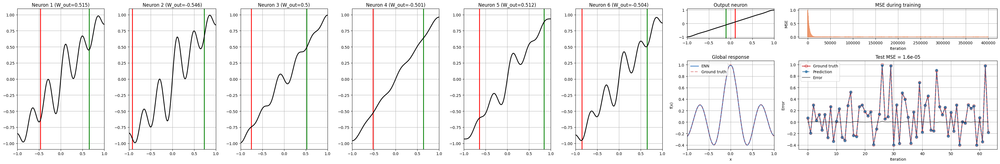

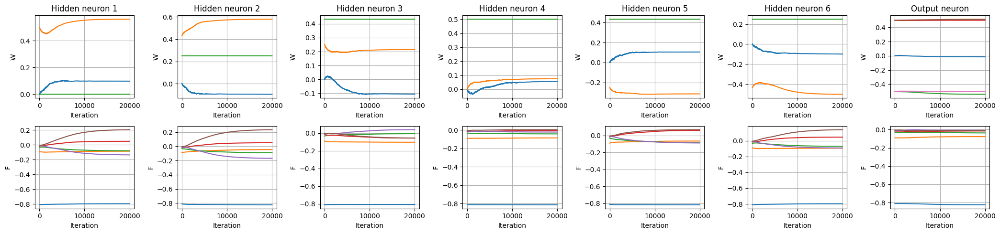

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 26       # Select function
width = 6          # Number of neurons in the hidden layer
n_coeffs =  6      # Number of DCT coefficients per neuron
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, 20000)

As expected, removing one neuron provides no loss in performance. Notice that neurons 4 and 5 have almost the same activation and the weight is now shared between both! This means that we can still remove one neuron with no loss in performance.

<ipython-input-6-e3088c0e150d>:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])
<ipython-input-6-e3088c0e150d>:85: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred[i], error[i], _ = self.forward(x[:,[i]], y[i])


Plotting results...


<ipython-input-8-de44980a06df>:115: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  Z[i,j], _, _ = enn.forward(x_in[..., None], 0)


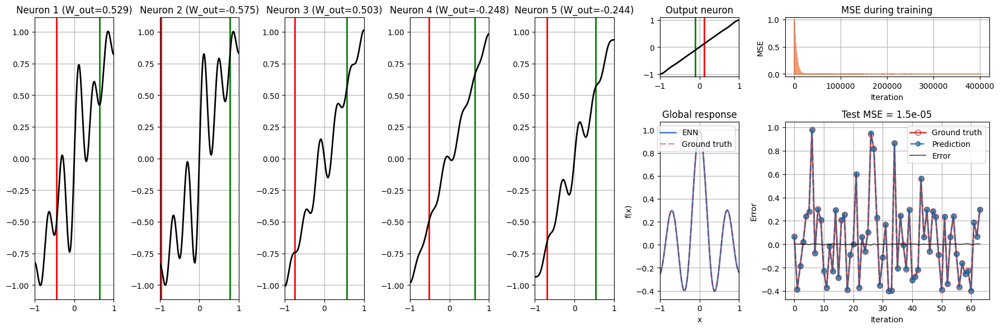

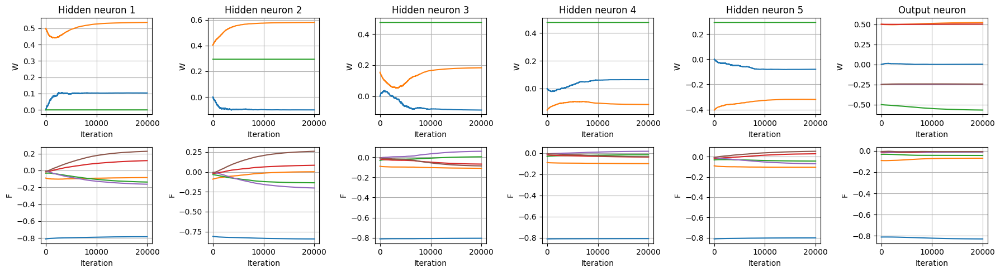

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 26       # Select function
width = 5          # Number of neurons in the hidden layer
n_coeffs =  6      # Number of DCT coefficients per neuron
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, 20000)

As expected, there is no loss in performance. There is another line, which means we can remove an extra neuron.

<ipython-input-6-e3088c0e150d>:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])
<ipython-input-6-e3088c0e150d>:85: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred[i], error[i], _ = self.forward(x[:,[i]], y[i])


Plotting results...


<ipython-input-8-de44980a06df>:115: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  Z[i,j], _, _ = enn.forward(x_in[..., None], 0)


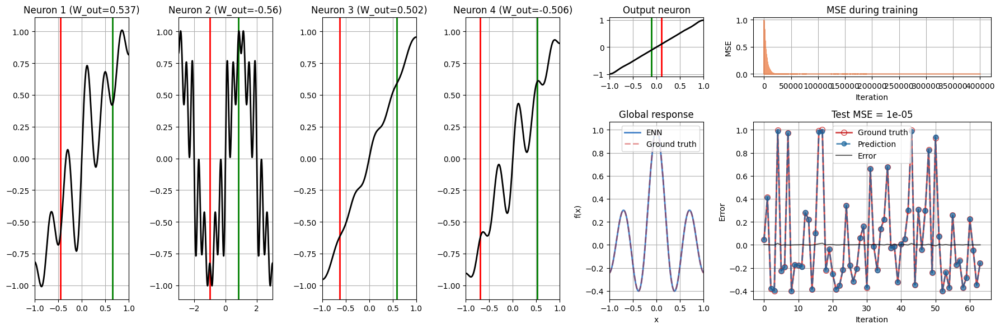

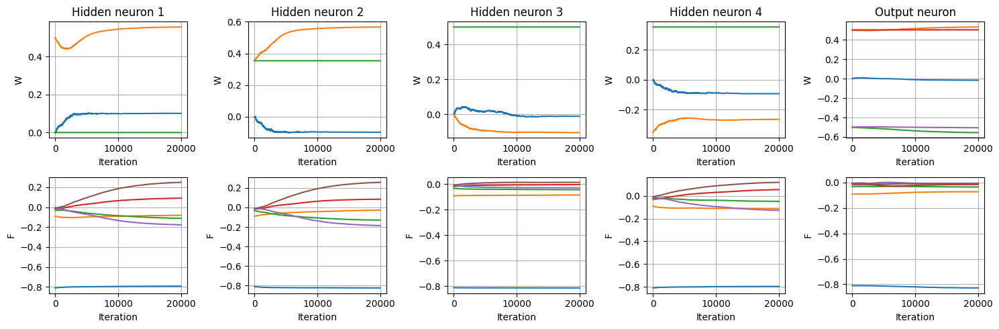

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 26       # Select function
width = 4          # Number of neurons in the hidden layer
n_coeffs =  6      # Number of DCT coefficients per neuron
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, 20000)

Excellent, no loss in performance because the model is interpretable. Other models may be interpretable too, this is, with fixed ReLUs (still to be tested). However, they will require more neurones for sure. The proposed model is very expressive and highly interpretable, both at the same time.

<ipython-input-6-e3088c0e150d>:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])
<ipython-input-6-e3088c0e150d>:85: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred[i], error[i], _ = self.forward(x[:,[i]], y[i])


Plotting results...


<ipython-input-8-de44980a06df>:115: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  Z[i,j], _, _ = enn.forward(x_in[..., None], 0)


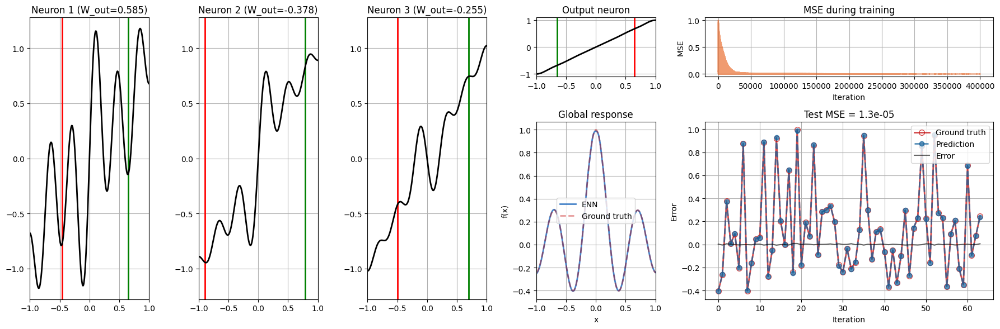

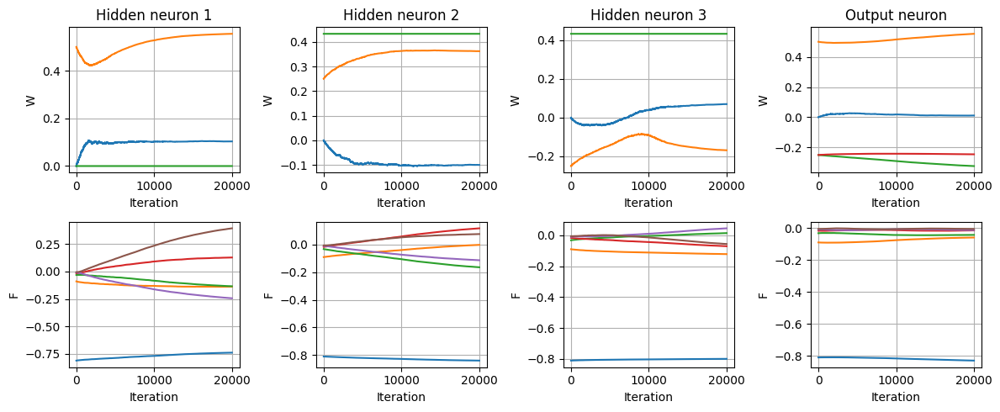

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 26       # Select function
width = 3          # Number of neurons in the hidden layer
n_coeffs =  6      # Number of DCT coefficients per neuron
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, 20000)

Removing an extra neuron degrades the model performance by a factor of 10! This is good because there was no incentive in removing a neuron, the activations were different. That said, the model still works reasonably well with only two neurons.

<ipython-input-6-e3088c0e150d>:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])
<ipython-input-6-e3088c0e150d>:85: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred[i], error[i], _ = self.forward(x[:,[i]], y[i])


Plotting results...


<ipython-input-8-de44980a06df>:115: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  Z[i,j], _, _ = enn.forward(x_in[..., None], 0)


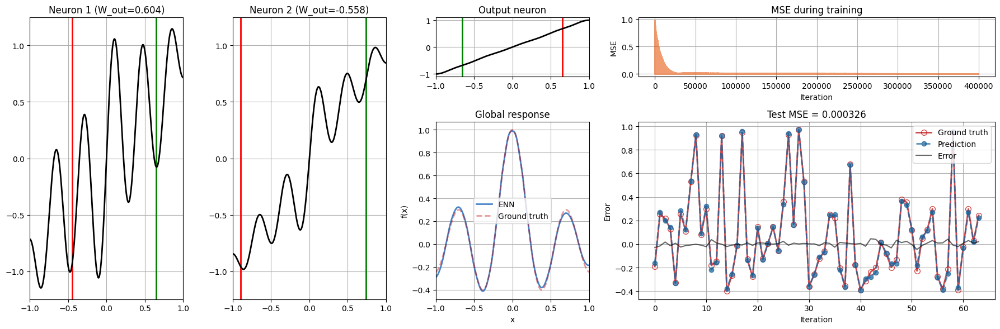

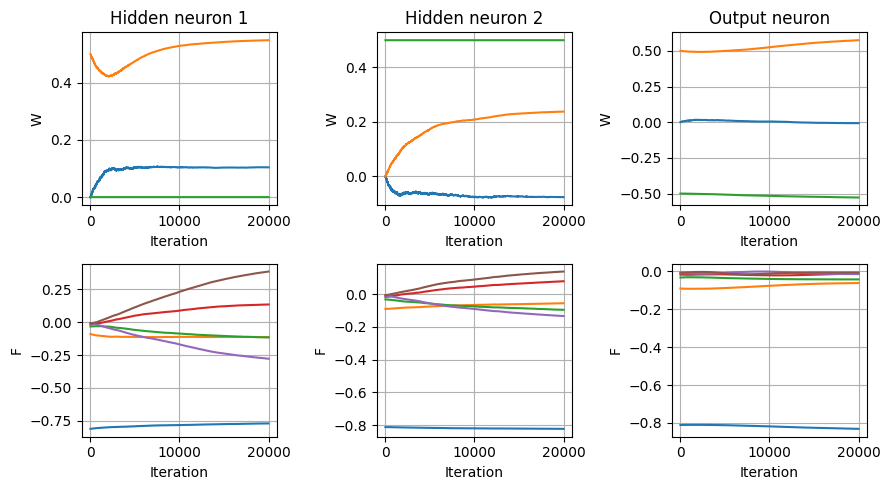

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 26       # Select function
width = 2          # Number of neurons in the hidden layer
n_coeffs =  6      # Number of DCT coefficients per neuron
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, 20000)

In a similar fashion, there is no motivation to drop any coefficient, since the the largest ones have converged to non-zero. Then, of course, dropping one coefficient from all neurons harms the model performance.

<ipython-input-6-e3088c0e150d>:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])
<ipython-input-6-e3088c0e150d>:85: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred[i], error[i], _ = self.forward(x[:,[i]], y[i])


Plotting results...


<ipython-input-8-de44980a06df>:115: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  Z[i,j], _, _ = enn.forward(x_in[..., None], 0)


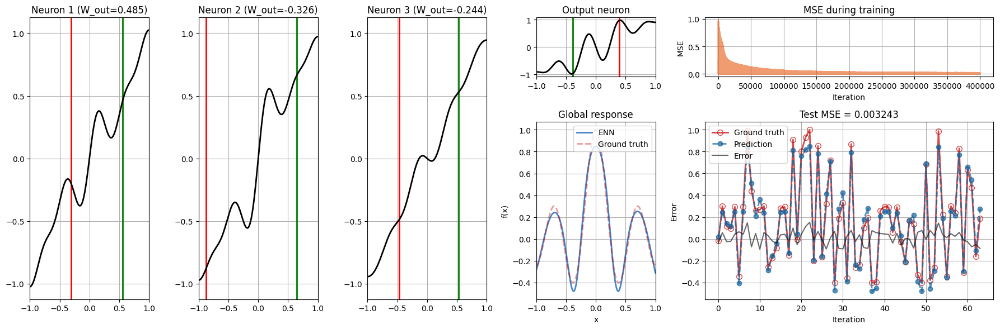

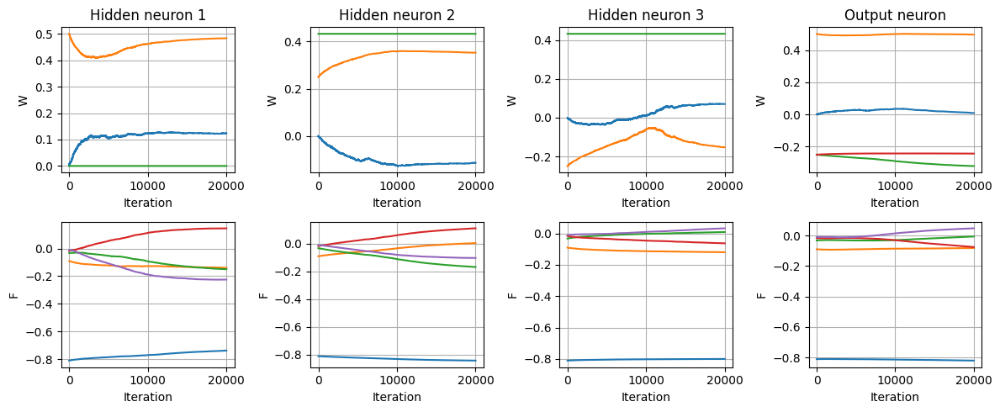

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 26       # Select function
width = 3          # Number of neurons in the hidden layer
n_coeffs =  5      # Number of DCT coefficients per neuron
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, 20000)

Alternatively, we can stick to 6 neurons and remove some coefficients. We see that the model is expressive enough: neuron 4 is a line and neurons 5 and 6 are almost equal with opposite signs in the output linear weight. This results in exactly the previous simulation, which dropped a little in performance.

However, this solution is less interpretable because we don't know until which point we can remove high-order coefficients.

<ipython-input-6-e3088c0e150d>:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])
<ipython-input-6-e3088c0e150d>:85: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred[i], error[i], _ = self.forward(x[:,[i]], y[i])


Plotting results...


<ipython-input-8-de44980a06df>:115: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  Z[i,j], _, _ = enn.forward(x_in[..., None], 0)


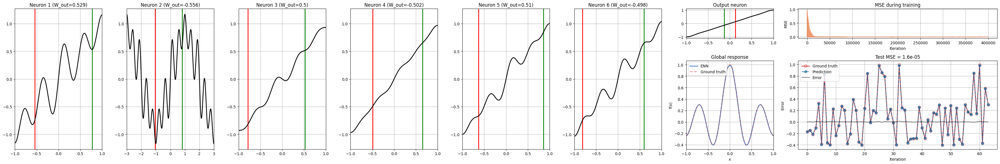

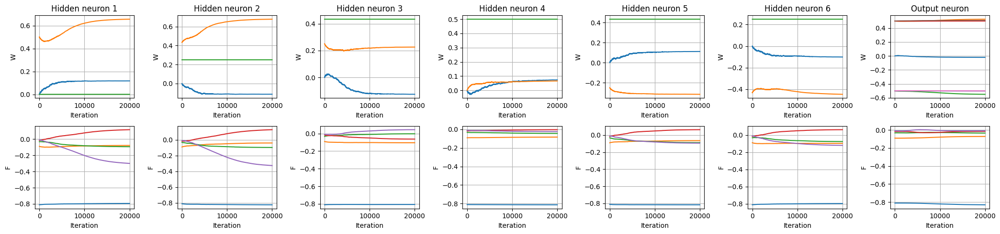

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 26       # Select function
width = 6          # Number of neurons in the hidden layer
n_coeffs =  5      # Number of DCT coefficients per neuron
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, 20000)

#### **MLP (tanh output)**

The model does not adapt very good, since the activations have small expressiveness.

In [ ]:
hidden_dim = 6
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 26
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

------------------------- Model size -------------------------
Number of hidden neurons: 6
Number of parameters: 25
	 fc1.weight True torch.Size([6, 2]) 12
	 fc1.bias True torch.Size([6]) 6
	 fc2.weight True torch.Size([1, 6]) 6
	 fc2.bias True torch.Size([1]) 1

-------------------------- Training --------------------------
Sample 0


KeyboardInterrupt: 

In [ ]:
hidden_dim = 12
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 26
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 30
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 26
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 40
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 26
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 40
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 26
n_train = 800000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 50
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 26
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 60
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 26
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 70
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 26
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 80
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 26
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 90
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 26
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 100
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 26
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

#### **MLP (linear output)**

The model does not adapt very good, since the activations have small expressiveness.

In [ ]:
hidden_dim = 6
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 26
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 12
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 26
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 30
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 26
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 40
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 26
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 40
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 26
n_train = 800000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 50
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 26
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 60
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 26
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 70
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 26
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 80
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 26
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 90
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 26
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 100
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 26
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

### **Example 2: 1D Regression**

#### **ENN**

This example is very good to understand the limitations of the model: at the boundaries of the map there is a high frequency component that is impossible to generate with the cosines of up to 6th order.

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 29       # Select function
width = 6          # Number of neurons in the hidden layer
n_coeffs =  6      # Number of DCT coefficients per neuron
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, 400000)

If we double the number of coefficients, the model performs slightly better (half the MSE). It cannot do much better because the required component needs a very large frequency (almost infinite). However, notice the independence between neurons and coefficients: the model still identifies that neuron 4 is not needed, as all its coefficients are close to zero (or the neuron approaches a line).

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 29       # Select function
width = 6          # Number of neurons in the hidden layer
n_coeffs =  12      # Number of DCT coefficients per neuron
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, 400000)

This is also perceived in the following problem.

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 28       # Select function
width = 6          # Number of neurons in the hidden layer
n_coeffs =  6      # Number of DCT coefficients per neuron
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, 400000)

This is also perceived in this example of a Bernouilli chaotic sequence prediction.

<ipython-input-13-de13a7716724>:58: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])
<ipython-input-13-de13a7716724>:84: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred[i], error[i], _ = self.forward(x[:,[i]], y[i])


Plotting results...


<ipython-input-14-4ef9510504a8>:108: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  Z[i,j], _, _ = enn.forward(x_in[...,None], 0)


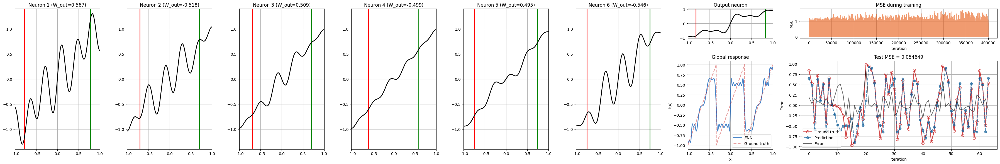

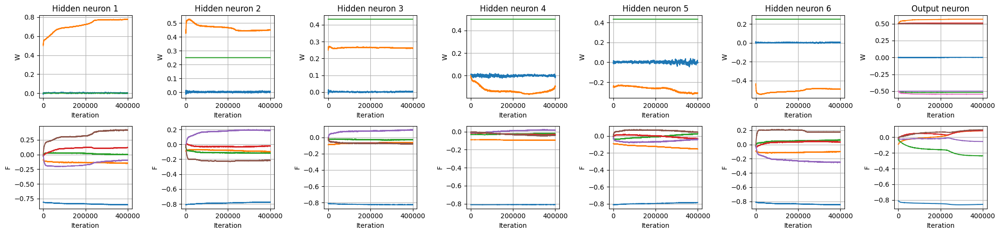

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 24       # Select function
width = 6          # Number of neurons in the hidden layer
n_coeffs =  6      # Number of DCT coefficients per neuron
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, 400000)

#### **MLP**

In [ ]:
hidden_dim = 6
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 29
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 12
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 29
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 20
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 29
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 30
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 29
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 40
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 29
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 50
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 29
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 60
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 29
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 70
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 29
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 80
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 29
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

### **Example 3: 1D Regression**

Bernoulli map it's an example of a function for which the DCT doesn't behave particoulary well. Its rapid changes are not easily learned and we need to retain a high number of coefficients to obtain a low error.

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 24       # Select function
n_train = 40000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999

#### Bernoulli map with the ENN: increasing the number of DCT used

In [ ]:
mse_coefficients = []
coeff_number = [3, 6, 12, 24, 48]

In [ ]:
width = 6          # Number of neurons in the hidden layer
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

# Testing with n_coeff = 3
n_coeffs = 3 # DCT coefficients per neuron
enn = ENN(n_input, width, nft, n_coeffs)
error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

mse_coefficients.append(np.mean(error_test**2))

# Testing with n_coeff = 6
n_coeffs = 6 # DCT coefficients per neuron
enn = ENN(n_input, width, nft, n_coeffs)
error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)
mse_coefficients.append(np.mean(error_test**2))


<ipython-input-6-e3088c0e150d>:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])
<ipython-input-6-e3088c0e150d>:85: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred[i], error[i], _ = self.forward(x[:,[i]], y[i])


Using **12 DCT coefficients** instead of 6, the MSE improves, but by looking a the function approximation, it's clear that the network is still struggling to do an accurate reconstruction.


<ipython-input-6-e3088c0e150d>:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])
<ipython-input-6-e3088c0e150d>:85: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred[i], error[i], _ = self.forward(x[:,[i]], y[i])


Plotting results...


<ipython-input-8-4ef9510504a8>:108: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  Z[i,j], _, _ = enn.forward(x_in[...,None], 0)


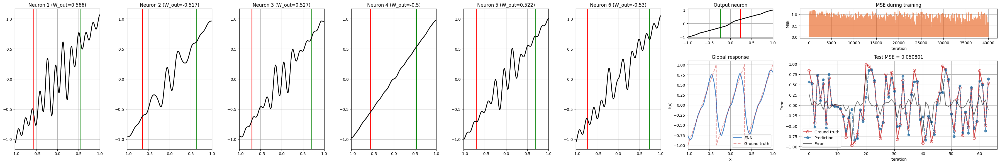

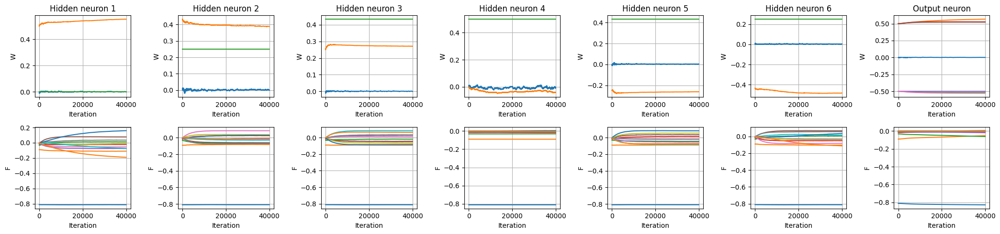

In [ ]:
n_coeffs = 12      # Number of DCT coefficients per neuron
width = 6          # Number of neurons in the hidden layer

lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, n_train)

mse_coefficients.append(np.mean(error_test**2))

If we further increase **DCT coefficients to 24**, the function approximation becomes better and the MSE decreases a bit.

<ipython-input-6-e3088c0e150d>:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])
<ipython-input-6-e3088c0e150d>:85: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred[i], error[i], _ = self.forward(x[:,[i]], y[i])


Plotting results...


<ipython-input-8-4ef9510504a8>:108: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  Z[i,j], _, _ = enn.forward(x_in[...,None], 0)


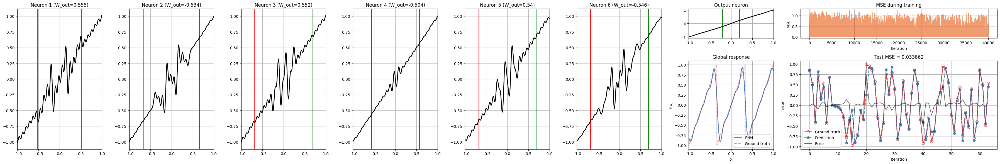

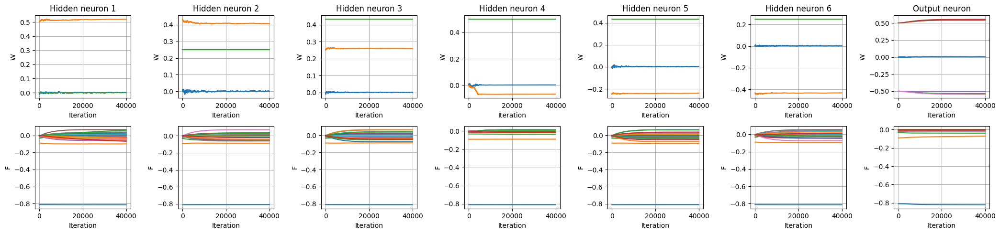

In [ ]:
n_coeffs = 24      # Number of DCT coefficients per neuron
width = 6          # Number of neurons in the hidden layer

lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, n_train)

mse_coefficients.append(np.mean(error_test**2))

Using **48 coefficients**, the approximation is almost perfect. Nevertheless,

<ipython-input-6-e3088c0e150d>:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])
<ipython-input-6-e3088c0e150d>:85: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred[i], error[i], _ = self.forward(x[:,[i]], y[i])


Plotting results...


<ipython-input-8-4ef9510504a8>:108: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  Z[i,j], _, _ = enn.forward(x_in[...,None], 0)


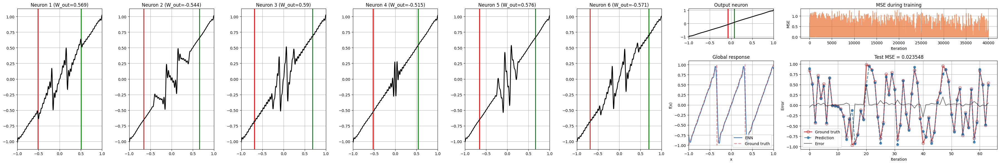

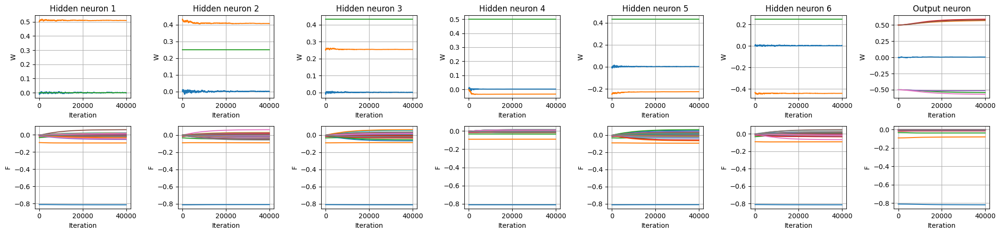

In [ ]:
n_coeffs = 48      # Number of DCT coefficients per neuron
width = 6          # Number of neurons in the hidden layer

lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, n_train)

mse_coefficients.append(np.mean(error_test**2))

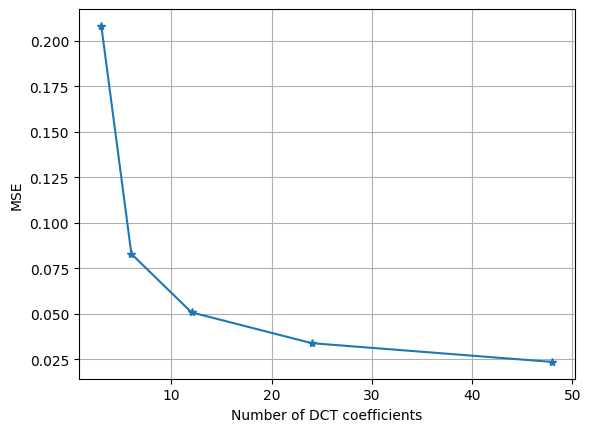

In [ ]:
plt.plot(coeff_number, mse_coefficients, '-*')
plt.xlabel('Number of DCT coefficients')
plt.ylabel('MSE')
plt.grid(True)
plt.show()

Let's see what happens if we increase the number of neurons while keeping the number of coefficient high (48 DCT coefficients):

<ipython-input-13-e3088c0e150d>:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])
<ipython-input-13-e3088c0e150d>:85: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred[i], error[i], _ = self.forward(x[:,[i]], y[i])


Plotting results...


<ipython-input-15-4ef9510504a8>:108: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  Z[i,j], _, _ = enn.forward(x_in[...,None], 0)


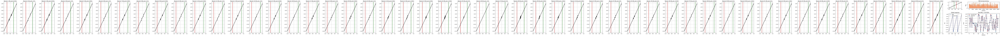

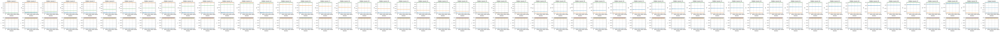

In [ ]:
n_coeffs = 48      # Number of DCT coefficients per neuron
width = 50          # Number of neurons in the hidden layer

lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, n_train)

<ipython-input-4-e3088c0e150d>:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])
<ipython-input-4-e3088c0e150d>:85: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred[i], error[i], _ = self.forward(x[:,[i]], y[i])


Plotting results...


<ipython-input-6-4ef9510504a8>:108: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  Z[i,j], _, _ = enn.forward(x_in[...,None], 0)


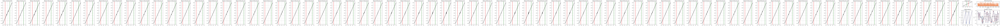

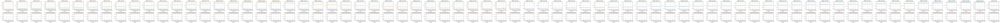

In [ ]:
n_coeffs = 48      # Number of DCT coefficients per neuron
width = 70          # Number of neurons in the hidden layer

lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, n_train)

#### Increasing the number of neurons in the ENN

By contrast, let's see what happens if we fix the number of **DCT coefficients = 12** and we test for **different number of neurons**

In [ ]:
mse_neurons = []
number_of_neurons = [4, 6, 8, 12, 20]

In [ ]:
width = number_of_neurons[0]   #4       # Number of neurons in the hidden layer
n_coeffs = 12      # Number of DCT coefficients per neuron

lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

mse_neurons.append(np.mean(error_test**2))

<ipython-input-6-e3088c0e150d>:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])
<ipython-input-6-e3088c0e150d>:85: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred[i], error[i], _ = self.forward(x[:,[i]], y[i])


<ipython-input-6-e3088c0e150d>:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])
<ipython-input-6-e3088c0e150d>:85: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred[i], error[i], _ = self.forward(x[:,[i]], y[i])


Plotting results...


<ipython-input-8-4ef9510504a8>:108: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  Z[i,j], _, _ = enn.forward(x_in[...,None], 0)


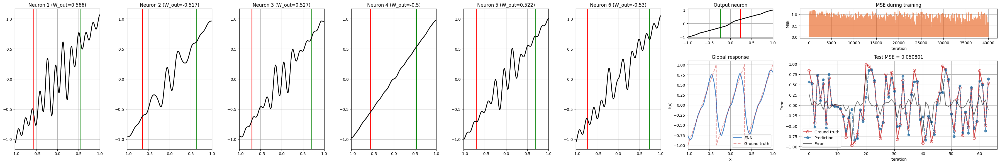

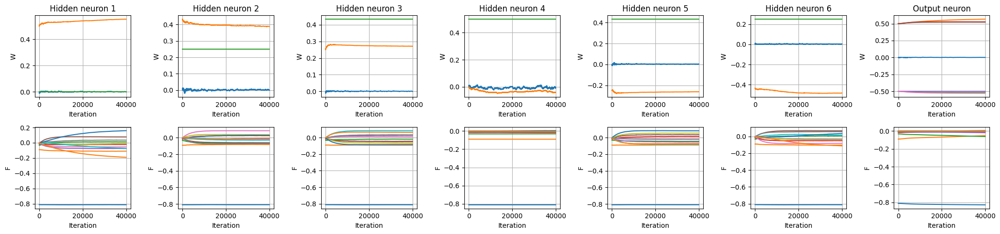

In [ ]:
width = number_of_neurons[1]   #6       # Number of neurons in the hidden layer
n_coeffs = 12      # Number of DCT coefficients per neuron

lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, n_train)

mse_neurons.append(np.mean(error_test**2))

In [ ]:
width = number_of_neurons[2]   #8       # Number of neurons in the hidden layer
n_coeffs = 12      # Number of DCT coefficients per neuron

lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

mse_neurons.append(np.mean(error_test**2))

<ipython-input-6-e3088c0e150d>:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])
<ipython-input-6-e3088c0e150d>:85: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred[i], error[i], _ = self.forward(x[:,[i]], y[i])


<ipython-input-6-e3088c0e150d>:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])
<ipython-input-6-e3088c0e150d>:85: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred[i], error[i], _ = self.forward(x[:,[i]], y[i])


Plotting results...


<ipython-input-8-4ef9510504a8>:108: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  Z[i,j], _, _ = enn.forward(x_in[...,None], 0)


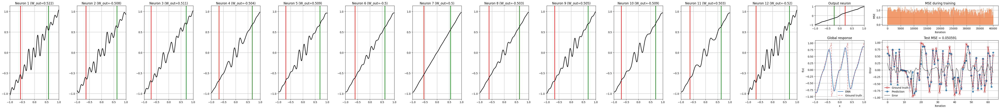

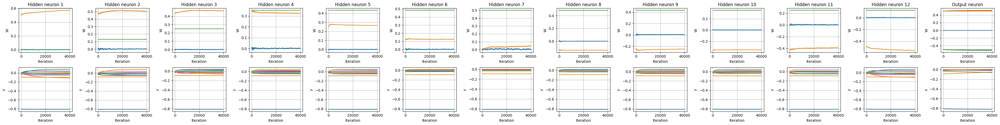

In [ ]:
width = number_of_neurons[3]   #12       # Number of neurons in the hidden layer
n_coeffs = 12      # Number of DCT coefficients per neuron

lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, n_train)

mse_neurons.append(np.mean(error_test**2))

<ipython-input-6-e3088c0e150d>:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])
<ipython-input-6-e3088c0e150d>:85: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred[i], error[i], _ = self.forward(x[:,[i]], y[i])


Plotting results...


<ipython-input-8-4ef9510504a8>:108: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  Z[i,j], _, _ = enn.forward(x_in[...,None], 0)


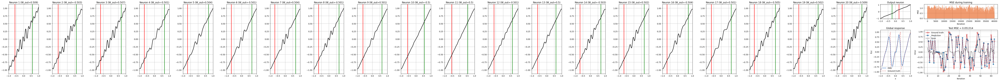

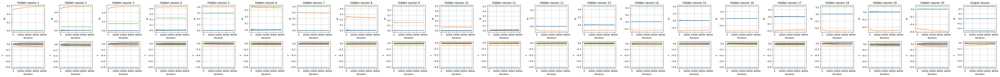

In [ ]:
width = number_of_neurons[4]   #20       # Number of neurons in the hidden layer
n_coeffs = 12      # Number of DCT coefficients per neuron

lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, n_train)

mse_neurons.append(np.mean(error_test**2))

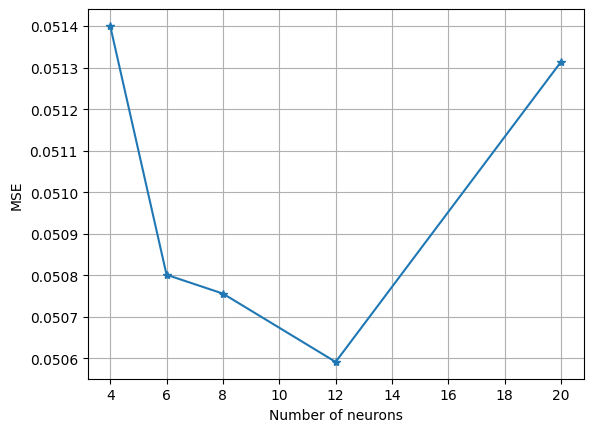

In [ ]:
plt.plot(number_of_neurons, mse_neurons, '-*')
plt.xlabel('Number of neurons')
plt.ylabel('MSE')
plt.grid(True)
plt.show()

### **Example 4: 1D Regression**

<ipython-input-6-e3088c0e150d>:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])
<ipython-input-6-e3088c0e150d>:85: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred[i], error[i], _ = self.forward(x[:,[i]], y[i])


Plotting results...


<ipython-input-19-de44980a06df>:115: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  Z[i,j], _, _ = enn.forward(x_in[..., None], 0)


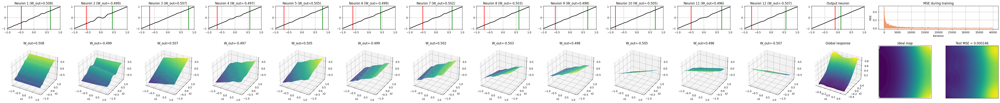

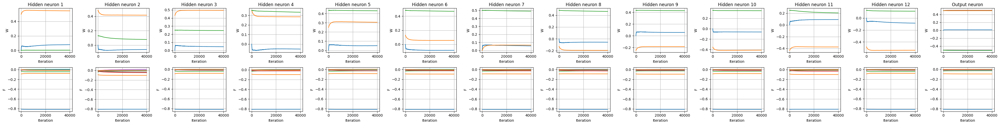

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 16       # Select function
width = 12          # Number of neurons in the hidden layer
n_coeffs =  12      # Number of DCT coefficients per neuron
n_train = 40000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, n_train)

### **Example 4: 2D Regression**

We notice that most of the parameters are zero and that most of the activations represent lines. This time we will remove half of the coefficients.

#### **ENN**

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 18       # Select function
width = 6          # Number of neurons in the hidden layer
n_coeffs =  6      # Number of DCT coefficients per neuron
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, 400000)

The accuracy drops because we also removed coefficients from the output layer, which were different from zero. Nonetheless, the performance is still reasonably good. Since most of the activations represent lines, we will remove half of them.

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 18       # Select function
width = 6          # Number of neurons in the hidden layer
n_coeffs =  3      # Number of DCT coefficients per neuron
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, 400000)

This does not work as expected, this is, lines are no longer preserved because there are as many directions of diversity as neurons. Thus, to create a shape with circular geometry, the activations need to create nonlinearities at minimum in the X and Y axis. Therefore, unlike in one-dimensional problems, two dimensions benefit from neuron diversity.

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 18       # Select function
width = 2          # Number of neurons in the hidden layer
n_coeffs =  3      # Number of DCT coefficients per neuron
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, 400000)

#### **MLP**

In [ ]:
hidden_dim = 6
num_epochs = 1
learning_rate = 0.001
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 18
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 12
num_epochs = 1
learning_rate = 0.001
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 18
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 20
num_epochs = 1
learning_rate = 0.001
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 18
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 30
num_epochs = 1
learning_rate = 0.001
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 18
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 40
num_epochs = 1
learning_rate = 0.001
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 18
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 50
num_epochs = 1
learning_rate = 0.001
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 18
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 60
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 18
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 70
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 18
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 80
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 18
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 90
num_epochs = 1
learning_rate = 0.01
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 18
n_train = 400000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

### **Example 5: 2D Classification**


#### **ENN**

There are no big conclusions when going from 6 to 4 neurons. Some neurons are exactly preserved (e.g., neuron 1 in both models generate the same AAF and bump). However, the solution is not unique and they converge at different minimums.

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 10       # Select function
width = 6          # Number of neurons in the hidden layer
n_coeffs =  6      # Number of DCT coefficients per neuron
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, 400000)

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 10       # Select function
width = 4          # Number of neurons in the hidden layer
n_coeffs =  6      # Number of DCT coefficients per neuron
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, n_train)

### **Example 6: 2D Classification**

#### **ENN**

This is very good to understand the orientation of the bumps. In the end, all neurons generate the same activation (3 first coefficients are the same). Notice that they converge to two peaks per bump when the output linear coefficient is positive, and to a three peaks per bump when the output coefficient is negative. The latter is because three peaks involve two valleys, which turn into to peaks by the negative coefficient. Then, the linear weights just try to orientate the bump in as many different directions as possible, since the output map is invariant to rotations.

Important to notice that the oscillatory nature of the AAF is very expressive here: a single bump can generate multiple (e.g., two) peaks in a given direction. This is not possible with a ReLU.

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 5       # Select function
width = 6          # Number of neurons in the hidden layer
n_coeffs =  6      # Number of DCT coefficients per neuron
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, n_train)

Thus, by reducing the number of coefficients, we see that the first three converge to the same value! And the forth coefficient converges to zero. Another benefit of this model is this: since the basis functions are orthogonal, the coefficients are independent. In this case, the 4th coefficient can be removed, only 3 are sufficient.

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 5       # Select function
width = 6          # Number of neurons in the hidden layer
n_coeffs =  4      # Number of DCT coefficients per neuron
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, n_train)

After removing one coefficient, the convergence is not guaranteed to be at the same point, since the data is fed in a different order. However, there is no drop in accuracy! This experimentally proves our previous statement.

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 5       # Select function
width = 6          # Number of neurons in the hidden layer
n_coeffs =  3      # Number of DCT coefficients per neuron
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, n_train)

Increasing the number of neurons converges to the same activation but with many more directions! This increases the accuracy, as it can approach a circle better.

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 5       # Select function
width = 8          # Number of neurons in the hidden layer
n_coeffs =  6      # Number of DCT coefficients per neuron
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, n_train)

As expected, with two neurons we only have two directions. Then, we can approximate a square at most.

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 5       # Select function
width = 2          # Number of neurons in the hidden layer
n_coeffs =  6      # Number of DCT coefficients per neuron
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, n_train)

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 5       # Select function
width = 4          # Number of neurons in the hidden layer
n_coeffs =  6      # Number of DCT coefficients per neuron
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, n_train)

#### **MLP**

In [ ]:
!pip install torcheval
from torcheval.metrics.functional import binary_f1_score

In [ ]:
hidden_dim = 6
num_epochs = 1
learning_rate = 0.001
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 5
n_train = 100000
n_test = 100000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n-------------------------- Testing ---------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
        print(f'Accuracy: {test_metric:.2f}')
        preds[preds==-1]=0
        test_dataset.targets[test_dataset.targets==-1]=0
        f1_score = binary_f1_score(preds, test_dataset.targets[:,0], threshold=0.5)
        print(f'F1-score: {100*f1_score.item():.2f} \n')
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test
        print('MSE: ', test_metric, '\n')



plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 12
num_epochs = 1
learning_rate = 0.001
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 5
n_train = 800000
n_test = 50000
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n---------------------------- Testing ----------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test


plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

We are going to train the MLP 50 times and average the results. We want to know the average performance, as well as the average actual model size.

In [ ]:
hidden_dim = 6
num_models = 10
num_epochs = 1
learning_rate = 0.001
hidden_act = []
test_accuracy = []
test_f1 = []

function = 5
n_train = 100000
n_test = 50000
# train_dataset = CustomDataset(n_train, function)
# test_dataset = CustomDataset(n_test, function)
# train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
# test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
#train_loss = torch.zeros(n_train)
#W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
#W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
# for name, p in mlp.named_parameters():
#     print('\t',name, p.requires_grad, p.shape, p.numel())


for iter in range(num_models):
    train_dataset = CustomDataset(n_train, function)
    test_dataset = CustomDataset(n_test, function)
    train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
    test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)
    mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)

    print('\n-------------------------- Training --------------------------')
    for epoch in range(num_epochs):
        ground_truth = torch.zeros(len(train_dataset))
        predictions = torch.zeros(len(train_dataset))
        n_correct = 0
        n_samples = 0

        for i, (input, labels) in enumerate(train_loader):
            print('Sample', i) if i % 100000 == 0 else 0
            outputs = mlp(input)
            loss = criterion(outputs, labels)
            #train_loss[i] = loss.item()

            loss.backward()
            optimizer.step()
            optimizer.zero_grad()
            #W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
            #W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
            #W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
            #W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


    print('\n-------------------------- Testing ---------------------------')
    preds = torch.zeros(len(test_dataset))
    with torch.no_grad():
        if test_dataset.category=="classification":
            n_correct = 0
            for i, (input, labels) in enumerate(test_loader):
                outputs = mlp(input)
                preds[i] = torch.sign(outputs)
                n_correct += (preds[i] == labels).sum().item()
            test_metric = 100 * n_correct / n_test
            print(f'Accuracy: {test_metric:.2f}')
            preds[preds==-1]=0
            test_dataset.targets[test_dataset.targets==-1]=0
            f1_score = 100*binary_f1_score(preds, test_dataset.targets[:,0], threshold=0.5).item()
            print(f'F1-score: {f1_score:.2f} \n')
        else:
            test_metric = 0
            for i, (input, labels) in enumerate(test_loader):
                preds[i] = mlp(input)
                test_metric += criterion(preds[i], labels.squeeze()).item()
            test_metric = test_metric/n_test
            print('MSE: ', test_metric, '\n')

    dead = actual_size(mlp)
    hidden_act.append(hidden_dim-dead)
    test_accuracy.append(test_metric)
    test_f1.append(f1_score)
    print('Number of active hidden neurons:', hidden_dim-dead)
    #print('Number of actual parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad)-died*3-died,'\n')

print(hidden_act)
print(test_accuracy)
print(test_f1)
#plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
#plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

In [ ]:
hidden_dim = 12
num_models = 10
num_epochs = 1
learning_rate = 0.001
hidden_act = []
test_accuracy = []
test_f1 = []

function = 5
n_train = 800000
n_test = 50000
# train_dataset = CustomDataset(n_train, function)
# test_dataset = CustomDataset(n_test, function)
# train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
# test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
#train_loss = torch.zeros(n_train)
#W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
#W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
# for name, p in mlp.named_parameters():
#     print('\t',name, p.requires_grad, p.shape, p.numel())


for iter in range(num_models):
    train_dataset = CustomDataset(n_train, function)
    test_dataset = CustomDataset(n_test, function)
    train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
    test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)
    mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)

    print('\n-------------------------- Training --------------------------')
    for epoch in range(num_epochs):
        ground_truth = torch.zeros(len(train_dataset))
        predictions = torch.zeros(len(train_dataset))
        n_correct = 0
        n_samples = 0

        for i, (input, labels) in enumerate(train_loader):
            print('Sample', i) if i % 100000 == 0 else 0
            outputs = mlp(input)
            loss = criterion(outputs, labels)
            #train_loss[i] = loss.item()

            loss.backward()
            optimizer.step()
            optimizer.zero_grad()
            #W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
            #W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
            #W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
            #W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


    print('\n-------------------------- Testing ---------------------------')
    preds = torch.zeros(len(test_dataset))
    with torch.no_grad():
        if test_dataset.category=="classification":
            n_correct = 0
            for i, (input, labels) in enumerate(test_loader):
                outputs = mlp(input)
                preds[i] = torch.sign(outputs)
                n_correct += (preds[i] == labels).sum().item()
            test_metric = 100 * n_correct / n_test
            print(f'Accuracy: {test_metric:.2f}')
            preds[preds==-1]=0
            test_dataset.targets[test_dataset.targets==-1]=0
            f1_score = 100*binary_f1_score(preds, test_dataset.targets[:,0], threshold=0.5).item()
            print(f'F1-score: {f1_score:.2f} \n')
        else:
            test_metric = 0
            for i, (input, labels) in enumerate(test_loader):
                preds[i] = mlp(input)
                test_metric += criterion(preds[i], labels.squeeze()).item()
            test_metric = test_metric/n_test
            print('MSE: ', test_metric, '\n')

    dead = actual_size(mlp)
    hidden_act.append(hidden_dim-dead)
    test_accuracy.append(test_metric)
    test_f1.append(f1_score)
    print('Number of active hidden neurons:', hidden_dim-dead)
    #print('Number of actual parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad)-died*3-died,'\n')

print(hidden_act)
print(test_accuracy)
print(test_f1)
#plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
#plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

### **Example 7: 2D Classification (CHIRP function)**
$f(x, y) = $sin($2\pi \cdot f_0 \cdot x \cdot e^{k\cdot x}$)

#### CHIRP funtion with low exponential growth
Initial frequency $f_0 = \frac{3}{2}$ and growth factor $k=\frac{1}{2}$

##### ENN vs MLP with 3 coefficients per neuron and 6 neurons

<ipython-input-6-e3088c0e150d>:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])
<ipython-input-6-e3088c0e150d>:85: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred[i], error[i], _ = self.forward(x[:,[i]], y[i])


Plotting results...


<ipython-input-8-de44980a06df>:115: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  Z[i,j], _, _ = enn.forward(x_in[..., None], 0)
/usr/local/lib/python3.10/dist-packages/matplotlib/collections.py:996: RuntimeWarning: invalid value encountered in sqrt
  scale = np.sqrt(self._sizes) * dpi / 72.0 * self._factor


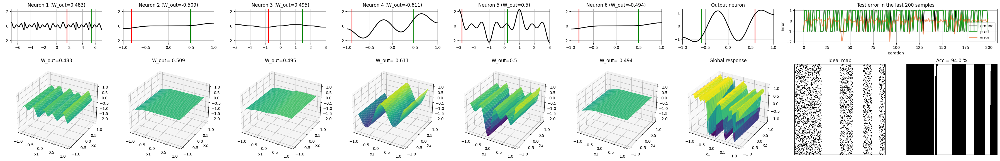

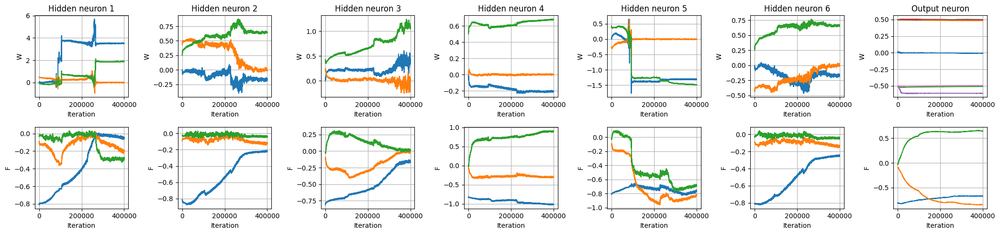

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 30       # Select function
width = 6          # Number of neurons in the hidden layer
n_coeffs =  3      # Number of DCT coefficients per neuron
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 5000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, n_train)

------------------------- Model size -------------------------
Number of hidden neurons: 6
Number of parameters: 25
	 fc1.weight True torch.Size([6, 2]) 12
	 fc1.bias True torch.Size([6]) 6
	 fc2.weight True torch.Size([1, 6]) 6
	 fc2.bias True torch.Size([1]) 1

-------------------------- Training --------------------------
Sample 0
Sample 100000
Sample 200000
Sample 300000

-------------------------- Testing ---------------------------
Accuracy: 71.14
F1-score: 75.66 

--------------------- Actual model size ----------------------
Number of active hidden neurons: 5
Number of actual parameters: 21 



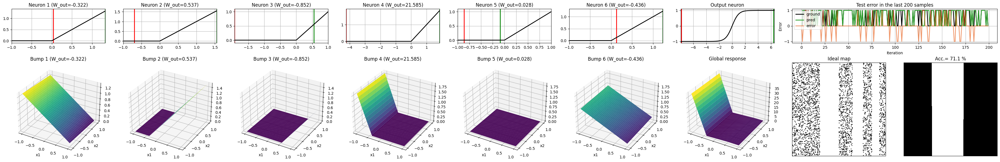

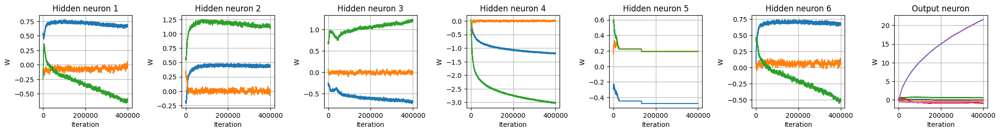

In [ ]:
hidden_dim = 6
num_epochs = 1
learning_rate = 0.001
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 30
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 5000     # Number of test samples
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n-------------------------- Testing ---------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
        print(f'Accuracy: {test_metric:.2f}')
        preds[preds==-1]=0
        test_dataset.targets[test_dataset.targets==-1]=0
        f1_score = binary_f1_score(preds, test_dataset.targets[:,0], threshold=0.5)
        print(f'F1-score: {100*f1_score.item():.2f} \n')
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test
        print('MSE: ', test_metric, '\n')



plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

##### ENN vs MLP with 3 coefficients per neuron and 4 neurons

<ipython-input-6-e3088c0e150d>:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])
<ipython-input-6-e3088c0e150d>:85: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred[i], error[i], _ = self.forward(x[:,[i]], y[i])


Plotting results...


<ipython-input-8-de44980a06df>:115: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  Z[i,j], _, _ = enn.forward(x_in[..., None], 0)


Error in callback <function _draw_all_if_interactive at 0x7dbcf02424d0> (for post_execute):


KeyboardInterrupt: 

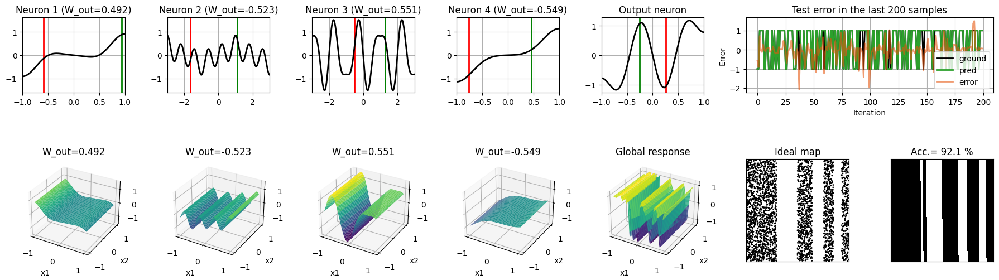

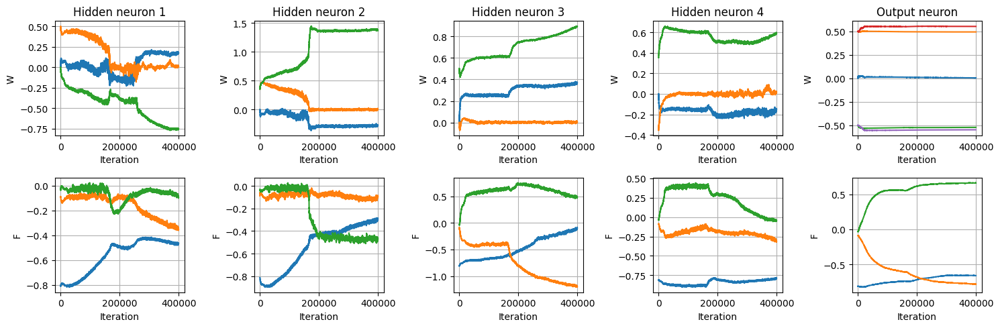

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 30       # Select function
width = 4          # Number of neurons in the hidden layer
n_coeffs =  3      # Number of DCT coefficients per neuron
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 5000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, n_train)

In [ ]:
hidden_dim = 4
num_epochs = 1
learning_rate = 0.001
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 30
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 5000     # Number of test samples
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n-------------------------- Testing ---------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
        print(f'Accuracy: {test_metric:.2f}')
        preds[preds==-1]=0
        test_dataset.targets[test_dataset.targets==-1]=0
        f1_score = binary_f1_score(preds, test_dataset.targets[:,0], threshold=0.5)
        print(f'F1-score: {100*f1_score.item():.2f} \n')
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test
        print('MSE: ', test_metric, '\n')



plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

------------------------- Model size -------------------------
Number of hidden neurons: 4
Number of parameters: 17
	 fc1.weight True torch.Size([4, 2]) 8
	 fc1.bias True torch.Size([4]) 4
	 fc2.weight True torch.Size([1, 4]) 4
	 fc2.bias True torch.Size([1]) 1

-------------------------- Training --------------------------
Sample 0


KeyboardInterrupt: 

#### CHIRP funtion with medium exponential growth
Initial frequency $f_0 = \frac{3}{2}$ and growth factor $k=1$

##### ENN vs MLP 3 coefficients and 4 neurons

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 31       # Select function
width = 4          # Number of neurons in the hidden layer
n_coeffs =  3      # Number of DCT coefficients per neuron
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 5000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, n_train)

In [ ]:
hidden_dim = 4
num_epochs = 1
learning_rate = 0.001
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 31
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 5000     # Number of test samples
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n-------------------------- Testing ---------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
        print(f'Accuracy: {test_metric:.2f}')
        preds[preds==-1]=0
        test_dataset.targets[test_dataset.targets==-1]=0
        f1_score = binary_f1_score(preds, test_dataset.targets[:,0], threshold=0.5)
        print(f'F1-score: {100*f1_score.item():.2f} \n')
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test
        print('MSE: ', test_metric, '\n')



plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

##### ENN vs MLP 3 coefficients and 6 neurons

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 31       # Select function
width = 6          # Number of neurons in the hidden layer
n_coeffs =  3      # Number of DCT coefficients per neuron
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 5000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, n_train)

In [ ]:
hidden_dim = 6
num_epochs = 1
learning_rate = 0.001
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 31
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 5000     # Number of test samples
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n-------------------------- Testing ---------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
        print(f'Accuracy: {test_metric:.2f}')
        preds[preds==-1]=0
        test_dataset.targets[test_dataset.targets==-1]=0
        f1_score = binary_f1_score(preds, test_dataset.targets[:,0], threshold=0.5)
        print(f'F1-score: {100*f1_score.item():.2f} \n')
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test
        print('MSE: ', test_metric, '\n')



plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

#### CHIRP funtion with large exponential growth
Initial frequency $f_0 = \frac{3}{2}$ and growth factor $k=\frac{3}{2}$


##### ENN vs MLP 3 coefficients and 6 neurons

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 32       # Select function
width = 6          # Number of neurons in the hidden layer
n_coeffs =  6      # Number of DCT coefficients per neuron
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 5000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45)
data_test = Dataset(n_test, function, x0=0.65)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, n_train)

In [ ]:
hidden_dim = 6
num_epochs = 1
learning_rate = 0.001
train_loss = torch.zeros(num_epochs)
train_accuracy = []

function = 32
n_train = 400000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 5000     # Number of test samples
train_dataset = CustomDataset(n_train, function)
test_dataset = CustomDataset(n_test, function)
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

mlp = MLP(input_dim=2, hidden_dim=hidden_dim, output_dim=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mlp.parameters(), lr=learning_rate)
train_loss = torch.zeros(n_train)
W_hid_hist = np.zeros((hidden_dim,3,n_train)) #including biases
W_out_hist = np.zeros((hidden_dim+1,n_train)) #including biases

print('------------------------- Model size -------------------------')
print('Number of hidden neurons:', hidden_dim)
print('Number of parameters:', sum(p.numel() for p in mlp.parameters() if p.requires_grad))
for name, p in mlp.named_parameters():
    print('\t',name, p.requires_grad, p.shape, p.numel())


print('\n-------------------------- Training --------------------------')
for epoch in range(num_epochs):
    ground_truth = torch.zeros(len(train_dataset))
    predictions = torch.zeros(len(train_dataset))
    n_correct = 0
    n_samples = 0

    for i, (input, labels) in enumerate(train_loader):
        print('Sample', i) if i % 100000 == 0 else 0
        outputs = mlp(input)
        loss = criterion(outputs, labels)
        train_loss[i] = loss.item()

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        W_hid_hist[:,0,i] = mlp.fc1.bias.data.cpu().numpy()
        W_hid_hist[:,1:,i] = mlp.fc1.weight.data.cpu().numpy()
        W_out_hist[0,i] = mlp.fc2.bias.data.cpu().item()
        W_out_hist[1:,i]= mlp.fc2.weight.data.cpu().numpy()


print('\n-------------------------- Testing ---------------------------')
preds = torch.zeros(len(test_dataset))
with torch.no_grad():
    if test_dataset.category=="classification":
        n_correct = 0
        for i, (input, labels) in enumerate(test_loader):
            outputs = mlp(input)
            preds[i] = torch.sign(outputs)
            n_correct += (preds[i] == labels).sum().item()
        test_metric = 100 * n_correct / n_test
        print(f'Accuracy: {test_metric:.2f}')
        preds[preds==-1]=0
        test_dataset.targets[test_dataset.targets==-1]=0
        f1_score = binary_f1_score(preds, test_dataset.targets[:,0], threshold=0.5)
        print(f'F1-score: {100*f1_score.item():.2f} \n')
    else:
        test_metric = 0
        for i, (input, labels) in enumerate(test_loader):
            preds[i] = mlp(input)
            test_metric += criterion(preds[i], labels.squeeze()).item()
        test_metric = test_metric/n_test
        print('MSE: ', test_metric, '\n')



plot_results_mlp(mlp, hidden_dim, test_dataset, preds.cpu().numpy(), train_loss, test_metric, test_metric)
plot_params_hist_mlp(W_hid_hist, W_out_hist, n_train)

### **Example 8: 2D Image Representation**


#### DCT vs SVD

In [ ]:
from scipy.fftpack import dctn, idctn
dct_coeffs = dctn(mnist_image, type = 2, norm = 'ortho')
dct_coeffs[:,8:] = 0
dct_coeffs[8:, :] = 0
recostructed = idctn(dct_coeffs, type= 2, norm = 'ortho')
plt.imshow(recostructed, cmap='gray')
plt.title('DCT reconstructed image')

In [ ]:
dct_coeffs

In [ ]:
U, S, Vt = np.linalg.svd(mnist_image, full_matrices=True)
S.shape

#### Predicting downsampled images

<ipython-input-4-e3088c0e150d>:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])
<ipython-input-4-e3088c0e150d>:85: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred[i], error[i], _ = self.forward(x[:,[i]], y[i])


Plotting results...


<ipython-input-6-1f1db376cbc7>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  Z[i,j], _, _ = enn.forward(x_in[..., None], 0)
<ipython-input-6-1f1db376cbc7>:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  Z[i,j], _, _ = enn.forward(x_in[..., None], 0)


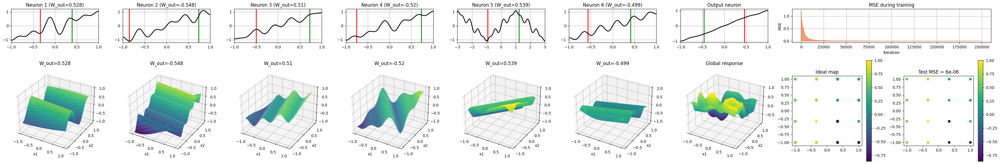

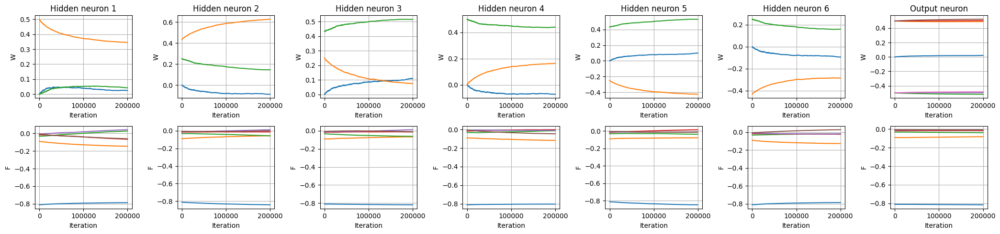

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 33       # Select function
width = 6          # Number of neurons in the hidden layer
n_coeffs =  6      # Number of DCT coefficients per neuron
n_train = 200000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45, imgscale = 0.008)
data_test = Dataset(n_test, function, x0=0.65, imgscale = 0.008)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, n_train)

<ipython-input-4-e3088c0e150d>:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])
<ipython-input-4-e3088c0e150d>:85: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred[i], error[i], _ = self.forward(x[:,[i]], y[i])


Plotting results...


<ipython-input-6-1f1db376cbc7>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  Z[i,j], _, _ = enn.forward(x_in[..., None], 0)
<ipython-input-6-1f1db376cbc7>:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  Z[i,j], _, _ = enn.forward(x_in[..., None], 0)


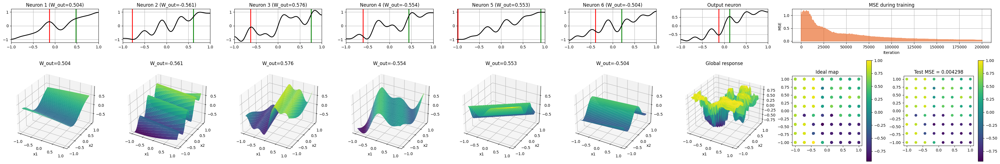

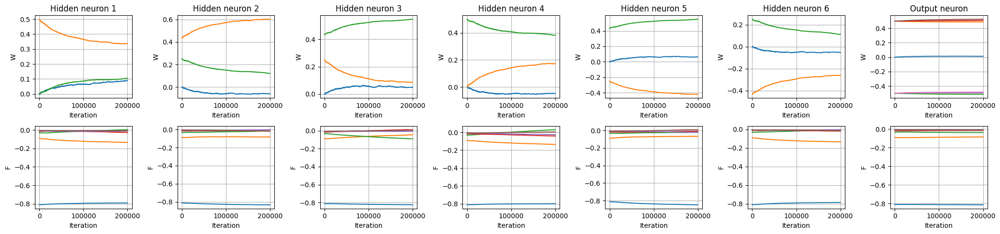

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 33       # Select function
width = 6          # Number of neurons in the hidden layer
n_coeffs =  6      # Number of DCT coefficients per neuron
n_train = 200000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

data_train = Dataset(n_train, function, x0=0.45, imgscale = 0.016)
data_test = Dataset(n_test, function, x0=0.65, imgscale = 0.016)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, n_train)

<ipython-input-15-e3088c0e150d>:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])
<ipython-input-15-e3088c0e150d>:85: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred[i], error[i], _ = self.forward(x[:,[i]], y[i])


Plotting results...


<ipython-input-26-7e0ec5d03b42>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  Z[i,j], _, _ = enn.forward(x_in[..., None], 0)
<ipython-input-26-7e0ec5d03b42>:156: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  Z[i,j], _, _ = enn.forward(x_in[..., None], 0)


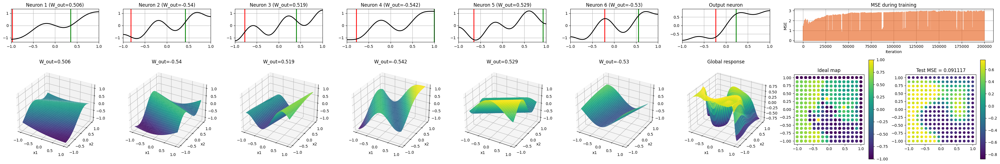

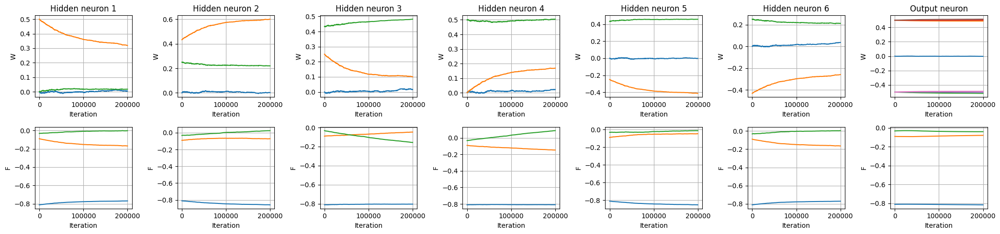

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 33       # Select function
width = 6          # Number of neurons in the hidden layer
n_coeffs =  3      # Number of DCT coefficients per neuron
n_train = 200000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)
## 16x16 image
data_train = Dataset(n_train, function, x0=0.45, imgscale = 0.032)
data_test = Dataset(n_test, function, x0=0.65, imgscale = 0.032)

enn = ENN(n_input, width, nft, n_coeffs)

error_train = enn.train(data_train, lms)
y_pred, error_test, metric = enn.test(data_test)

plot_results(enn, data_train, data_test, y_pred, error_train, error_test, metric)
plot_params_hist(enn, n_train)

#### Predicting 32x32 images block by block: MNIST

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 34       # Select function
width = 6          # Number of neurons in the hidden layer
n_coeffs =  6      # Number of DCT coefficients per neuron
n_train = 200000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)
mse_per_block = []

mnist_image = np.array(mnist_image)
image = preprocess_img(np.array(mnist_image))
img_height, img_width = image.shape
block_size = 8
image_blocks = []
predicted_image_blocks = []
error_train = []

for i in range(0, img_height, block_size):
  print(f'Processing block {i/8 +1}')
  for j in range(0, img_width, block_size):
    # Extract the current block
    block = image[i:i + block_size, j:j + block_size]
    image_blocks.append(block)

    data_train = Dataset(n_train, function, x0=0.45, input_image = block)#8x8 image
    data_test = Dataset(n_test, function, x0=0.65, input_image = block)

    enn = ENN(n_input, width, nft, n_coeffs)

    error_train.append(enn.train(data_train, lms))
    x = np.array(list(set(data_test.x[0,:])))
    x.sort()
    y = np.array(list(set(data_test.x[1,:])))
    y.sort()
    predicted_block = np.zeros((block_size,block_size))

    block_mse = 0.0

    for a in range(len(x)):
      for b in range(len(y)):
        x_in = np.array([x[a], y[b]])
        prediction, error, _= enn.forward(x_in[..., None], block[a,b])
        predicted_block[a,b] = prediction[0,0]
        block_mse += error**2
    block_mse = block_mse/(len(x)*len(y))

    mse_per_block.append(block_mse)
    predicted_image_blocks.append(predicted_block)

Processing block 1.0


<ipython-input-4-e3088c0e150d>:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])


Processing block 2.0
Processing block 3.0
Processing block 4.0


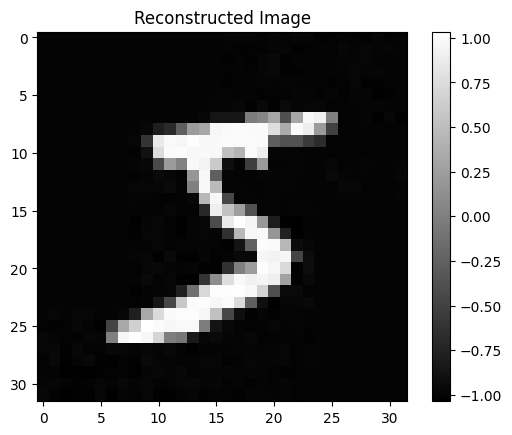

In [ ]:
reconstructed_image_enn = reconstruct_image_from_array(predicted_image_blocks)

# Display the reconstructed image
plt.imshow(reconstructed_image_enn, cmap='gray')
plt.colorbar()
plt.title('Reconstructed Image')
plt.show()


In [ ]:
enn_error = (reconstructed_image_enn - image).reshape(-1)
enn_prediction = reconstructed_image_enn
enn_difference = reconstructed_image_enn - image

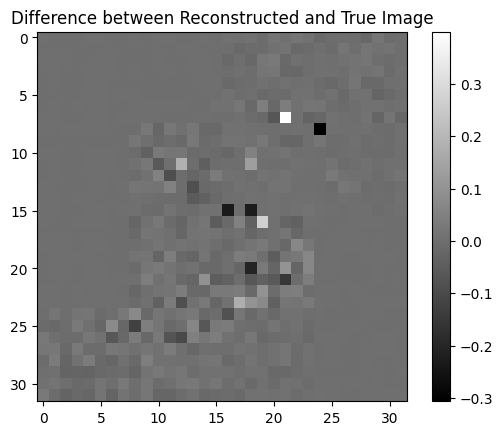

In [ ]:
plt.imshow(enn_difference, cmap='gray')
plt.colorbar()
plt.title('Difference between Reconstructed and True Image')
plt.show()


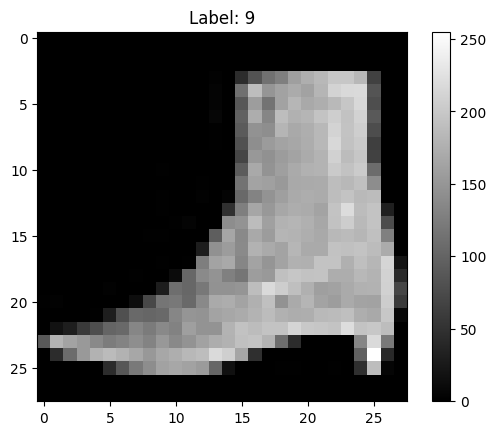

In [ ]:

from tensorflow import keras

# Load the Fashion MNIST dataset
(x_train, y_train), (x_test, y_test) = keras.datasets.fashion_mnist.load_data()

# Select a random image
chosen_idx = 13040#np.random.randint(0, len(x_train))
fmnist_img = x_train[chosen_idx]
fmnist_label = y_train[chosen_idx]

# Display the image
plt.imshow(fmnist_img, cmap='gray')
plt.title(f"Label: {fmnist_label}")
plt.colorbar()
plt.show()

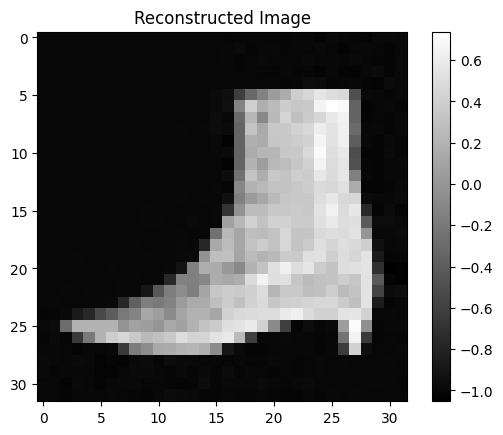

In [ ]:
reconstructed_image = reconstruct_image_from_array(predicted_image_blocks)

plt.imshow(reconstructed_image, cmap='gray')
plt.colorbar()
plt.title('Reconstructed Image')
plt.show()

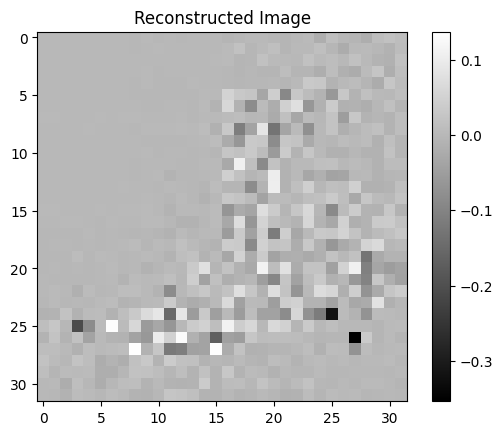

In [ ]:
plt.imshow(reconstructed_image-image, cmap='gray')
plt.colorbar()
plt.title('Reconstructed Image')
plt.show()

0.0010797584130676553


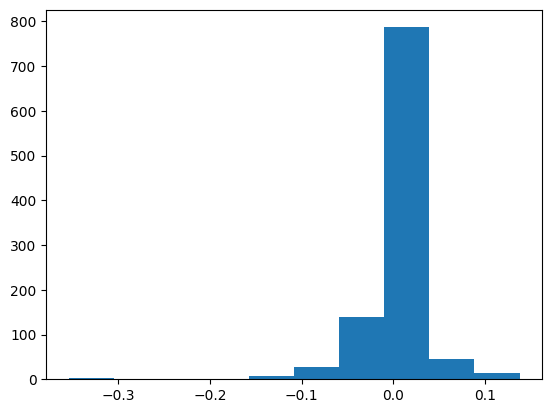

In [ ]:
plt.hist(reconstructed_image.flatten()-image.flatten());
print(np.mean(mse_per_block))

#### Monte Carlo Simulations on the MNIST - ENN

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 34       # Select function
width = 3          # Number of neurons in the hidden layer
n_coeffs =  3      # Number of DCT coefficients per neuron
n_train = 200000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

#Simulation parameters
start_sample = 0
simulation_size = 30
block_size = 8
last = time.time()

if not os.path.exists(f'Coeff_{n_coeffs}'):
  os.makedirs(f'Coeff_{n_coeffs}')
if not os.path.exists(f'Coeff_{n_coeffs}/Width_{width}'):
  os.makedirs(f'Coeff_{n_coeffs}/Width_{width}')


for h in range(start_sample, simulation_size):
  #Get and preprocess image
  image, label = mnist_train[h]
  image = preprocess_img(np.array(image))
  img_height, img_width = image.shape

  #Logs
  time_taken = round((time.time()-last)/60, 2)
  print(f'Processing image {h}/{simulation_size}. Time taken by the last image {time_taken}')
  last = time.time()


  image_blocks = []
  predicted_image_blocks = []
  mse_per_block = []
  loss_per_block  = []
  nmse_per_block = []

  for i in range(0, img_height, block_size):
    for j in range(0, img_width, block_size):
      # Extract the current block
      block = image[i:i + block_size, j:j + block_size]
      image_blocks.append(block)

      data_train = Dataset(n_train, function, x0=0.45, input_image = block)#8x8 image
      data_test = Dataset(n_test, function, x0=0.65, input_image = block)

      enn = ENN(n_input, width, nft, n_coeffs)

      loss = enn.train(data_train, lms)
      loss_per_block.append(loss)

      x = np.array(list(set(data_test.x[0,:])))
      x.sort()
      y = np.array(list(set(data_test.x[1,:])))
      y.sort()
      predicted_block = np.zeros((block_size,block_size))

      block_mse = 0.0

      for a in range(len(x)):
        for b in range(len(y)):
          x_in = np.array([x[a], y[b]])
          prediction, error, _= enn.forward(x_in[..., None], block[a,b])
          predicted_block[a,b] = prediction[0,0]
          block_mse += error**2
      block_mse = block_mse/(len(x)*len(y))

      mse_per_block.append(block_mse[0][0])
      nmse_per_block.append(block_mse[0][0]/np.mean(block.flatten()**2 + 1e-10))
      predicted_image_blocks.append(predicted_block)
  np.save(f'Coeff_{n_coeffs}/Width_{width}/MSE_per_block_{h}.npy',np.array(mse_per_block))
  np.save(f'Coeff_{n_coeffs}/Width_{width}/loss_per_block_{h}.npy',np.array(loss_per_block))
  np.save(f'Coeff_{n_coeffs}/Width_{width}/predicted_image_{h}.npy',reconstruct_image_from_array(predicted_image_blocks))
  np.save(f'Coeff_{n_coeffs}/Width_{width}/original_image_{h}.npy',image)
  np.save(f'Coeff_{n_coeffs}/Width_{width}/NMSE_per_block_{h}.npy',np.array(nmse_per_block))

Processing image 0/30. Time taken by the last image 0.0


<ipython-input-23-e3088c0e150d>:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])


Processing image 1/30. Time taken by the last image 19.7
Processing image 2/30. Time taken by the last image 16.59
Processing image 3/30. Time taken by the last image 16.44
Processing image 4/30. Time taken by the last image 16.42
Processing image 5/30. Time taken by the last image 16.47
Processing image 6/30. Time taken by the last image 16.46
Processing image 7/30. Time taken by the last image 16.43
Processing image 8/30. Time taken by the last image 16.43
Processing image 9/30. Time taken by the last image 16.4
Processing image 10/30. Time taken by the last image 16.47
Processing image 11/30. Time taken by the last image 16.47
Processing image 12/30. Time taken by the last image 16.32
Processing image 13/30. Time taken by the last image 16.39
Processing image 14/30. Time taken by the last image 16.41
Processing image 15/30. Time taken by the last image 16.35
Processing image 16/30. Time taken by the last image 16.39
Processing image 17/30. Time taken by the last image 16.27
Processi

In [ ]:
mean_mse_coeffs_6 = np.array([np.mean([np.mean(np.load(f'Coeff_6/Width_{j}/MSE_per_block_{i}.npy')) for i in range(0,30)]) for j in [3,4,5,6]])
mean_mse_coeffs_3 = np.array([np.mean([np.mean(np.load(f'Coeff_3/Width_{j}/MSE_per_block_{i}.npy')) for i in range(0,30)]) for j in [3,4,5,6]])
mean_mse_coeffs_12 = np.array([np.mean([np.mean(np.load(f'Coeff_12/Width_{j}/MSE_per_block_{i}.npy')) for i in range(0,30)]) for j in [3,4,5,6]])

In [ ]:
plt.plot([3,4,5,6],mean_mse_coeffs_12, '-*', label ='DCT coeffs = 12')
plt.plot([3,4,5,6], mean_mse_coeffs_6, '-*', label ='DCT coeffs = 6')
plt.plot([3,4,5,6],mean_mse_coeffs_3, '-*', label ='DCT coeffs = 3')
plt.xlabel('Width')
plt.ylabel('MSE')
plt.title('MSE for DCT Coefficients and Width')
plt.grid(True, linestyle='--', alpha = 0.6)
# This shows the legend on the plot
plt.legend()


#### Predicting 32x32 images block by block: Cifar 10

##### Using 8x8 blocks

100%|██████████| 170M/170M [00:03<00:00, 51.4MB/s]


Extracting ./data/cifar-10-python.tar.gz to ./data


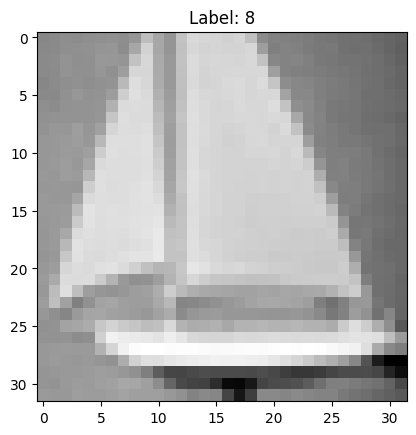

In [ ]:
# Load the CIFAR-10 dataset
cifar10_train = datasets.CIFAR10(root='./data', train=True, download=True)

chosen_image = 3493 #np.random.randint(0, len(cifar10_train))
cifar_image, label = cifar10_train[chosen_image]

cifar_image = np.array(cifar_image)
cifar_image_greyscaled = rgb2gray(cifar_image)
plt.imshow(cifar_image_greyscaled, cmap='grey')
plt.title(f"Label: {label}")
plt.show()

Processing block 1.0


<ipython-input-59-e3088c0e150d>:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])


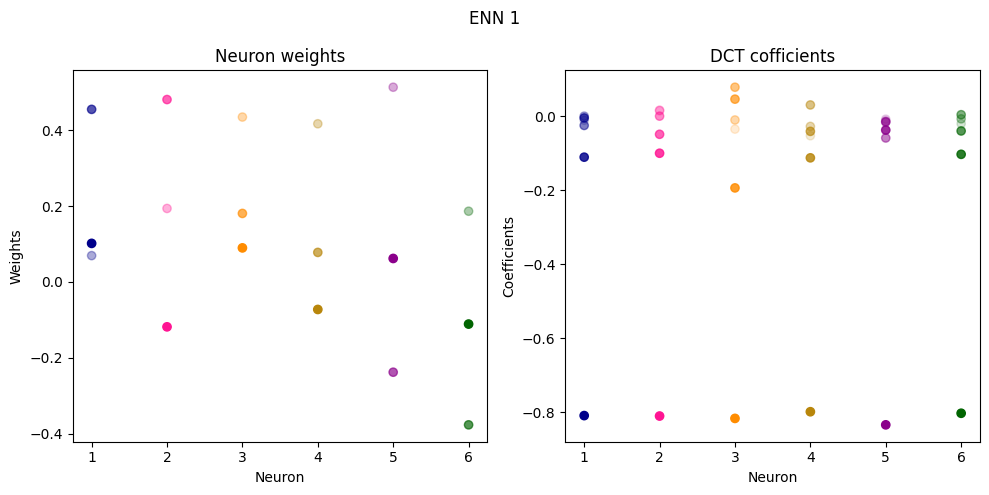

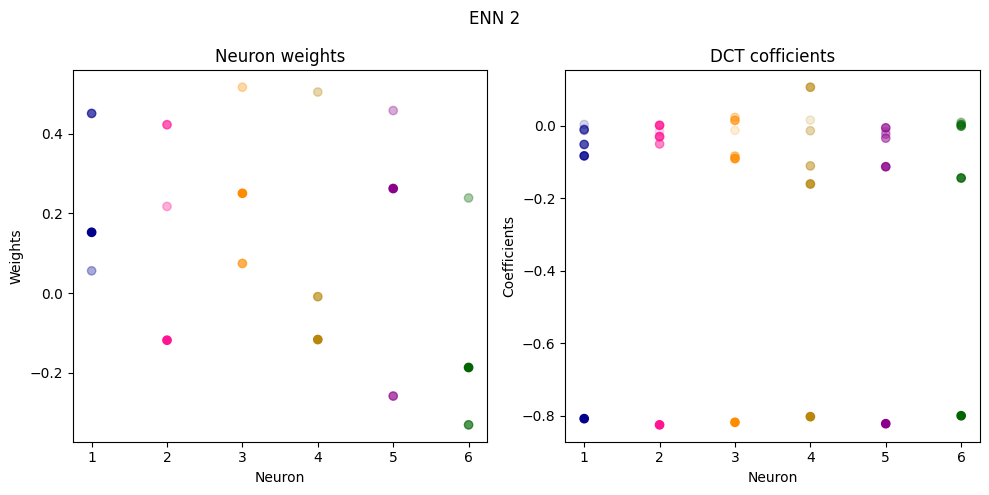

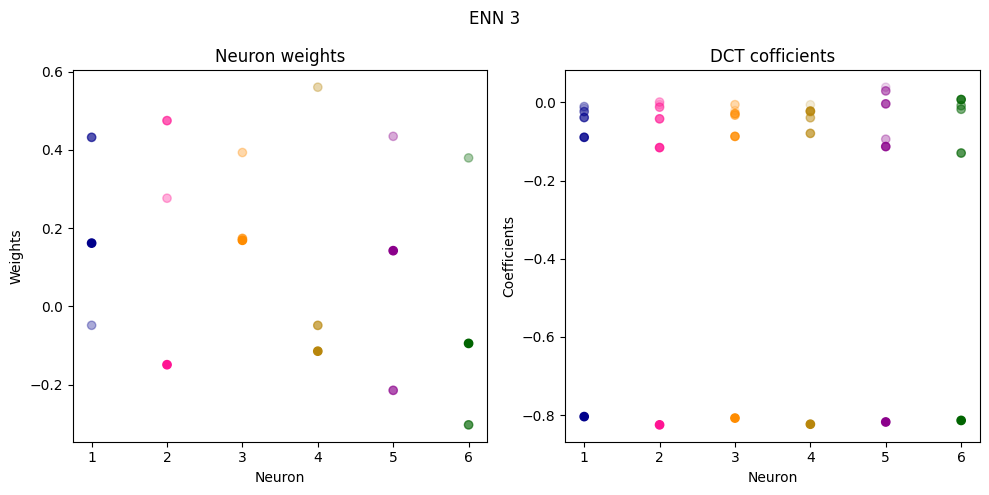

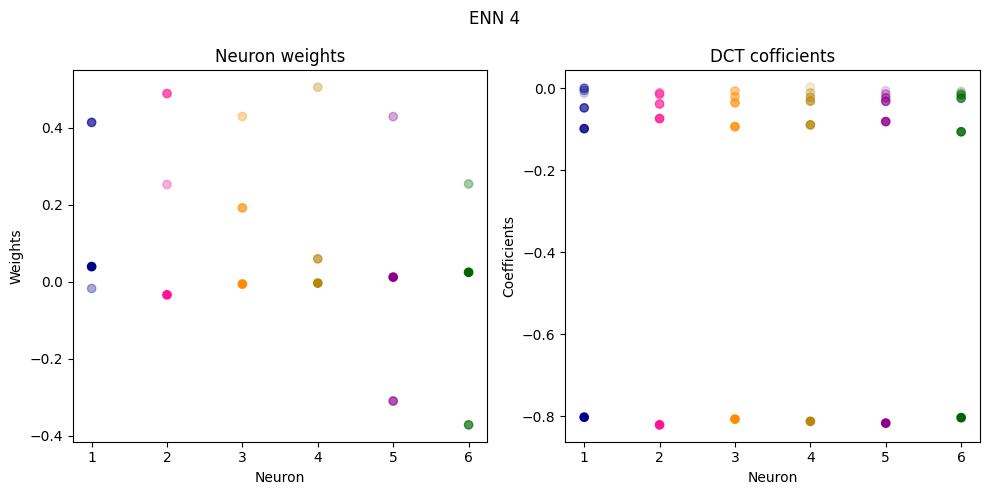

Processing block 2.0


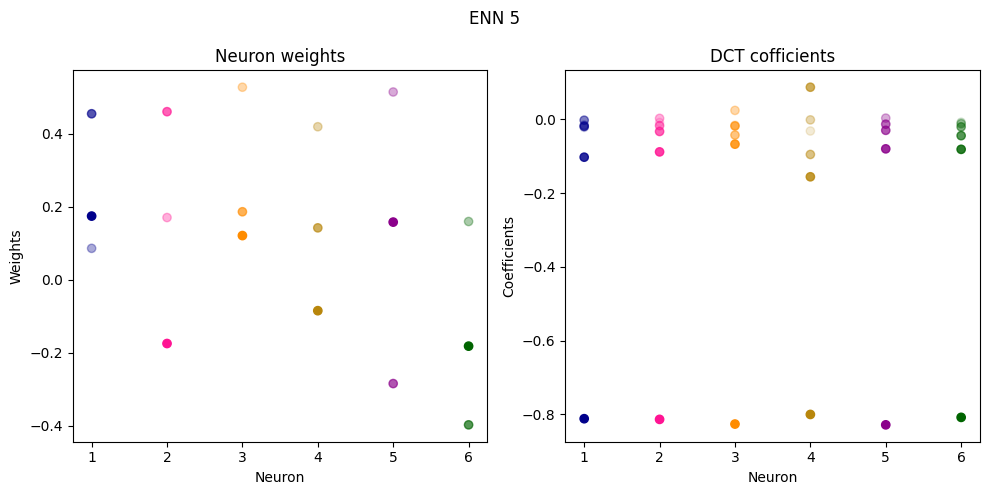

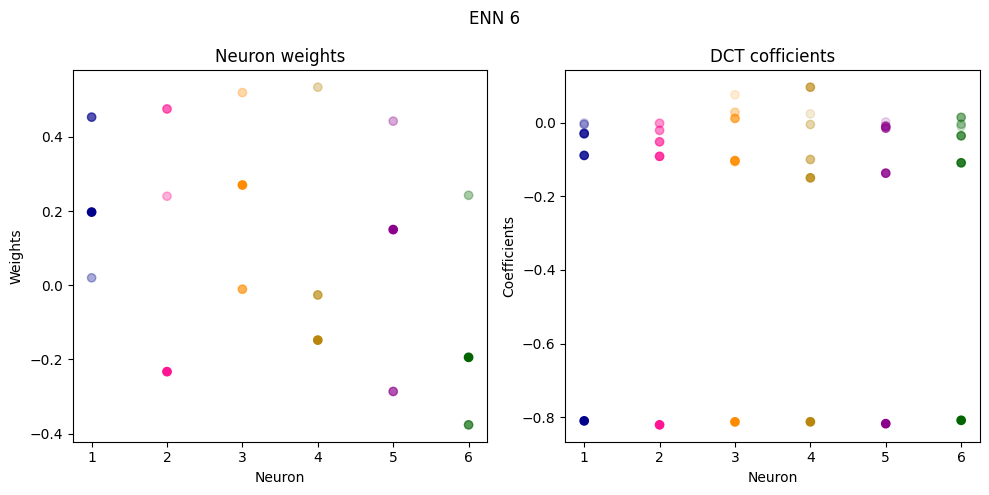

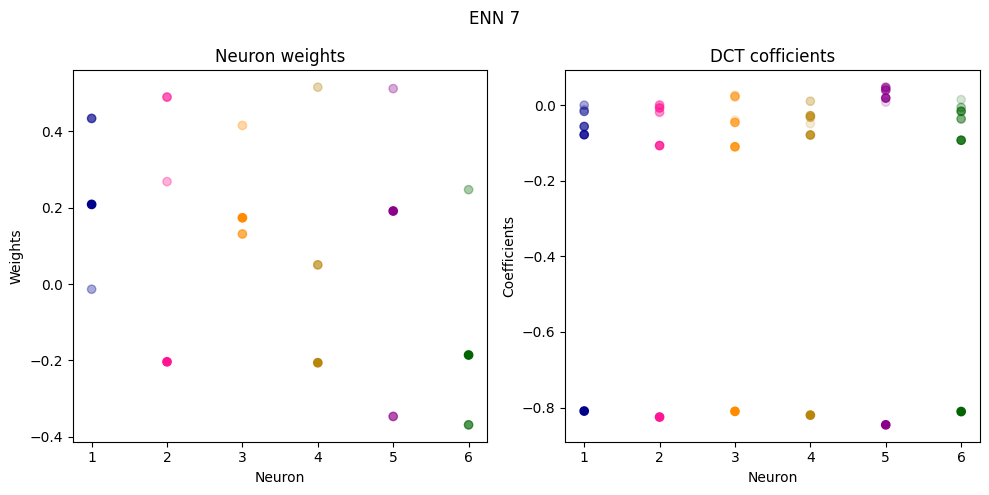

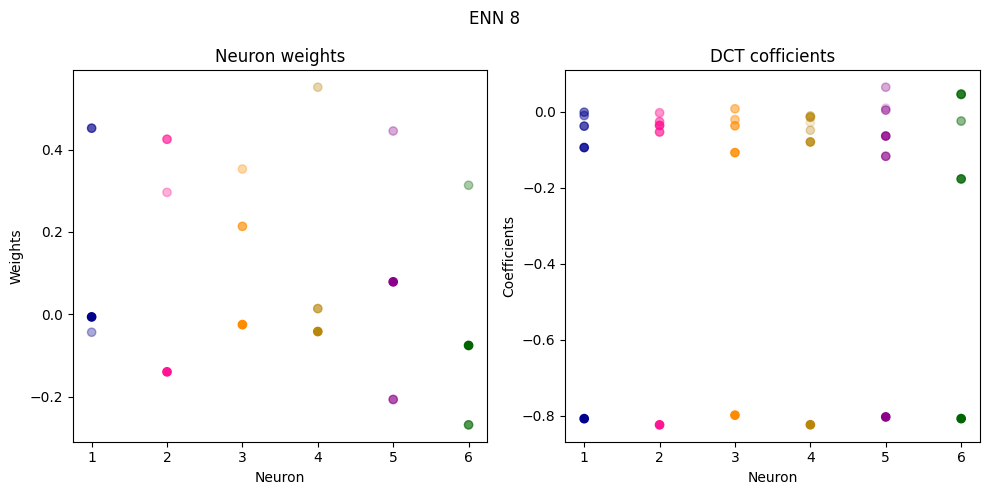

Processing block 3.0


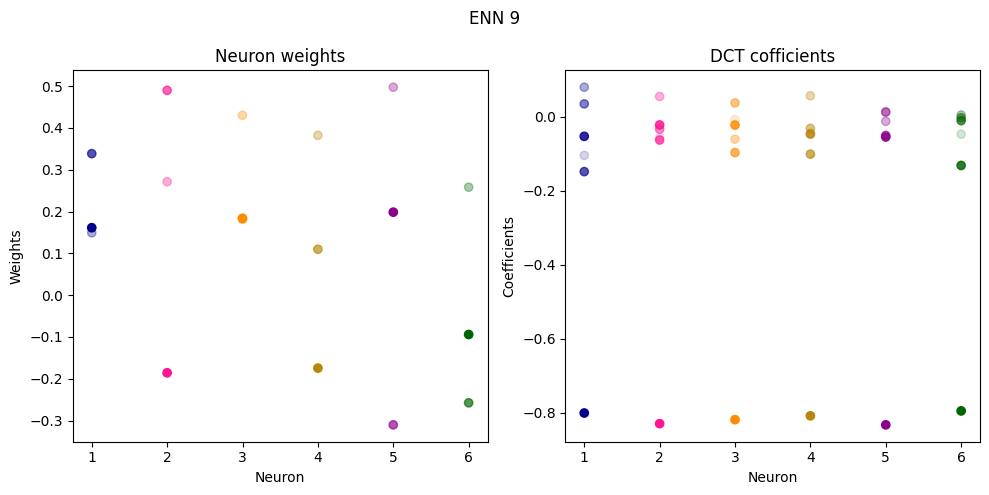

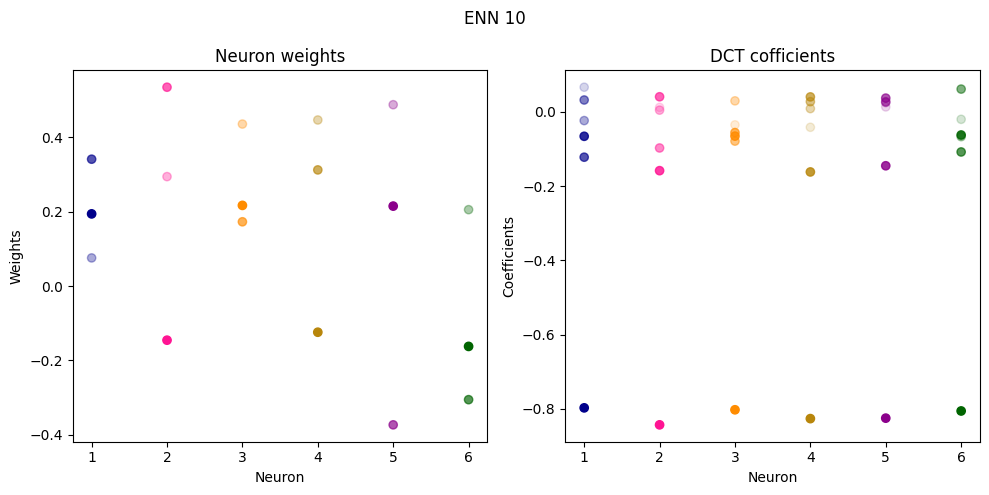

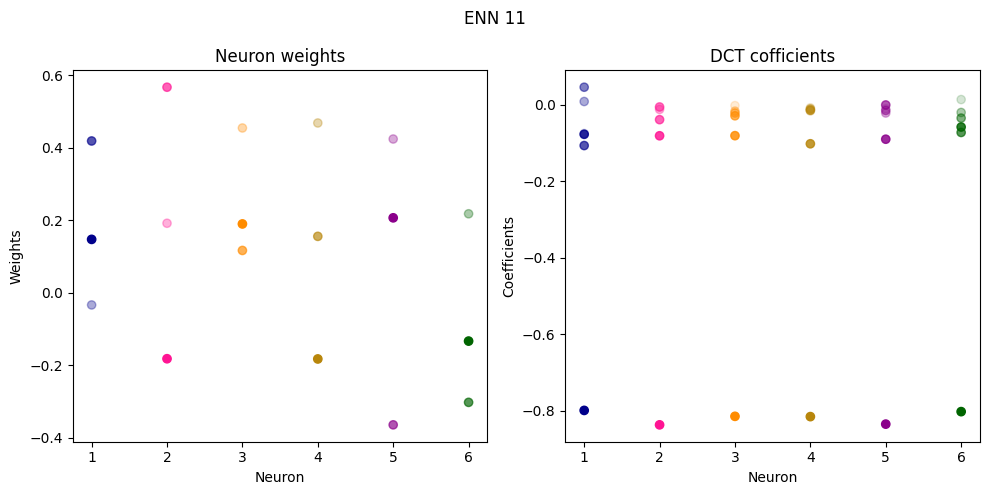

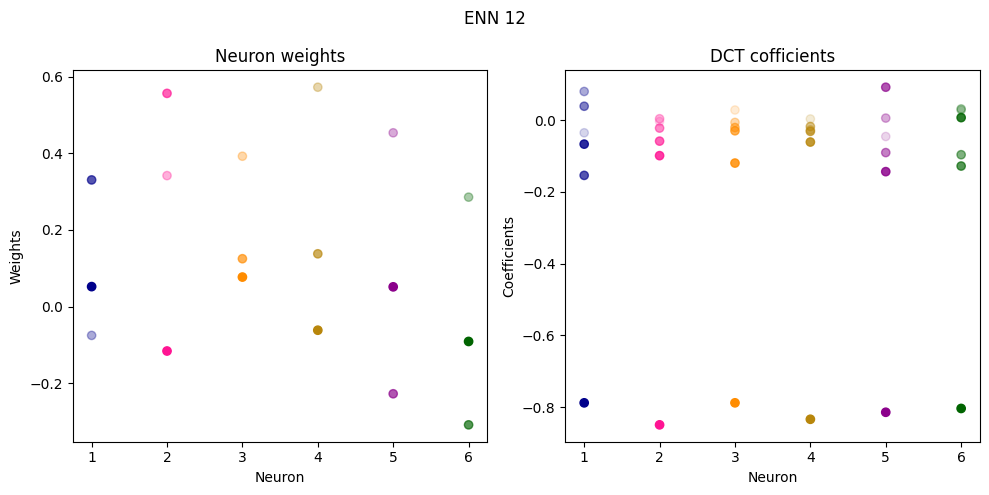

Processing block 4.0


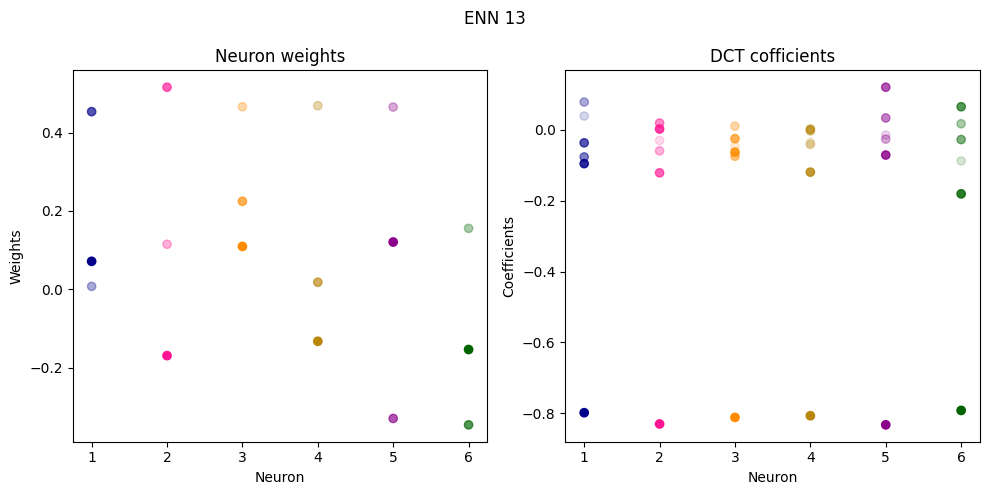

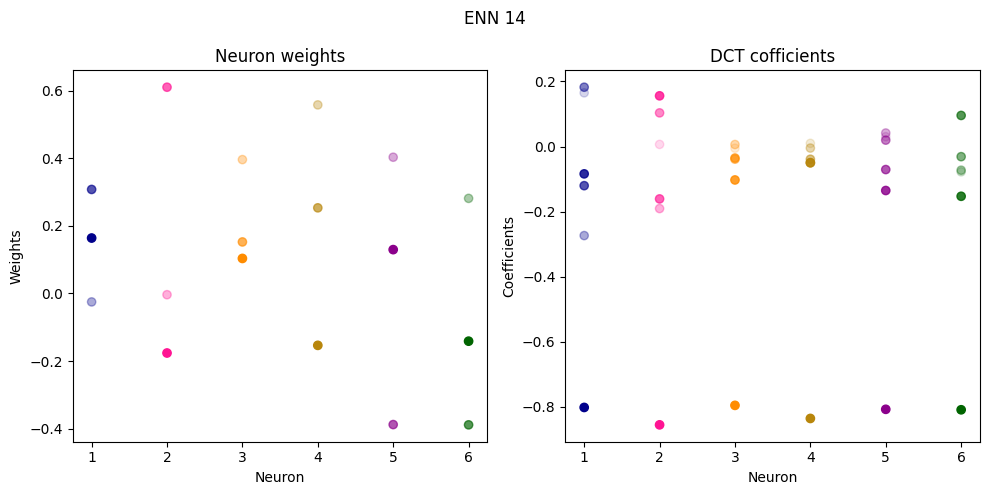

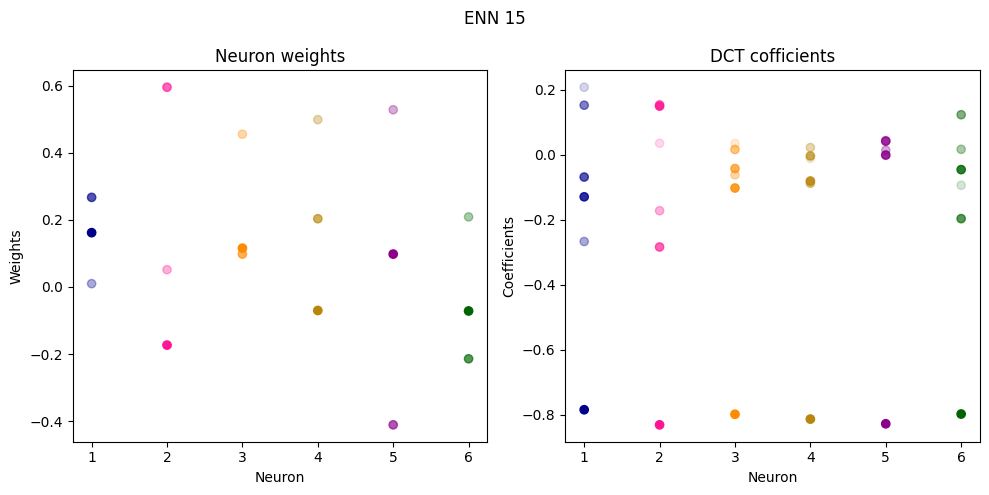

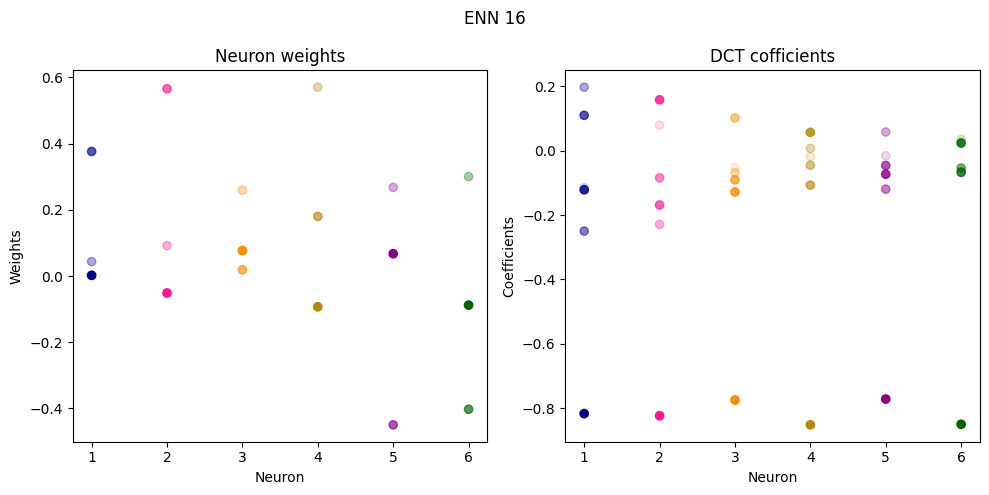

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 34       # Select function
width = 6          # Number of neurons in the hidden layer
n_coeffs =  6      # Number of DCT coefficients per neuron
n_train = 200000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)
mse_per_block = []

image = preprocess_img(np.array(cifar_image_greyscaled))
img_height, img_width = image.shape
block_size = 8
image_blocks = []
predicted_image_blocks = []
error_train = []

for i in range(0, img_height, block_size):
  print(f'Processing block {i/8 +1}')
  for j in range(0, img_width, block_size):
    # Extract the current block
    block = image[i:i + block_size, j:j + block_size]
    image_blocks.append(block)

    data_train = Dataset(n_train, function, x0=0.45, input_image = block)#8x8 image
    data_test = Dataset(n_test, function, x0=0.65, input_image = block)

    enn = ENN(n_input, width, nft, n_coeffs)

    error_train.append(enn.train(data_train, lms))

    plot_coefficients(enn, i=len(image_blocks))

    x = np.array(list(set(data_test.x[0,:])))
    x.sort()
    y = np.array(list(set(data_test.x[1,:])))
    y.sort()
    predicted_block = np.zeros((block_size,block_size))

    block_mse = 0.0

    for a in range(len(x)):
      for b in range(len(y)):
        x_in = np.array([x[a], y[b]])
        prediction, error, _= enn.forward(x_in[..., None], block[a,b])
        predicted_block[a,b] = prediction[0,0]
        block_mse += error**2
    block_mse = block_mse/(len(x)*len(y))

    mse_per_block.append(block_mse)
    predicted_image_blocks.append(predicted_block)

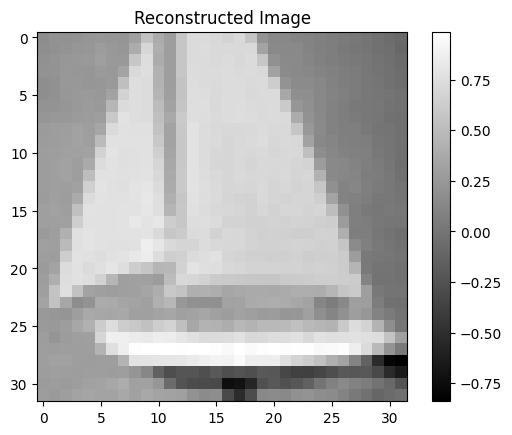

In [ ]:
reconstructed_image = reconstruct_image_from_array(predicted_image_blocks)
# Display the reconstructed image
plt.imshow(reconstructed_image, cmap='gray')
plt.colorbar()
plt.title('Reconstructed Image')
plt.show()

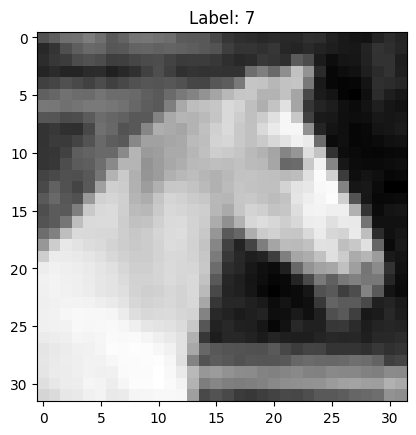

In [ ]:
horse_idx = 28234

cifar_image, label = cifar10_train[horse_idx]

cifar_image = np.array(cifar_image)
cifar_image_greyscaled = rgb2gray(cifar_image)
plt.imshow(cifar_image_greyscaled, cmap='grey')
plt.title(f"Label: {label}")
plt.show()

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 34       # Select function
width = 6          # Number of neurons in the hidden layer
n_coeffs =  6      # Number of DCT coefficients per neuron
n_train = 200000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)
mse_per_block = []

image = preprocess_img(np.array(cifar_image_greyscaled))
img_height, img_width = image.shape
block_size = 8
image_blocks = []
predicted_image_blocks = []
error_train = []

for i in range(0, img_height, block_size):
  print(f'Processing block {i/8 +1}')
  for j in range(0, img_width, block_size):
    # Extract the current block
    block = image[i:i + block_size, j:j + block_size]
    image_blocks.append(block)

    data_train = Dataset(n_train, function, x0=0.45, input_image = block)#8x8 image
    data_test = Dataset(n_test, function, x0=0.65, input_image = block)

    enn = ENN(n_input, width, nft, n_coeffs)

    error_train.append(enn.train(data_train, lms))
    x = np.array(list(set(data_test.x[0,:])))
    x.sort()
    y = np.array(list(set(data_test.x[1,:])))
    y.sort()
    predicted_block = np.zeros((block_size,block_size))

    block_mse = 0.0

    for a in range(len(x)):
      for b in range(len(y)):
        x_in = np.array([x[a], y[b]])
        prediction, error, _= enn.forward(x_in[..., None], block[a,b])
        predicted_block[a,b] = prediction[0,0]
        block_mse += error**2
    block_mse = block_mse/(len(x)*len(y))

    mse_per_block.append(block_mse)
    predicted_image_blocks.append(predicted_block)

Processing block 1.0


<ipython-input-38-e3088c0e150d>:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])


Processing block 2.0
Processing block 3.0
Processing block 4.0


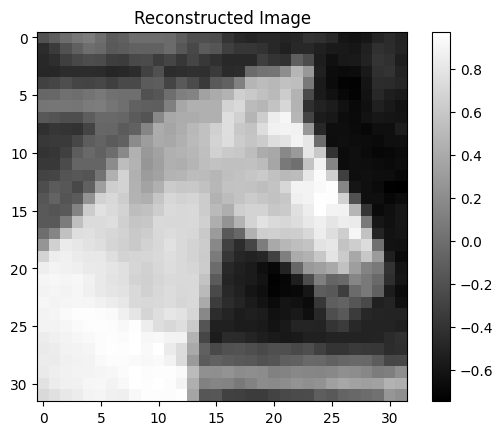

In [ ]:
reconstructed_horse = reconstruct_image_from_array(predicted_image_blocks)
plt.imshow(reconstructed_horse, cmap='gray')
plt.colorbar()
plt.title('Reconstructed Image')
plt.show()

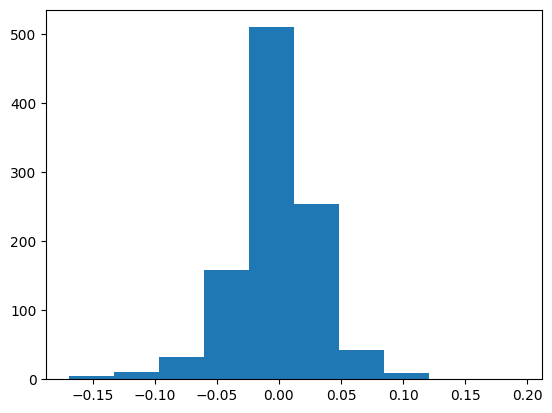

MSE: 0.0012154535038688614


In [ ]:
plt.hist(reconstructed_horse.flatten()-image.flatten())
plt.show()
print(f'MSE: {np.mean(mse_per_block)}')

##### Using 16x16 blocks

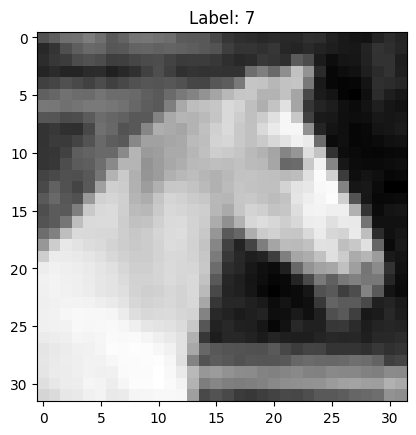

In [ ]:
chosen_image = 28234
cifar_image, label = cifar10_train[chosen_image]

cifar_image = np.array(cifar_image)
cifar_image_greyscaled = rgb2gray(cifar_image)
plt.imshow(cifar_image_greyscaled, cmap='grey')
plt.title(f"Label: {label}")
plt.show()

Processing block 1.0


<ipython-input-4-e3088c0e150d>:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])


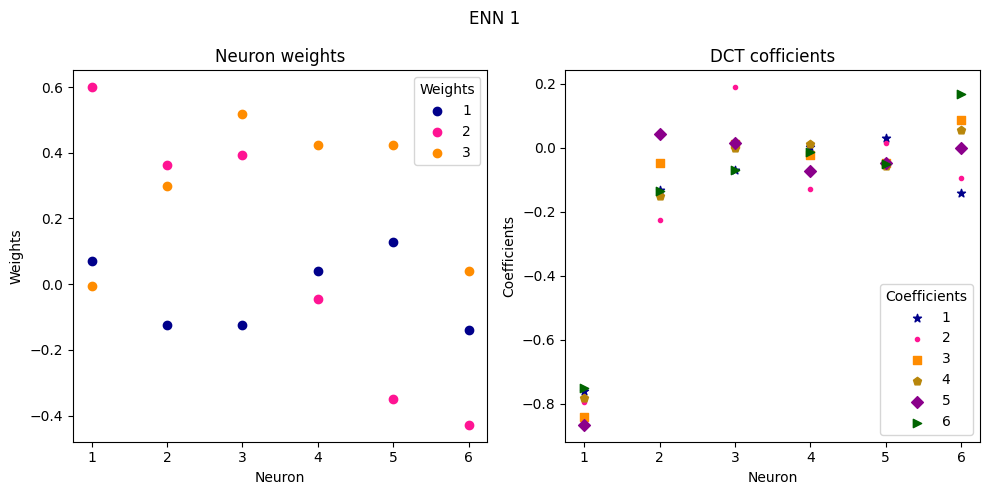

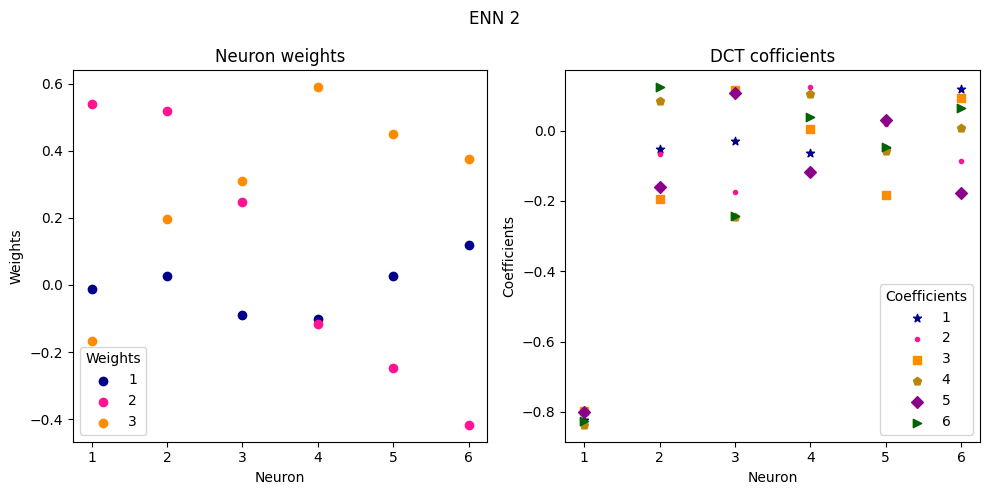

Processing block 3.0


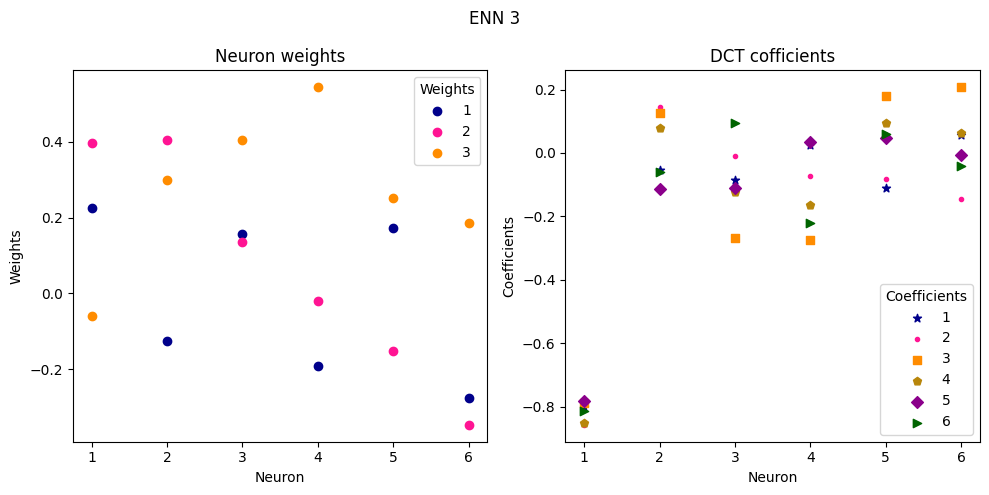

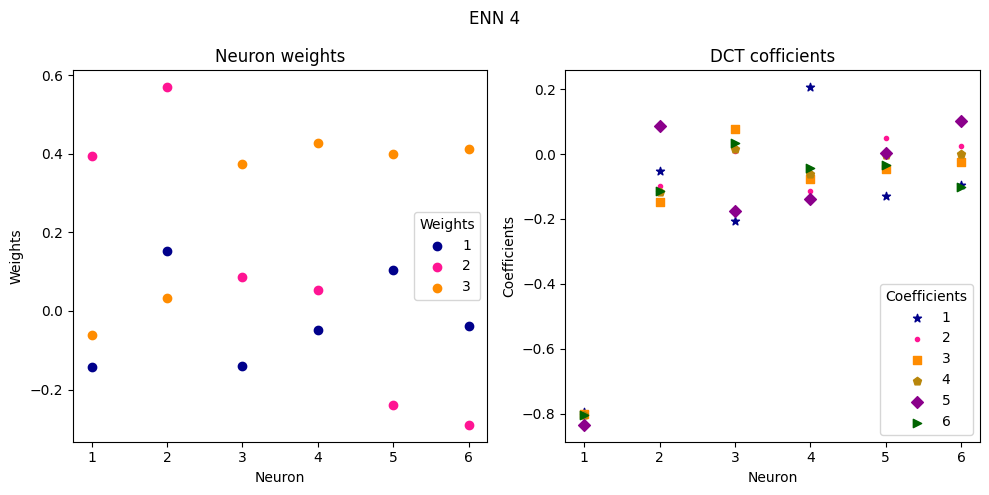

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 34       # Select function
width = 6          # Number of neurons in the hidden layer
n_coeffs =  6      # Number of DCT coefficients per neuron
n_train = 200000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)
mse_per_block = []

image = preprocess_img(np.array(cifar_image_greyscaled))
img_height, img_width = image.shape
block_size = 16
image_blocks = []
predicted_image_blocks = []
error_train = []

for i in range(0, img_height, block_size):
  print(f'Processing block {i/8 +1}')
  for j in range(0, img_width, block_size):
    # Extract the current block
    block = image[i:i + block_size, j:j + block_size]
    image_blocks.append(block)

    data_train = Dataset(n_train, function, x0=0.45, input_image = block)#8x8 image
    data_test = Dataset(n_test, function, x0=0.65, input_image = block)

    enn = ENN(n_input, width, nft, n_coeffs)

    error_train.append(enn.train(data_train, lms))

    plot_coefficients(enn, i=len(image_blocks))

    x = np.array(list(set(data_test.x[0,:])))
    x.sort()
    y = np.array(list(set(data_test.x[1,:])))
    y.sort()
    predicted_block = np.zeros((block_size,block_size))

    block_mse = 0.0

    for a in range(len(x)):
      for b in range(len(y)):
        x_in = np.array([x[a], y[b]])
        prediction, error, _= enn.forward(x_in[..., None], block[a,b])
        predicted_block[a,b] = prediction[0,0]
        block_mse += error**2
    block_mse = block_mse/(len(x)*len(y))

    mse_per_block.append(block_mse)
    predicted_image_blocks.append(predicted_block)

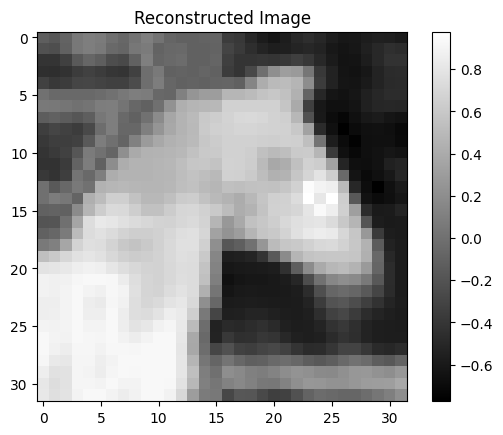

In [ ]:
reconstructed_image = reconstruct_image_from_array(predicted_image_blocks, block_size = 16)

# Display the reconstructed image
plt.imshow(reconstructed_image, cmap='gray')
plt.colorbar()
plt.title('Reconstructed Image')
plt.show()

Total MSE:0.013070340119084919


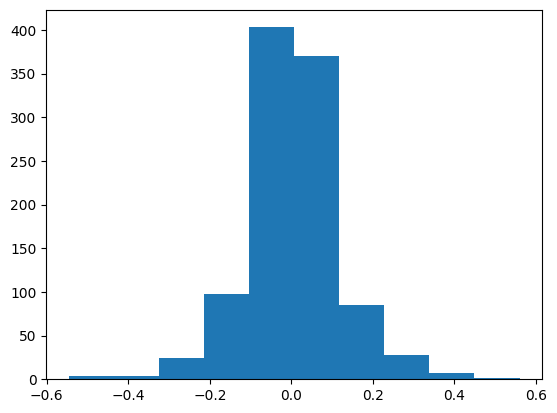

In [ ]:
print(f'Total MSE:{np.mean(mse_per_block)}')
plt.hist(reconstructed_image.flatten()-image.flatten());

Processing block 1.0


<ipython-input-59-e3088c0e150d>:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  _, loss[i], x_proc = self.forward(x[:,[i]], y[i])


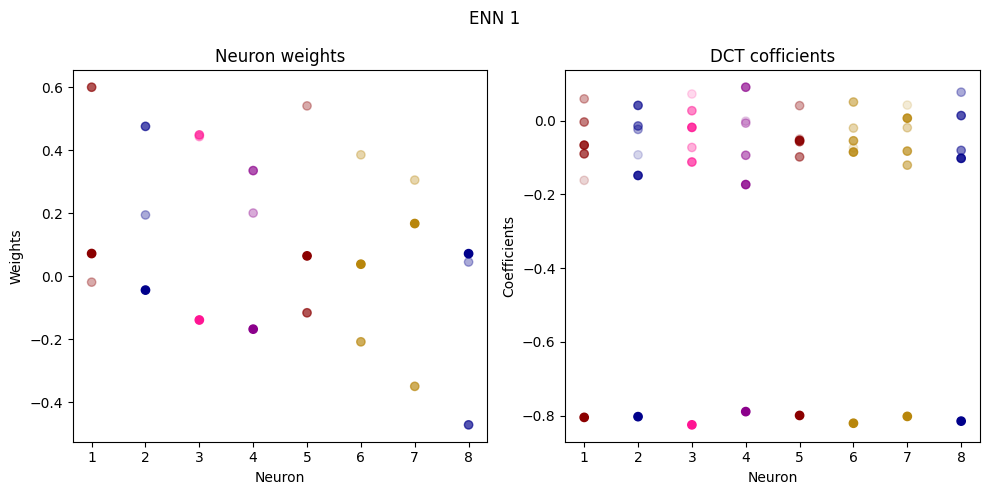

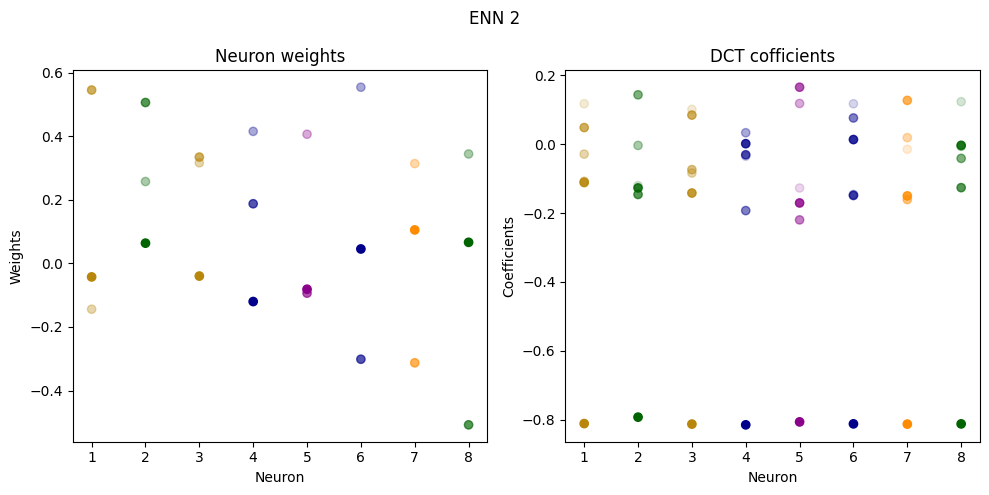

Processing block 3.0


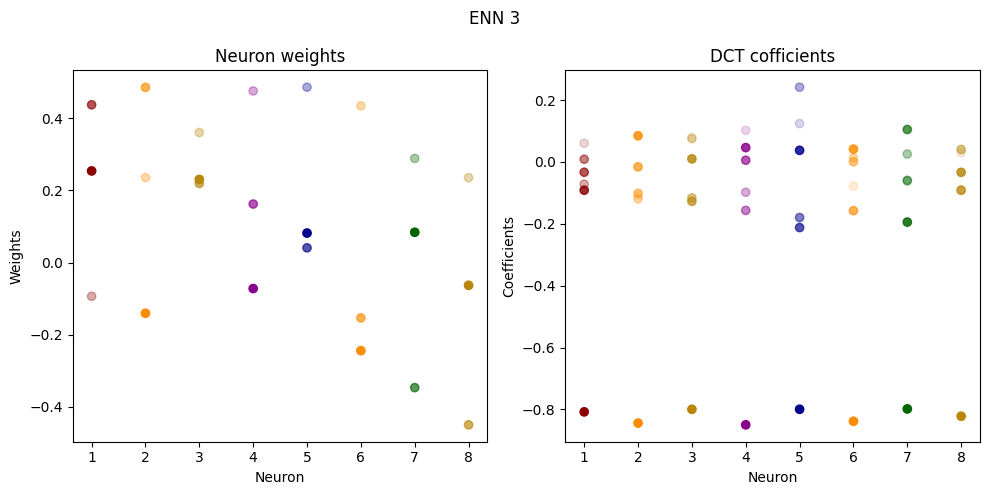

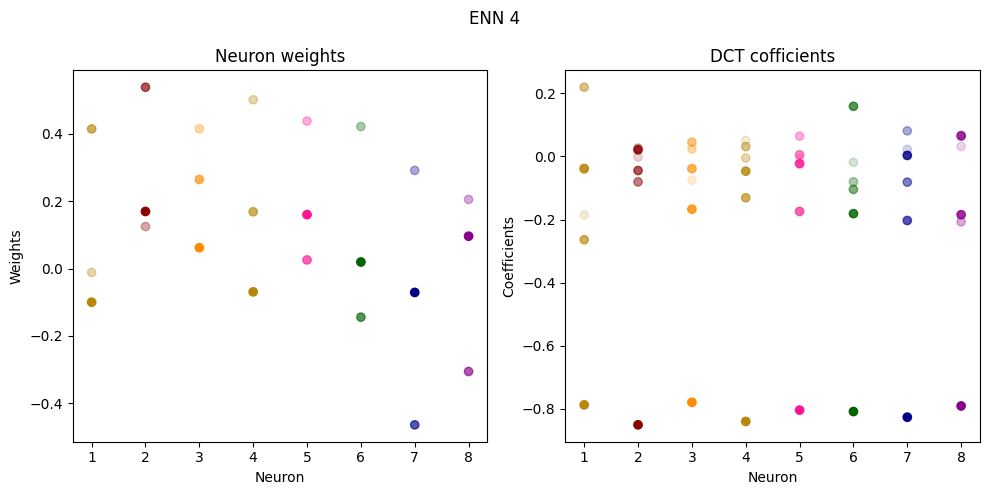

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 34       # Select function
width = 8          # Number of neurons in the hidden layer
n_coeffs =  6      # Number of DCT coefficients per neuron
n_train = 200000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)
mse_per_block = []

image = preprocess_img(np.array(cifar_image_greyscaled))
img_height, img_width = image.shape
block_size = 16
image_blocks = []
predicted_image_blocks = []
error_train = []

for i in range(0, img_height, block_size):
  print(f'Processing block {i/8 +1}')
  for j in range(0, img_width, block_size):
    # Extract the current block
    block = image[i:i + block_size, j:j + block_size]
    image_blocks.append(block)

    data_train = Dataset(n_train, function, x0=0.45, input_image = block)#8x8 image
    data_test = Dataset(n_test, function, x0=0.65, input_image = block)

    enn = ENN(n_input, width, nft, n_coeffs)

    error_train.append(enn.train(data_train, lms))

    plot_coefficients(enn, i=len(image_blocks))

    x = np.array(list(set(data_test.x[0,:])))
    x.sort()
    y = np.array(list(set(data_test.x[1,:])))
    y.sort()
    predicted_block = np.zeros((block_size,block_size))

    block_mse = 0.0

    for a in range(len(x)):
      for b in range(len(y)):
        x_in = np.array([x[a], y[b]])
        prediction, error, _= enn.forward(x_in[..., None], block[a,b])
        predicted_block[a,b] = prediction[0,0]
        block_mse += error**2
    block_mse = block_mse/(len(x)*len(y))

    mse_per_block.append(block_mse)
    predicted_image_blocks.append(predicted_block)

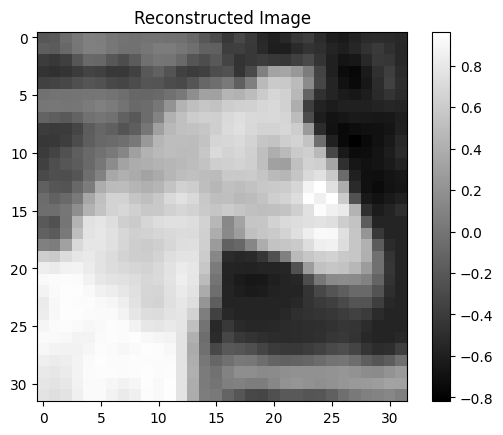

In [ ]:
reconstructed_image = reconstruct_image_from_array(predicted_image_blocks, block_size = 16)

# Display the reconstructed image
plt.imshow(reconstructed_image, cmap='gray')
plt.colorbar()
plt.title('Reconstructed Image')
plt.show()

Total MSE:0.011758020761412007


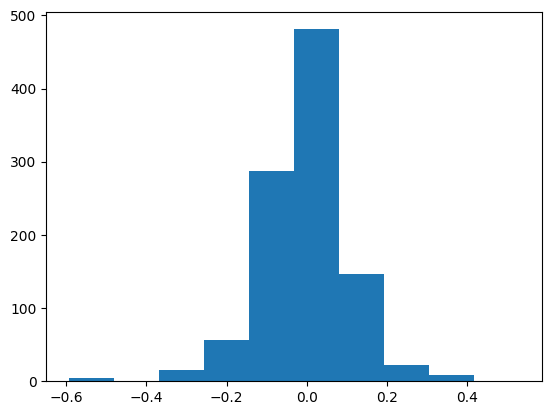

In [ ]:
print(f'Total MSE:{np.mean(mse_per_block)}')
plt.hist(reconstructed_image.flatten()-image.flatten());

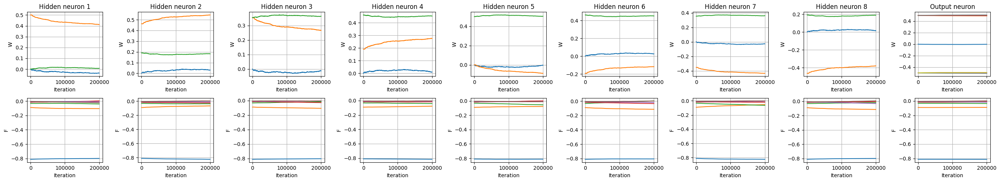

In [ ]:
plot_params_hist(enn, n_train)

#### Predicting 128x128 images

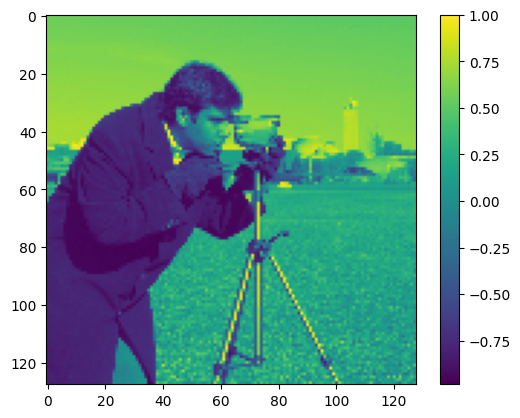

In [ ]:
from scipy import ndimage
img_128 = data.camera()
img_128 = ndimage.zoom(img_128,0.25) #decimate resolution
img_max = np.max(img_128)
img_128 = img_128*(2/img_max)-1
plt.imshow(img_128)
plt.colorbar()

In [ ]:
n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 34       # Select function
width = 6          # Number of neurons in the hidden layer
n_coeffs =  6      # Number of DCT coefficients per neuron
n_train = 200000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)
mse_per_block = []

image = img_128
image = (image*2)/np.max(image)
image -= 1
img_height, img_width = image.shape
block_size = 8
image_blocks = []
predicted_image_blocks = []
error_train = []

for i in range(0, img_height, block_size):
  print(f'Processing block {i/8 +1}')
  for j in range(0, img_width, block_size):
    # Extract the current block
    block = image[i:i + block_size, j:j + block_size]
    image_blocks.append(block)

    data_train = Dataset(n_train, function, x0=0.45, input_image = block)#8x8 image
    data_test = Dataset(n_test, function, x0=0.65, input_image = block)

    enn = ENN(n_input, width, nft, n_coeffs)

    error_train.append(enn.train(data_train, lms))
    x = np.array(list(set(data_test.x[0,:])))
    x.sort()
    y = np.array(list(set(data_test.x[1,:])))
    y.sort()
    predicted_block = np.zeros((block_size,block_size))

    block_mse = 0.0
    # Create an empty file
    if not os.path.exists("mse_results.txt"):
      with open("mse_results.txt", "w") as f:
          pass

    for a in range(len(x)):
      for b in range(len(y)):
        x_in = np.array([x[a], y[b]])
        prediction, error, _= enn.forward(x_in[..., None], block[a,b])
        predicted_block[a,b] = prediction[0,0]
        #create file and save prediction
        block_mse += error**2
    block_mse = block_mse/(len(x)*len(y))

    np.save(f"prediction_block_{i}_{j}.npy", predicted_block)
    with open("mse_results.txt", "a") as f:
      f.write(f"{block_mse}\n")

    mse_per_block.append(block_mse)
    predicted_image_blocks.append(predicted_block)

In [ ]:
import os

n_input = 2        # Number of input variables
nft = 512          # Resolution for plots of NLC response
function = 34       # Select function
width = 6          # Number of neurons in the hidden layer
n_coeffs =  6      # Number of DCT coefficients per neuron
n_train = 200000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples

# LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)
mse_per_block = []

image = img_128
image = (image*2)/np.max(image)
image -= 1
img_height, img_width = image.shape
block_size = 8
image_blocks = []
predicted_image_blocks = []
error_train = []

for i in range(0, img_height, block_size):
  print(f'Processing block {i/8 +1}')
  for j in range(0, img_width, block_size):
    # Extract the current block
    block = image[i:i + block_size, j:j + block_size]
    image_blocks.append(block)

    block_mse = 0.0
    # Create an empty file
    if not os.path.exists("mse_results.txt"):
      with open("mse_results.txt", "w") as f:
          pass

    #create file and save prediction
    np.save(f"prediction_block_{i}_{j}.npy", block)
    block_mse = 0.1
    with open("mse_results.txt", "a") as f:
      f.write(f"{block_mse}\n")

    mse_per_block.append(block_mse)

Processing block 1.0
Processing block 2.0
Processing block 3.0
Processing block 4.0
Processing block 5.0
Processing block 6.0
Processing block 7.0
Processing block 8.0
Processing block 9.0
Processing block 10.0
Processing block 11.0
Processing block 12.0
Processing block 13.0
Processing block 14.0
Processing block 15.0
Processing block 16.0


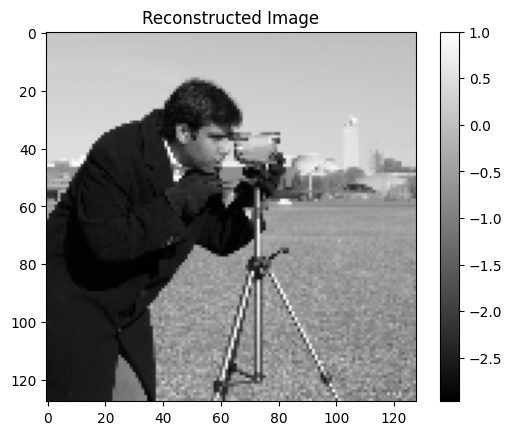

In [ ]:
reconstructed_image = np.zeros((img_height, img_width))

for i in range(0, img_height, block_size):
  for j in range(0, img_width, block_size):
    block = np.load(f"prediction_block_{i}_{j}.npy")
    reconstructed_image[i:i + block_size, j:j + block_size] = block

# Display the reconstructed image
plt.imshow(reconstructed_image, cmap='gray')
plt.colorbar()
plt.title('Reconstructed Image')
plt.show()


### **2D Image Representation: comparison with other architectures**

#### KAN architecture

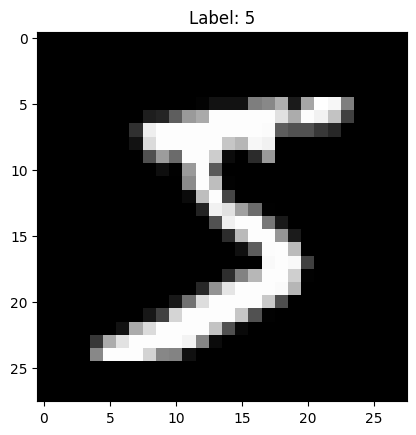

In [84]:
mnist_image, label = mnist_train[0]
mnist_image = np.array(mnist_image)

plt.imshow(mnist_image, cmap='gray')
plt.title(f"Label: {label}")
plt.show()

In [ ]:
n_input = 2        # Number of input variables
function = 34       # Select function
width = 3          # Number of neurons in the hidden layer
n_train = 200000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples
batch = 60
grid = 2
k = 3

mse_per_block = []

mnist_image = np.array(mnist_image)
image = preprocess_img(np.array(mnist_image))
img_height, img_width = image.shape
block_size = 8
image_blocks = []
predicted_image_blocks = []
error_train = []

for i in range(0, img_height, block_size):
  print(f'Processing block {i/8 +1}')
  for j in range(0, img_width, block_size):
    # Extract the current block
    block = image[i:i + block_size, j:j + block_size]
    image_blocks.append(block)

    data_train = Dataset(n_train, function, x0=0.45, input_image=block, torchTensor = True)
    data_test = Dataset(n_test, function, x0=0.65, input_image=block, torchTensor = True)

    my_ds= {"train_input":data_train.x.T,
              "test_input":data_test.x.T,
              "train_label":data_train.y.reshape(-1,1),
              "test_label":data_test.y.reshape(-1,1)}

    kan_model = KAN(width=[n_input, width, 1], grid=grid, k=k, seed=0)
    output = kan_model.fit(my_ds, opt="Adam", steps=int(n_train/batch), batch=batch, lamb=0, lamb_entropy=0, lamb_coef=0, lamb_l1=0,lamb_coefdiff=0, lr=0.001);

    error_train.append(output['train_loss'])
    x = np.array(list(set(data_test.x.numpy()[0,:])))
    x.sort()
    y = np.array(list(set(data_test.x.numpy()[1,:])))
    y.sort()
    predicted_block = np.zeros((block_size,block_size))

    block_error = 0.0

    for a in range(len(x)):
      for b in range(len(y)):
        x_in = np.array([x[a], y[b]])
        prediction = kan_model.forward(torch.from_numpy(x_in).reshape(1,-1)).detach().numpy()
        predicted_block[a,b] = prediction[0,0]
        error = block[a,b] - prediction[0,0]
        block_error += error**2
    block_error = block_error/(len(x)*len(y))

    mse_per_block.append(block_error)
    predicted_image_blocks.append(predicted_block)

Processing block 1.0
checkpoint directory created: ./model
saving model version 0.0


| train_loss: 1.66e-03 | test_loss: 1.60e-03 | reg: 0.00e+00 | : 100%|█| 3333/3333 [03:24<00:00, 16.
/usr/local/lib/python3.11/dist-packages/kan/MultKAN.py:813: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at ../aten/src/ATen/native/ReduceOps.cpp:1823.)
  self.subnode_actscale.append(torch.std(x, dim=0).detach())
/usr/local/lib/python3.11/dist-packages/kan/MultKAN.py:823: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at ../aten/src/ATen/native/ReduceOps.cpp:1823.)
  input_range = torch.std(preacts, dim=0) + 0.1
/usr/local/lib/python3.11/dist-packages/kan/MultKAN.py:824: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at .

saving model version 0.1
checkpoint directory created: ./model
saving model version 0.0


| train_loss: 1.25e-02 | test_loss: 7.46e-03 | reg: 0.00e+00 | : 100%|█| 3333/3333 [02:11<00:00, 25.


saving model version 0.1
checkpoint directory created: ./model
saving model version 0.0


| train_loss: 8.03e-02 | test_loss: 1.51e-01 | reg: 0.00e+00 | : 100%|█| 3333/3333 [01:58<00:00, 28.


saving model version 0.1
checkpoint directory created: ./model
saving model version 0.0


| train_loss: 1.46e-02 | test_loss: 1.63e-02 | reg: 0.00e+00 | : 100%|█| 3333/3333 [01:37<00:00, 34.


saving model version 0.1
Processing block 2.0
checkpoint directory created: ./model
saving model version 0.0


| train_loss: 1.63e-03 | test_loss: 1.93e-03 | reg: 0.00e+00 | : 100%|█| 3333/3333 [01:18<00:00, 42.


saving model version 0.1
checkpoint directory created: ./model
saving model version 0.0


| train_loss: 1.38e-01 | test_loss: 1.43e-01 | reg: 0.00e+00 | : 100%|█| 3333/3333 [01:21<00:00, 40.


saving model version 0.1
checkpoint directory created: ./model
saving model version 0.0


| train_loss: 1.89e-01 | test_loss: 2.12e-01 | reg: 0.00e+00 | : 100%|█| 3333/3333 [01:17<00:00, 42.


saving model version 0.1
checkpoint directory created: ./model
saving model version 0.0


| train_loss: 1.03e-02 | test_loss: 1.08e-02 | reg: 0.00e+00 | : 100%|█| 3333/3333 [01:17<00:00, 43.


saving model version 0.1
Processing block 3.0
checkpoint directory created: ./model
saving model version 0.0


| train_loss: 1.63e-03 | test_loss: 1.93e-03 | reg: 0.00e+00 | : 100%|█| 3333/3333 [01:18<00:00, 42.


saving model version 0.1
checkpoint directory created: ./model
saving model version 0.0


| train_loss: 4.25e-02 | test_loss: 3.93e-02 | reg: 0.00e+00 | : 100%|█| 3333/3333 [01:18<00:00, 42.


saving model version 0.1
checkpoint directory created: ./model
saving model version 0.0


| train_loss: 1.49e-01 | test_loss: 1.39e-01 | reg: 0.00e+00 | : 100%|█| 3333/3333 [01:17<00:00, 42.


saving model version 0.1
checkpoint directory created: ./model
saving model version 0.0


| train_loss: 1.63e-03 | test_loss: 1.93e-03 | reg: 0.00e+00 | : 100%|█| 3333/3333 [01:18<00:00, 42.


saving model version 0.1
Processing block 4.0
checkpoint directory created: ./model
saving model version 0.0


| train_loss: 9.88e-02 | test_loss: 7.02e-02 | reg: 0.00e+00 | : 100%|█| 3333/3333 [01:54<00:00, 29.


saving model version 0.1
checkpoint directory created: ./model
saving model version 0.0


| train_loss: 6.03e-02 | test_loss: 5.48e-02 | reg: 0.00e+00 | : 100%|█| 3333/3333 [02:00<00:00, 27.


saving model version 0.1
checkpoint directory created: ./model
saving model version 0.0


| train_loss: 2.37e-02 | test_loss: 2.66e-02 | reg: 0.00e+00 | : 100%|█| 3333/3333 [01:57<00:00, 28.


saving model version 0.1
checkpoint directory created: ./model
saving model version 0.0


| train_loss: 1.63e-03 | test_loss: 1.93e-03 | reg: 0.00e+00 | : 100%|█| 3333/3333 [01:30<00:00, 37.


saving model version 0.1


In [ ]:
reconstructed_image_kan = reconstruct_image_from_array(predicted_image_blocks)
kan_error = (reconstructed_image_kan - image).reshape(-1)
kan_prediction = reconstructed_image_kan
kan_difference = reconstructed_image_kan - image

In [ ]:
print('MSE=',np.mean((reconstructed_image_kan-image)**2))
print('NMSE=',np.mean((reconstructed_image_kan-image)**2)/np.mean(image**2))

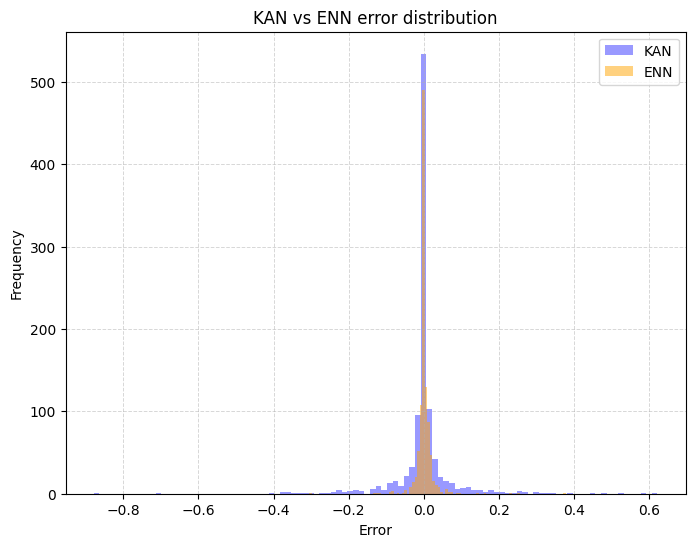

In [ ]:
# Plot histograms
plt.figure(figsize=(8, 6))
plt.grid(True, linestyle='--', linewidth=0.7,  alpha = 0.5)
plt.hist(kan_error, bins=100, alpha=0.4, label='KAN', color='blue')
plt.hist(enn_error, bins=100, alpha=0.5, label='ENN', color='orange')

# Add labels, title, and legend
plt.xlabel('Error')
plt.ylabel('Frequency')
plt.title('KAN vs ENN error distribution')
plt.legend()

# Show the plot
plt.show()

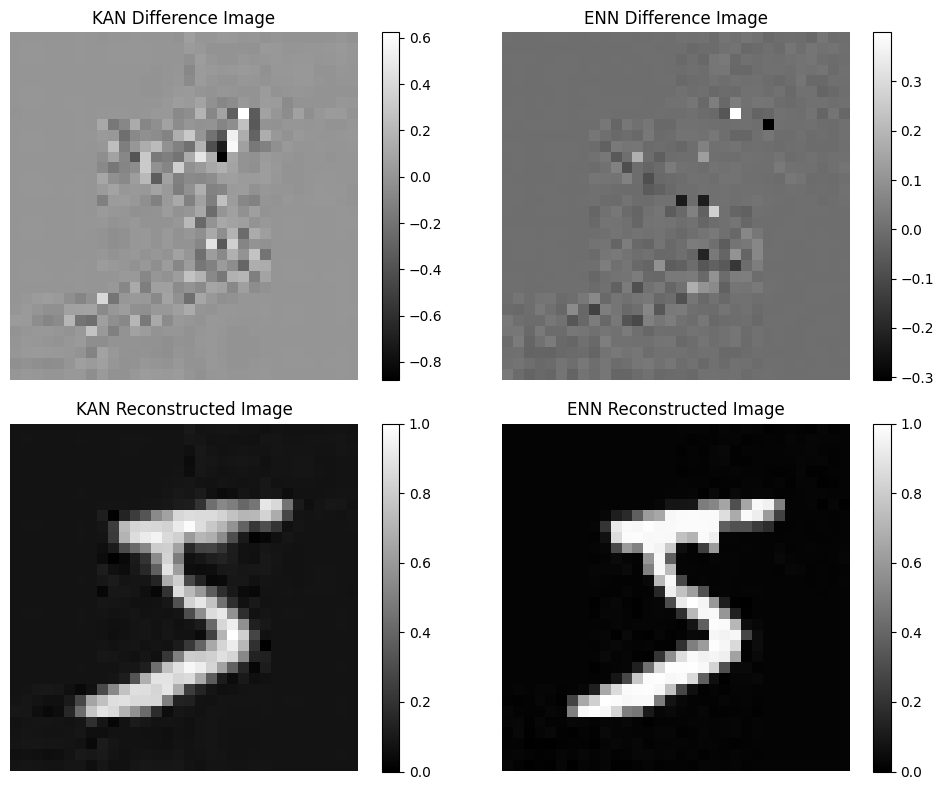

In [ ]:
import matplotlib.pyplot as plt

# Assuming you have two sets of images to compare:
# 'kan_difference', 'reconstructed_image_kan' for the left side
# 'comparison_diff_image', 'comparison_reconstructed_image' for the right side

# Create a 2x2 grid of subplots
fig, axes = plt.subplots(2, 2, figsize=(10, 8))

# First row: Difference images
cb = axes[0, 0].imshow(kan_difference, cmap='gray', vmin = kan_difference.min(), vmax = kan_difference.max())
axes[0, 0].set_title('KAN Difference Image')
axes[0, 0].axis('off')  # Optionally turn off the axis
fig.colorbar(cb, ax = axes[0,0])

cb = axes[0, 1].imshow(enn_difference, cmap='gray', vmin = enn_difference.min(), vmax = enn_difference.max())
axes[0, 1].set_title('ENN Difference Image')
axes[0, 1].axis('off')  # Optionally turn off the axis
fig.colorbar(cb, ax=axes[0, 1])

# Second row: Reconstructed images
axes[1, 0].imshow(reconstructed_image_kan, cmap='gray')
axes[1, 0].set_title('KAN Reconstructed Image')
axes[1, 0].axis('off')  # Optionally turn off the axis
fig.colorbar(plt.cm.ScalarMappable(cmap='gray'), ax=axes[1, 0])

axes[1, 1].imshow(reconstructed_image_enn, cmap='gray')
axes[1, 1].set_title('ENN Reconstructed Image')
axes[1, 1].axis('off')  # Optionally turn off the axis
fig.colorbar(plt.cm.ScalarMappable(cmap='gray'), ax=axes[1, 1])

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the final figure
plt.show()


In [ ]:
n_input = 2        # Number of input variables
function = 33       # Select function
width = 3         # Number of neurons in the hidden layer
n_train = 200000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples
batch = 60
grid = 2
k = 3

data_train = Dataset(n_train, function, imgscale=0.016,  torchTensor = True)
data_test = Dataset(n_test, function, imgscale=0.016, torchTensor = True)
error_train=[]
my_ds= {"train_input":data_train.x.T,
          "test_input":data_test.x.T,
          "train_label":data_train.y.reshape(-1,1),
          "test_label":data_test.y.reshape(-1,1)}

kan_model = KAN(width=[n_input, width, 1], grid=grid, k=k, seed=0)
output = kan_model.fit(my_ds, opt = 'Adam', steps=int(n_train/batch), batch =batch, lamb=0, lamb_entropy=0, lamb_coef=0, lamb_l1=0,lamb_coefdiff=0, lr=0.001);


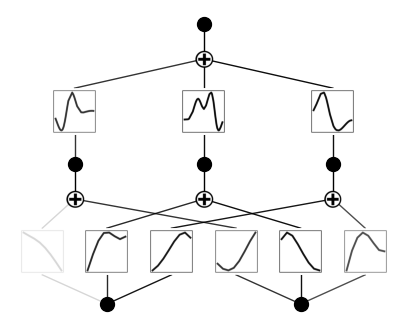

In [ ]:
kan_model.plot()

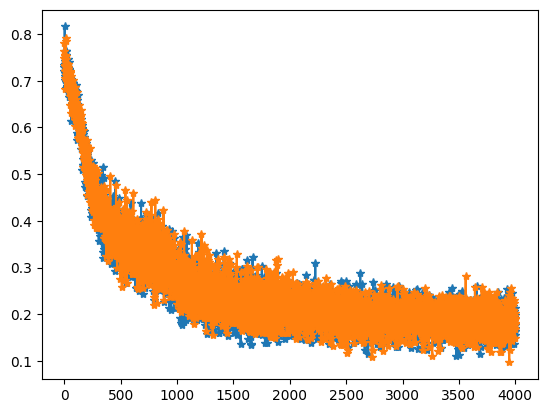

In [ ]:
plt.plot(output['train_loss'][:], '-*')
plt.plot(output['test_loss'][:], '-*')

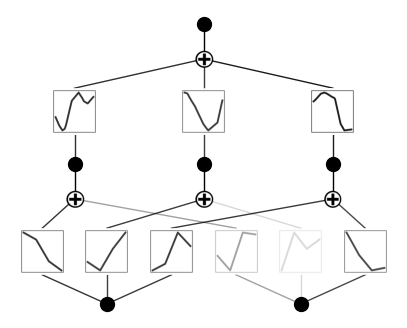

In [ ]:
kan_model.plot()

#### KAN simulations on the MNIST

In [64]:
n_input = 2        # Number of input variables
function = 34       # Select function
n_train = 200000   # Number of training samples. You can also try with 10.000 samples, alpha_W_hid=0.01 and alpha_F_hid = 0.005
n_test = 50000     # Number of test samples
batch = 60

#KAN parameters
width = 2         # Number of neurons in the hidden layer
grid = 2
k = 3

#Simulation parameters
start_sample = 0
simulation_size = 30
block_size = 8
last = time.time()

if not os.path.exists(f'Width_{width}'):
    os.makedirs(f'Width_{width}')
if not os.path.exists(f'Width_{width}/grid_{grid}_k_{k}'):
    os.makedirs(f'Width_{width}/grid_{grid}_k_{k}')


for h in range(start_sample, simulation_size):
  #Get and preprocess image
  image, label = mnist_train[h]
  image = preprocess_img(np.array(image))
  img_height, img_width = image.shape

  #Logs
  time_taken = round((time.time()-last)/60, 2)
  clear_output()
  print(f'Processing image {h}/{simulation_size}. Time taken by the last image {time_taken}')
  last = time.time()


  image_blocks = []
  predicted_image_blocks = []
  mse_per_block = []
  loss_per_block  = []
  nmse_per_block = []

  for i in range(0, img_height, block_size):
    for j in range(0, img_width, block_size):
      # Extract the current block
      block = image[i:i + block_size, j:j + block_size]
      image_blocks.append(block)

      data_train = Dataset(n_train, function, x0=0.45, input_image=block, torchTensor = True)
      data_test = Dataset(n_test, function, x0=0.65, input_image=block, torchTensor = True)

      my_ds= {"train_input":data_train.x.T,
                "test_input":data_test.x.T,
                "train_label":data_train.y.reshape(-1,1),
                "test_label":data_test.y.reshape(-1,1)}

      kan_model = KAN(width=[n_input, width, 1], grid=grid, k=k, seed=0)
      output = kan_model.fit(my_ds, opt="Adam", steps=int(n_train/batch), batch=batch, lamb=0, lamb_entropy=0, lamb_coef=0, lamb_l1=0,lamb_coefdiff=0, lr=0.001);

      loss=output['train_loss']
      loss_per_block.append(loss)

      x = np.array(list(set(data_test.x.numpy()[0,:])))
      x.sort()
      y = np.array(list(set(data_test.x.numpy()[1,:])))
      y.sort()
      predicted_block = np.zeros((block_size,block_size))

      block_mse = 0.0

      for a in range(len(x)):
        for b in range(len(y)):
          x_in = np.array([x[a], y[b]])
          prediction = kan_model.forward(torch.from_numpy(x_in).reshape(1,-1)).detach().numpy()
          predicted_block[a,b] = prediction[0,0]
          error = block[a,b] - prediction[0,0]
          block_mse += error**2
      block_mse = block_mse/(len(x)*len(y))

      mse_per_block.append(block_mse)
      nmse_per_block.append(block_mse/np.mean(block.flatten()**2 + 1e-10))
      predicted_image_blocks.append(predicted_block)
  np.save(f'Width_{width}/grid_{grid}_k_{k}/MSE_per_block_{h}.npy',np.array(mse_per_block))
  np.save(f'Width_{width}/grid_{grid}_k_{k}/loss_per_block_{h}.npy',np.array(loss_per_block))
  np.save(f'Width_{width}/grid_{grid}_k_{k}/predicted_image_{h}.npy',reconstruct_image_from_array(predicted_image_blocks))
  np.save(f'Width_{width}/grid_{grid}_k_{k}/original_image_{h}.npy',image)
  np.save(f'Width_{width}/grid_{grid}_k_{k}/NMSE_per_block_{h}.npy',np.array(nmse_per_block))


Processing image 0/30. Time taken by the last image 0.0
checkpoint directory created: ./model
saving model version 0.0


| train_loss: 9.22e-01 | test_loss: 9.24e-01 | reg: 0.00e+00 | :   0%| | 13/3333 [00:00<03:06, 17.80


KeyboardInterrupt: 

#### MLP

In [19]:
function = 34
n_train = 200000
n_test = 2000
lr = 0.001

mse_per_block = []
mnist_image = np.array(mnist_image)
image = preprocess_img(np.array(mnist_image))
img_height, img_width = image.shape
block_size = 8
image_blocks = []
predicted_image_blocks = []
error_train = []
error_per_block = []

for i in range(0, img_height, block_size):
  print(f'Processing block {i/8 +1}')
  for j in range(0, img_width, block_size):
    # Extract the current block
    block = image[i:i + block_size, j:j + block_size]
    image_blocks.append(block)

    train_dataset = CustomDataset(n_train, function, input_image = block)
    train_loader = torch.utils.data.DataLoader(dataset=train_dataset,
                                              batch_size=1)

    mlp = MLP_Regression(input_dim = 2, hidden_dim=20, output_dim=1)
    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(mlp.parameters(), lr=lr)
    error_train.append(mlp.train(train_loader, criterion, optimizer))

    data_test = Dataset(n_test, function, input_image = block)#8x8 image

    x = np.array(list(set(data_test.x[0,:])))
    x.sort()
    y = np.array(list(set(data_test.x[1,:])))
    y.sort()
    predicted_block = np.zeros((block_size,block_size))

    block_error = 0.0

    for a in range(len(x)):
      for b in range(len(y)):
        with torch.no_grad():
          x_in = np.array([x[a], y[b]], dtype = np.float32)
          prediction = mlp(torch.from_numpy(x_in))
          predicted_block[a,b] = prediction[0]
          block_error += (prediction - block[a,b])**2
    block_error = block_error/(len(x)*len(y))

    error_per_block.append(block_error[0])
    predicted_image_blocks.append(predicted_block)



NameError: name 'mnist_image' is not defined

In [ ]:
get_num_of_paramters(mlp)

81

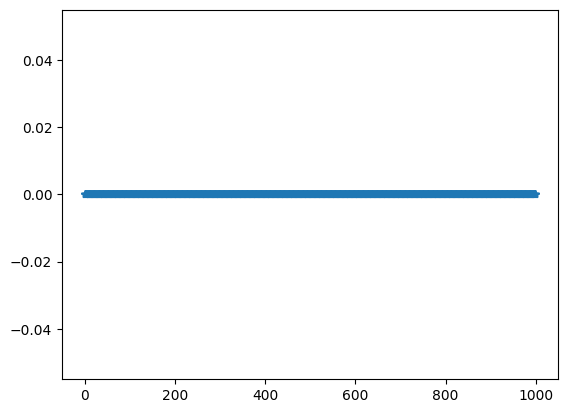

In [ ]:
plt.plot(error_train[-1][-1000:], '-*')

In [ ]:
np.mean(error_per_block)

0.007348366

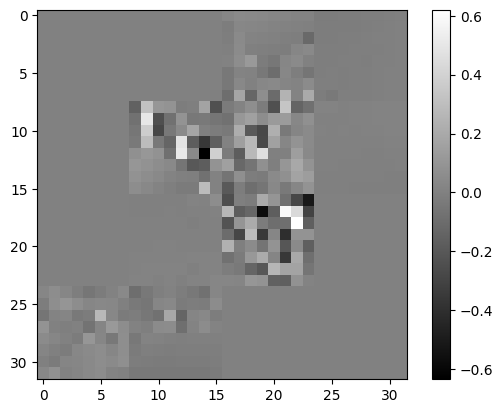

In [ ]:
plt.imshow(reconstruct_image_from_array(predicted_image_blocks)-image, cmap = 'gray')
plt.colorbar()

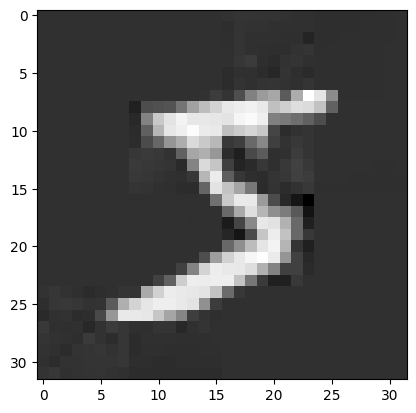

In [ ]:
plt.imshow(reconstruct_image_from_array(predicted_image_blocks), cmap = 'gray')

#### Fourier activation function

In [ ]:
function = 34
n_train = 200000
n_test = 2000
lr = 0.001

mse_per_block = []
mnist_image = np.array(mnist_image)
image = preprocess_img(np.array(mnist_image))
img_height, img_width = image.shape
block_size = 8
image_blocks = []
predicted_image_blocks = []
error_train = []
error_per_block = []

for i in range(0, img_height, block_size):
  print(f'Processing block {i/8 +1}')
  for j in range(0, img_width, block_size):
    # Extract the current block
    block = image[i:i + block_size, j:j + block_size]
    image_blocks.append(block)

    train_dataset = CustomDataset(n_train, function, input_image = block)
    train_loader = torch.utils.data.DataLoader(dataset=train_dataset,
                                              batch_size=1)

    fourier_model = Fourier(input_dim = 2, hidden_dim=4, n_coeffs = 3, output_dim=1, init = True)
    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(fourier_model.parameters(), lr=lr)
    error_train.append(fourier_model.train(train_loader, criterion, optimizer))

    data_test = Dataset(n_test, function, input_image = block)#8x8 image

    x = np.array(list(set(data_test.x[0,:])))
    x.sort()
    y = np.array(list(set(data_test.x[1,:])))
    y.sort()
    predicted_block = np.zeros((block_size,block_size))

    block_error = 0.0

    for a in range(len(x)):
      for b in range(len(y)):
        with torch.no_grad():
          x_in = np.array([x[a], y[b]], dtype = np.float32)
          prediction = fourier_model.forward(torch.from_numpy(x_in))
          predicted_block[a,b] = prediction[0]
          block_error += (prediction - block[a,b])**2
    block_error = block_error/(len(x)*len(y))

    error_per_block.append(block_error[0])
    predicted_image_blocks.append(predicted_block)



Processing block 1.0
Processing block 2.0
Processing block 3.0
Processing block 4.0


In [94]:
get_num_of_paramters(fourier_model)

62

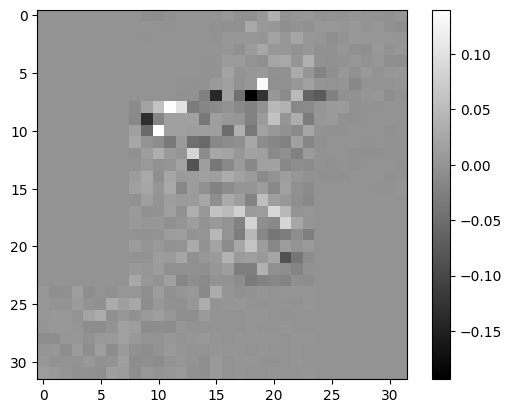

In [88]:
plt.imshow(reconstruct_image_from_array(predicted_image_blocks)-image, cmap = 'gray')
plt.colorbar()

In [90]:
np.mean(error_per_block)

0.00033944353

### **Old main**

['Shows the last ', 200, ' samples of output,reference and error in Fig.42']


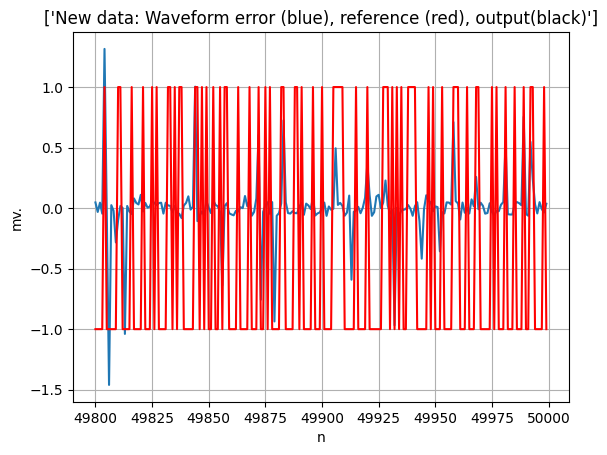

In [ ]:
# Define number of input variables
nvar = 2
# Define resolution for plots of NLC response
nft = 512
# Select function
isele = 11
# Number of samples available
nlea = 800000
# Number of neurons in the hidden layer
width = 6
# Number of DCT coefficients per neuron
n_coeffs = 6


# Generate reference at random with uniform distribution (-1,1)
xin, yref = generate_data(nlea, isele)

W, F, W_out, F_out, Q, Q_out, pat, pat11_ = initialize(2, width, nft, n_coeffs)

# # Define order of the NLC, even number
# lindi_max = 12
# indi11 = np.arange(2, lindi_max+1, 2)
# lindi11 = len(indi11)

# # Define initial coefficients neuron
# cava=np.array([-207.6068,-23.1526,-8.3292,-4.2629,-2.5883,-1.5147])*(2/nft);
# print('linear12');

# coev11 = cava;
# lcoe11 = lindi11;

# # Seleccion de coeficientes DCT. The same for all the perceptrons.
# indi21  = np.arange(2, lindi_max+1, 2)
# lindi21 = len(indi21);
# indi22  = np.arange(2, lindi_max+1, 2)
# lindi22 = len(indi22);
# indi23  = np.arange(2, lindi_max+1, 2)
# lindi23 = len(indi23);
# indi24  = np.arange(2, lindi_max+1, 2)
# lindi24 = len(indi24);
# indi25  = np.arange(2, lindi_max+1, 2)
# lindi25 = len(indi25);
# indi26  = np.arange(2, lindi_max+1, 2)
# lindi26 = len(indi26);
# # Initial coeficients. The same for all the perceptrons.
# coev21=cava;lcoe21=lindi11;coev22=cava;lcoe22=lindi11;
# coev23=cava;lcoe23=lindi11;coev24=cava;lcoe24=lindi11;
# coev25=cava;lcoe25=lindi11;coev26=cava;lcoe26=lindi11;

# F_out = cava[...,None] #F_out.shape=(6,1) with a unique neuron and 6 non-linear coeffs
# Q_out = indi11[...,None] #Q_out.shape=(6,1) with a unique neuron and 6 indices for the non-linear coeffs
# F = np.tile(cava,(6,1)).T #F.shape=(6,6) with F[:,i] as the non-linear coeffs of the i-th neuron
# Q = np.tile(indi21, (6,1)).T #Q.shape=(6,6) with Q[:,i] as the indeces of the non-linear coeffs of the i-th neuron




# Random or deterministic initial coefficientes
# Define intial dynamic range
# gam = 0.5;
# coel11 = gam*np.array([0, 1, -1, 1, -1, 1, -1], ndmin=2); #coel11=[0;gam*(rand(6,1)-0.5*ones(6,1))] for random
# coel21 = gam*np.array([0, 1, 0], ndmin=2);
# coel22 = gam*np.array([0, 0, 1], ndmin=2);
# coel23 = gam*np.array([0, np.cos(np.pi/6), np.sin(np.pi/6)], ndmin=2);
# coel24 = gam*np.array([0, -np.sin(np.pi/6), np.cos(np.pi/6)], ndmin=2);
# coel25 = gam*np.array([0, np.cos(2*np.pi/6), np.sin(2*np.pi/6)], ndmin=2);
# coel26 = gam*np.array([0, -np.sin(2*np.pi/6), np.cos(2*np.pi/6)], ndmin=2);

# W_out = coel11.T #W.shape=(7,1) with only one neuron and 7 linear weights
# W = np.concatenate((coel21,coel22,coel23,coel24,coel25,coel26), axis=0).T #W.shape=(3,6) with W[:,i] as the linear weights of the i-th neuron
#W_out_ = coel11.T #W.shape=(7,1) with only one neuron and 7 linear weights
#W_ = np.concatenate((coel21,coel22,coel23,coel24,coel25,coel26), axis=0).T #W.shape=(3,6) with W[:,i] as the linear weights of the i-th neuron

#Remove these lines when all is vectorized
# coel11 = gam*np.array([0, 1, -1, 1, -1, 1, -1]); #coel11=[0;gam*(rand(6,1)-0.5*ones(6,1))] for random
# coel21 = gam*np.array([0, 1, 0]);
# coel22 = gam*np.array([0, 0, 1]);
# coel23 = gam*np.array([0, np.cos(np.pi/6), np.sin(np.pi/6)]);
# coel24 = gam*np.array([0, -np.sin(np.pi/6), np.cos(np.pi/6)]);
# coel25 = gam*np.array([0, np.cos(2*np.pi/6), np.sin(2*np.pi/6)]);
# coel26 = gam*np.array([0, -np.sin(2*np.pi/6), np.cos(2*np.pi/6)]);

# # Compute length of linear combiners
# lcoel11=len(coel11);lcoel21=len(coel21);lcoel22=len(coel22);
# lcoel23=len(coel23);lcoel24=len(coel24);lcoel25=len(coel25);
# lcoel26=len(coel26);
# coeli=coev11;

# # Generate reference yref
# yref=np.zeros((nlea));
# print('Generate reference data for training');
# # Control il for the command window at nstopr
# nstopr=nlea/5;
# # Reference generation loop
# for il in range(nlea):
#     if il-nstopr*round(il/nstopr)==0:
#         print(il);
#     # Generate reference for each selection
#     a1=1;a2=-1;
#     # Classifier
#     if isele<9:
#         if isele==1:  # Linear discriminant
#             gamma1=-0.4;gamma2=-0.3;
#             if xin[0,il]>gamma1*xin[1,il]+gamma2:
#                 yref[il]=a1;
#             else:
#                 yref[il]=-a1;
#         elif isele==2:  # Linear discriminant
#             gamma1=2;gamma2=0.5;
#             if xin[0,il]>gamma1*xin[1,il]+gamma2:
#                 yref[il]=a1;
#             else:
#                 yref[il]=-a1;
#         elif isele==3:  # Linear discriminant
#             gamma1=1;gamma2=0;
#             if xin[0,il]>gamma1*xin[1,il]+gamma2:
#                 yref[il]=a1;
#             else:
#                 yref[il]=-a1;
#         elif isele==4:  # Linear discriminant
#             if xin[0,il]>0:
#                 yref[il]=a1;
#             else:
#                 yref[il]=-a1;
#         elif isele==5:  # Ring or face
#             rad2=0.65**2;rad3=0.3**2;x1=0;x2=-0.2;y1=x1;y2=x2;
#             guso =((xin[0,il]-x1)**2)+((xin[1,il]-x2)**2);
#             guso2=((xin[0,il]-y1)**2)+((xin[1,il]-y2)**2);
#             if guso>rad2:
#                 yref[il]=-a1;
#                 # Dos circulos arriba (cara): icirc=1
#                 icirc=1;
#                 if icirc==1:
#                     rad4=0.2;x4=-0.35;x5=0.7;
#                     gusoi=((xin[0,il]-x4)**2)+((xin[1,il]-x5)**2);
#                     gusod=((xin[0,il]+x4)**2)+((xin[1,il]-x5)**2);
#                     if gusoi<rad4**2:
#                         yref[il]=a1;
#                     if gusod<rad4**2:
#                         yref[il]=a1;
#             else:
#                 yref[il]=a1;
#                 # Two circles with the same center
#                 if guso2<rad3:
#                     yref[il]=-a1;
#         elif isele==6:  # Quadratic discriminant
#             guso=0.1-0.2*xin[1,il]+(0.3*xin[1,il]**2);
#             if xin[0,il]>guso:
#                 yref[il]=a1;
#             else:
#                 yref[il]=-a1;
#         elif isele==7:  # Cubic discriminant, sine and stripes
#             #guso=0.1+(0.2*(xin(2,il)^2))-(0.3*(xin(2,il)^3));
#             #guso=0.1 + 5*( 5*((xin(2,il)-0.2)^3) - (xin(2,il)-0.2) );
#             guso=300*np.sin( 10*(xin[1,il]+0.15) );
#             if xin[0,il]>guso:
#                 yref[il]=a1;
#             else:
#                 yref[il]=-a1;
#         elif isele==8:  # Cirlce and ellipse
#             rad3=0.35**2;rado1=0.3;rado2=0.45;rado3=-0.3;rado4=-0.4;
#             exce1=2;exce2=1;
#             guso=(((xin[0,il]-rado1)/exce1)**2)+(((xin[1,il]-rado2)/exce2)**2);
#             gusa=((xin[0,il]-rado3)**2)+((xin[1,il]-rado4)**2);
#             yref[il]=-a1;
#             if guso<rad3:
#                 yref[il]=a1;
#             elif gusa<rad3:
#                 yref[il]=a1;
#     #Neuromorhpic
#     elif isele==9:
#         yref[il]=(xin[0,il]+xin[1,il])/2;
#     elif isele==10:
#         yref[il]=(xin[0,il]**2+xin[1,il]**2)/4;
#     elif isele==11:
#         yref[il]=xin[0,il]*xin[1,il];


# Axis for plots ndix
andix = np.linspace(-1,1,nft+1)
ndix=andix[:nft]
# Initial output error
err_sal11=np.zeros((nlea));
# Initial variables
ysol11=np.zeros((nlea));
# ysol21=np.zeros((nlea));
# ysol22=np.zeros((nlea));
# ysol23=np.zeros((nlea));
# ysol24=np.zeros((nlea));
# ysol25=np.zeros((nlea));
# ysol26=np.zeros((nlea));
#xing=np.zeros((6,nlea));
# Initial power linear combiners snapshot
# pow11=1;
# pow21=1;
# pow22=1;
# pow23=1;
# pow24=1;
# pow25=1;
# pow26=1;
# pat11_ = pow11;
# pat = np.array([[pow21,pow22,pow23,pow24,pow25,pow26]])
#W_out_ = coel11.T #W.shape=(7,1) with only one neuron and 7 linear weights
#W_ = np.concatenate((coel21,coel22,coel23,coel24,coel25,coel26), axis=0).T #W.shape=(3,6) with W[:,i] as the linear weights of the i-th neuron
#F_out_ = cava[...,None]
#F_ = np.tile(cava,(6,1)).T


W, F, W_out, F_out, err = train(xin, yref, W, F, W_out, F_out, Q, Q_out, pat, pat11_, nft, 0.001, 0.0005, 0.0001, 0.00005, 0.999)

# # Control loop of learning in the command window
# nstopl=nlea/5;
# # Sequential learning
# iact=1; # Learning secuencial
# print('Training of the net');

# for il in range(nlea):
#     kuso=il-nstopl*np.round(il/nstopl);
#     if kuso==0:
#         print(il);
#     # Start processing
#     #---- Compute global error with initial set of coefficients
#     #---- Input layer Neuron input xin[:,il]
#     #---- Hidden layer Neurons: 21(3) 22(3) 23(3) 24(3) 25(3) 26(3)
#     xing[:,il], _ = percep_lag_pro(xin[:,[il]], yref[il], F, W, Q, nft)
#     # i_net=21;
#     # aux1, _ = percep_lag_pro261(xin[:,il],yref[il],coev21,coel21,indi21,lindi21,nft,i_net,isele);
#     # i_net=22;
#     # aux2, _ = percep_lag_pro261(xin[:,il],yref[il],coev22,coel22,indi22,lindi22,nft,i_net,isele);
#     # i_net=23;
#     # aux3, _ = percep_lag_pro261(xin[:,il],yref[il],coev23,coel23,indi23,lindi23,nft,i_net,isele);
#     # i_net=24;
#     # aux4, _ = percep_lag_pro261(xin[:,il],yref[il],coev24,coel24,indi24,lindi24,nft,i_net,isele);
#     # i_net=25;
#     # aux5, _ = percep_lag_pro261(xin[:,il],yref[il],coev25,coel25,indi25,lindi25,nft,i_net,isele);
#     # i_net=26;
#     # aux6, _ = percep_lag_pro261(xin[:,il],yref[il],coev26,coel26,indi26,lindi26,nft,i_net,isele);
#     # #snapshot for the ouput perceptron
#     # aux7=np.array([aux1,aux2,aux3,aux4,aux5,aux6]);
#     # print('vec: ', xing[:,il])
#     # print('MAL: ', aux7)
#     #---- Output layer Neuron 11
#     # i_net=11;iref=1;
#     # aux8, aux9 = percep_lag_pro261(xing[:,il],yref[il],coev11,coel11,indi11,lindi11,nft,i_net,isele);
#     ysol11[il], err_sal11[il] = percep_lag_pro(xing[:,[il]], yref[il], F_out, W_out, Q_out, nft) #Transposed o/w it doesn't work. Need to check
#     # print('vec: ', ysol11[il])
#     # print('MAL: ', aux8)
#     # print('vec: ', err_sal11[il])
#     # print('MAL: ', aux9)

#     # Start Learning
#     # Threshold for sequential learning of layer hidden and output
#     # if il<umbral1 neuron 11 learn, for il>umbral2 hidden learns
#     #umbral1=nlea+1;umbral2=-1;
#     #print(il)
#     # # Output layer neuron: 11(5+1) (layer, neuron, inputs)
#     #if il<umbral1:
#         # i_net=11;pat11=pow11;
#         # coevn11,coeln11,xsnalp11,pat11 = percep_lag_lea261(xing[:,il],err_sal11[il],np.zeros((lcoe11)),coev11,coel11,indi11,lindi11,nft,pat11,i_net,il,nlea);
#         # pow11=pat11;coev11=coevn11;coel11=coeln11;
#     # # Hidden layer neurons 21 22 23 24 25 26 (2+1) (layer,neuron,inputs)
#     #if il>umbral2:
#         # i_net=21;pat21=pow21;
#         # coevn21,coeln21,xsnalp21,pat21=percep_lag_lea261(xin[:,il],err_sal11[il],xsnalp11[1],coev21,coel21,indi21,lindi21,nft,pat21,i_net,il,nlea);
#         # pow21=pat21;coev21=coevn21;coel21=coeln21;

#         # i_net=22;pat22=pow22;
#         # coevn22,coeln22,xsnalp22,pat22=percep_lag_lea261(xin[:,il],err_sal11[il],xsnalp11[2],coev22,coel22,indi22,lindi22,nft,pat22,i_net,il,nlea);
#         # pow22=pat22;coev22=coevn22;coel22=coeln22;

#         # i_net=23;pat23=pow23;
#         # coevn23,coeln23,xsnalp23,pat23=percep_lag_lea261(xin[:,il],err_sal11[il],xsnalp11[3],coev23,coel23,indi23,lindi23,nft,pat23,i_net,il,nlea);
#         # pow23=pat23;coev23=coevn23;coel23=coeln23;

#         # i_net=24;pat24=pow24;
#         # coevn24,coeln24,xsnalp24,pat24=percep_lag_lea261(xin[:,il],err_sal11[il],xsnalp11[4],coev24,coel24,indi24,lindi24,nft,pat24,i_net,il,nlea);
#         # pow24=pat24;coev24=coevn24;coel24=coeln24;

#         # i_net=25;pat25=pow25;
#         # coevn25,coeln25,xsnalp25,pat25=percep_lag_lea261(xin[:,il],err_sal11[il],xsnalp11[5],coev25,coel25,indi25,lindi25,nft,pat25,i_net,il,nlea);
#         # pow25=pat25;coev25=coevn25;coel25=coeln25;

#         # i_net=26;pat26=pow26;
#         # coevn26,coeln26,xsnalp26,pat26=percep_lag_lea261(xin[:,il],err_sal11[il],xsnalp11[6],coev26,coel26,indi26,lindi26,nft,pat26,i_net,il,nlea);
#         # pow26=pat26;coev26=coevn26;coel26=coeln26;

#         #New code
#         #pat2 = np.array([pat21,pat22,pat23,pat24,pat25,pat26])
#     F_out,W_out,xsnalp11_,pat11_ = percep_lag_lea(xing[:,[il]], err_sal11[il], np.zeros((6)), F_out, W_out, Q_out, nft, pat11_, 0.0001, 0.00005, 1, 0.999)
#     F,W,xsnalp21_,pat = percep_lag_lea(xin[:,[il]], err_sal11[il], xsnalp11_[1:,:].T, F, W, Q, nft, pat, 0.001, 0.0005, 1, 0.999)
#         # print(coevn21, coevn22, coevn23, coevn24, coevn25, coevn26)
#         # print(coevn21_)
#         # print(coeln21, coeln22, coeln23, coeln24, coeln25, coeln26)
#         # print(coeln21_)
#         # print(xsnalp21,xsnalp22,xsnalp23,xsnalp24,xsnalp25,xsnalp26)
#         # print(xsnalp21_)
#         # print(pat2)
#         # print(pat21_)

#         #Update matrices for the following forward pass
#         #print(W_out.shape)
#         #W_out_ = coel11[...,None] #W.shape=(7,1) with only one neuron and 7 linear weights
#         #W_out_=W_out
#         # print(W_out.shape)
#         # print(W.shape)
#         #W_ = np.concatenate((coel21[...,None],coel22[...,None],coel23[...,None],coel24[...,None],coel25[...,None],coel26[...,None]), axis=1) #W.shape=(6,3) with W[i,:] as the linear weights of the i-th neuron
#         #W_=W
#         # print(W.shape)
#         # print(F_out.shape)
#         #F_out_ = coev11[...,None] #F_out.shape=(1,6) with a unique neuron and 6 non-linear coeffs
#         #F_out_=F_out
#         # print(F_out.shape)
#         # print(F.shape)
#         #F_ = np.concatenate((coev21[...,None],coev22[...,None],coev23[...,None],coev24[...,None],coev25[...,None],coev26[...,None]), axis=1) #F.shape=(6,6) with F[i,:] as the non-linear coeffs of the i-th neuron
#         #F_=F
#         # print(F.shape)


#Remove later
coeln21 = W[:,0]
coeln22 = W[:,1]
coeln23 = W[:,2]
coeln24 = W[:,3]
coeln25 = W[:,4]
coeln26 = W[:,5]
coevn21 = F[:,0]
coevn22 = F[:,1]
coevn23 = F[:,2]
coevn24 = F[:,3]
coevn25 = F[:,4]
coevn26 = F[:,5]
coeln11 = W_out[:,0]
coevn11 = F_out[:,0]

# End of learning. Display the coefficients of every perceptron
s=[' Linear coeffcients...coel21 ', coeln21];print(s);
s=[' NLC coefficients.....coev21 ', coevn21];print(s);
s=[' Linear coeffcients...coel22 ', coeln22];print(s);
s=[' NLC coefficients.....coev22 ', coevn22];print(s);
s=[' Linear coeffcients...coel23 ', coeln23];print(s);
s=[' NLC coefficients.....coev23 ', coevn23];print(s);
s=[' Linear coeffcients...coel24 ', coeln24];print(s);
s=[' NLC coefficients.....coev24 ', coevn24];print(s);
s=[' Linear coeffcients...coel25 ', coeln25];print(s);
s=[' NLC coefficients.....coev25 ', coevn25];print(s);
s=[' Linear coeffcients...coel26 ', coeln26];print(s);
s=[' NLC coefficients.....coev26 ', coevn26];print(s);
s=[' Linear coeffcients...coel11 ', coeln11];print(s);
s=[' NLC coefficients.....coev11 ', coevn11];print(s);

# Display selected function
print('---Selected function---')
if isele==1:
    print('x1>0.4*x2-0.3');
elif isele==2:
    print('x1>2*x2+0.5');
elif isele==3:
    print('x1>x2');
elif isele==4:
    print('x2>0');
elif isele==5:
    print('x1^2+x2^2<=rad^2 concentric');
elif isele==6:
    print('x1>0.1-0.2 x2+0.3 x2^2');
elif isele==7:
    print('x1>0.1+0.2 x2^2 -0.3 x2^3');
elif isele==8:
    print('two separate clusters')
elif isele==9:
    print('(x1+x2)/2');
elif isele==10:
    print('(x1^2+x2^2)/4');
elif isele==11:
    print('x1*x2');

print('Plot the NLC response after learning (starts at figure 1)');
for i_uso in range(1,8):
    ydibu=np.zeros((nft));
    if i_uso==1:
        i_neuro=11;lindi=Q_out.shape[0];coevn=coevn11;indi=Q_out[:,0]
    elif i_uso==2:
        i_neuro=21;lindi=Q.shape[0];coevn=coevn21;indi=Q[:,0]
    elif i_uso==3:
        i_neuro=22;lindi=Q.shape[0];coevn=coevn22;indi=Q[:,1]
    elif i_uso==4:
        i_neuro=23;lindi=Q.shape[0];coevn=coevn23;indi=Q[:,2]
    elif i_uso==5:
        i_neuro=24;lindi=Q.shape[0];coevn=coevn24;indi=Q[:,3]
    elif i_uso==6:
        i_neuro=25;lindi=Q.shape[0];coevn=coevn25;indi=Q[:,4]
    elif i_uso==7:
        i_neuro=26;lindi=Q.shape[0];coevn=coevn26;indi=Q[:,5]
    # Compute graphic
    for i3 in range(nft):
        xuso=i3+1; #Plus one because the range starts at zero, and 1 in matlab
        for i2 in range(lindi):
            ydibu[i3]=ydibu[i3]+coevn[i2]*np.cos((np.pi/(2*nft))*(indi[i2]-1)*(2*xuso-1));
    plt.figure(i_uso);plt.clf();plt.plot(ndix,ydibu,'-b','LineWidth',4); plt.grid();
    plt.title(['Neuron ', i_neuro, ' NLC response']);


# Plot the error along the las nlast points
nlast=5000;
claroa=err*err;
lcla=len(claroa);
plt.figure(40);plt.clf();plt.plot(np.arange(1,lcla+1),claroa,'b');plt.title('Output error');
lini=nlea-nlast;lifi=nlea;
plt.figure(41);plt.clf;plt.plot(np.arange(lini,lifi),claroa[lini:lifi],'g');
plt.title(['output error:last ', nlast, ' samples']);

# Plot the response to the two variables
# Starts en figure l1f
l1f=30;ine=21;
for inesc in range(ine,ine+5+1):
    mind=0;
    if inesc==21:
        coe1=coeln21;coe2=coevn21;indi=Q[:,0];mind=1;
    elif inesc==22:
        coe1=coeln22;coe2=coevn22;indi=Q[:,1];mind=1;
    elif inesc==23:
        coe1=coeln23;coe2=coevn23;indi=Q[:,2];mind=1;
    elif inesc==24:
        coe1=coeln24;coe2=coevn24;indi=Q[:,3];mind=1;
    elif inesc==25:
        coe1=coeln25;coe2=coevn25;indi=Q[:,4];mind=1;
    elif inesc==26:
        coe1=coeln26;coe2=coevn26;indi=Q[:,5];mind=1;
    if mind==1:
        lindi=len(coe2);
        xsna=np.zeros((lindi));x=np.linspace(-1,1,201);
        y=x;ndib=len(x);z=np.zeros((ndib,ndib));
        for i in range(ndib):
            for j in range(ndib):
                auso=coe1[0]+coe1[1]*x[i]+coe1[2]*y[j];
                xuso=((auso+1)/2)*nft;
                for ij in range(lindi):
                    xsna[ij]=np.cos((np.pi/(2*nft))*(indi[ij]-1)*(2*xuso-1));
                z[i,j]=np.dot(coe2,xsna);
        fig,_ = plt.figure(l1f),plt.clf();
        ax = fig.add_subplot(111, projection='3d')
        X,Y = np.meshgrid(x,y);
        ax.plot_surface(X, Y, z)
        plt.xlabel('x1');plt.ylabel('x2');#plt.zlabel('x(x1,x2)');
        plt.title(['Neuron ', inesc, ' Bump view']);
        #pause(1);
        l1f=l1f+1;


# Test response 3D of the arquitecture
itest=1;
if itest==1:
    xp=np.linspace(-1,1,101);xq=xp;lx=len(xp);zp=np.zeros((lx,lx));
    print('Plot response of the global net');
    for i in range(lx):
        for j in range(lx):
            xini=np.array([xp[i],xq[j]]);
            # i_ne=21;
            # ysola1,_ = percep_lag_pro261(xini,yref,coev21,coel21,indi21,lindi21,nft,i_ne,isele);
            # i_ne=22;
            # ysola2,_ = percep_lag_pro261(xini,yref,coev22,coel22,indi22,lindi22,nft,i_ne,isele);
            # i_ne=23;
            # ysola3,_ = percep_lag_pro261(xini,yref,coev23,coel23,indi23,lindi23,nft,i_ne,isele);
            # i_ne=24;
            # ysola4,_ = percep_lag_pro261(xini,yref,coev24,coel24,indi24,lindi24,nft,i_ne,isele);
            # i_ne=25;
            # ysola5,_ = percep_lag_pro261(xini,yref,coev25,coel25,indi25,lindi25,nft,i_ne,isele);
            # i_ne=26;
            # ysola6,_ = percep_lag_pro261(xini,yref,coev26,coel26,indi26,lindi26,nft,i_ne,isele);
            # i_ne=11;
            # xing=np.array([ysola1,ysola2,ysola3,ysola4,ysola5,ysola6]);
            # zp[i,j],_ = percep_lag_pro261(xing,yref,coev11,coel11,indi11,lindi11,nft,i_ne,isele);

            xing, _ = percep_lag_pro(xini[...,None], 0, F, W, Q, nft)
            zp[i,j], _ = percep_lag_pro(xing, 0, F_out, W_out, Q_out, nft)


    fig, ax = plt.subplots(subplot_kw={"projection": "3d"})
    X,Y = np.meshgrid(xp,xq);
    surf = ax.plot_surface(X, Y, zp, cmap=cm.coolwarm,linewidth=0, antialiased=False)
    plt.xlabel('x2');plt.ylabel('x1');#plt.zlabel('x(x1,x2)');
    plt.title(['Global net response']);
    plt.show()


    if isele<12:
        fig,_ = plt.figure(21),plt.clf();
        cs = plt.contourf(xp,xq,zp,1, cmap ="hot")
        plt.axis('equal')
    else:
        fig,_ = plt.figure(21),plt.clf();
        cs = plt.contourf(xp,xq,zp,50, cmap ="hot")
        plt.axis('equal')


# Processing new data of the learned net
nleap=50000

# Plot mesh
#icol=0;
# Generate independent random input
#xin1=2*(np.random.rand(2,nleap)-0.5*np.ones((2,nleap)));
#xing = np.zeros((6,nleap))
#terr=0;ntopp=nleap/5;
print('Processing new data');
xin1, yref = generate_data(nleap, isele)

y_pred, error, metric = test(xin1, yref, W, F, W_out, F_out, Q, Q_out, nft, isele)

# for i in range(nleap):
#     if i-nstopp*round(i/nstopp)==0:
#         print(i);
# #     # Generate reference to control quality
# #     if isele==1:  # Linear discriminant
# #         if xin1[0,i]>gamma1*xin1[1,i]+gamma2:
# #             yref[i]=a1;
# #         else:
# #             yref[i]=-a1;
# #     elif isele==2:  # Linear discriminant
# #         if xin1[0,i]>gamma1*xin1[1,i]+gamma2:
# #             yref[i]=a1;
# #         else:
# #             yref[i]=-a1;
# #     elif isele==3:  # Linear discriminant
# #         if xin1[0,i]>gamma1*xin1[1,i]+gamma2:
# #             yref[i]=a1;
# #         else:
# #             yref[i]=-a1;
# #     elif isele==4:  # Linear discriminant
# #         if xin1[0,i]>0:
# #             yref[i]=a1;
# #         else:
# #             yref[i]=-a1;
# #     elif isele==5:  # Ring or face
# #         guso =((xin1[0,i]-x1)**2)+((xin1[1,i]-x2)**2);
# #         guso2=((xin1[0,i]-y1)**2)+((xin1[1,i]-y2)**2);
# #         if guso>rad2:
# #             yref[i]=-a1;
# #             # Dos circulos arriba (cara): icirc=1
# #             if icirc==1:
# #                 gusoi=((xin1[0,i]-x4)**2)+((xin1[1,i]-x5)**2);
# #                 gusod=((xin1[0,i]+x4)**2)+((xin1[1,i]-x5)**2);
# #                 if gusoi<rad4**2:
# #                     yref[i]=a1;
# #                 if gusod<rad4**2:
# #                     yref[i]=a1;
# #         else:
# #             yref[i]=a1;
# #             # Two circles with the same center
# #             if guso2<rad3:
# #                 yref[i]=-a1;
# #     elif isele==6:  # Quadratic discriminant
# #         if xin1[0,i]>0.1-0.2*xin1[1,i]+0.3*(xin1[1,i]**2):
# #             yref[i]=a1;
# #         else:
# #             yref[i]=-a1;
# #     elif isele==7:  # Cubic discriminant, sine and stripes
# #         #guso=0.1+(0.2*(xin(2,il)^2))-(0.3*(xin(2,il)^3));
# #         #guso=0.1 + 5*( 5*((xin(2,il)-0.2)^3) - (xin(2,il)-0.2) );
# #         guso=300*np.sin( 10*(xin1[1,i]+0.15) );
# #         if xin[0,i]>guso:
# #             yref[i]=a1;
# #         else:
# #             yref[i]=-a1;
# #     elif isele==8:  # Cirlce and ellipse
# #         guso=(((xin1[0,i]-rado1)/exce1)**2)+(((xin1[1,i]-rado2)/exce2)**2);
# #         gusa=((xin1[0,i]-rado3)**2)+((xin1[1,i]-rado4)**2);
# #         yref[i]=-a1;
# #         if guso<rad3:
# #             yref[i]=a1;
# #         elif gusa<rad3:
# #             yref[i]=a1;
# #     elif isele==9:
# #         yref[i]=(xin1[0,i]+xin1[1,i])/2;
# #     elif isele==10:
# #         yref[i]=((xin1[0,i]**2)+(xin1[1,i]**2))/4;
# #     elif isele==11:
# #         yref[i]=xin1[0,i]*xin1[1,i];

#     # # Use network
#     # i_net=21;
#     # ysol21[i],_ = percep_lag_pro261(xin1[:,i],yref[i],coev21,coel21,indi21,lindi21,nft,i_net,isele);
#     # i_net=22;
#     # ysol22[i],_ = percep_lag_pro261(xin1[:,i],yref[i],coev22,coel22,indi22,lindi22,nft,i_net,isele);
#     # i_net=23;
#     # ysol23[i],_ = percep_lag_pro261(xin1[:,i],yref[i],coev23,coel23,indi23,lindi23,nft,i_net,isele);
#     # i_net=24;
#     # ysol24[i],_ = percep_lag_pro261(xin1[:,i],yref[i],coev24,coel24,indi24,lindi24,nft,i_net,isele);
#     # i_net=25;
#     # ysol25[i],_ = percep_lag_pro261(xin1[:,i],yref[i],coev25,coel25,indi25,lindi25,nft,i_net,isele);
#     # i_net=26;
#     # ysol26[i],_ = percep_lag_pro261(xin1[:,i],yref[i],coev26,coel26,indi26,lindi26,nft,i_net,isele);
#     # # snapshot layer salida
#     # xing[:,i] = np.array([ysol21[i],ysol22[i],ysol23[i],ysol24[i],ysol25[i],ysol26[i]]);
#     # # Output layer Neuron 11
#     # i_net=11;iref=1;
#     # ysol11[i],err_sal11[i] = percep_lag_pro261(xing[:,i],yref[i],coev11,coel11,indi11,lindi11,nft,i_net,isele);

#     xing, _ = percep_lag_pro(xin1[:,[i]], yref[i], F, W, Q, nft)
#     ysol11[i],err_sal11[i] = percep_lag_pro(xing, yref[i], F_out, W_out, Q_out, nft)


#     if isele<12:
#         # Classifier
#         if ysol11[i]>0:
#             ysal[i]=1;
#         else:
#             ysal[i]=-1;
#         # Compute percentage of errors
#         err_sal=yref[i]-ysal[i];
#         if abs(err_sal)==0:
#             muso=1;
#         else:
#             terr=terr+1;
#     # Activate for mesh plot
#     # 'Print colour map of classification'
#     # 'Do not use for nleap greater than 25
#     # if icol==1:
#     #     zp=np.zeros((nleap,nleap));
#     #     xplo=round((nleap-1)*((xin1[0,i]+1)/2)+1);
#     #     yplo=round((nleap-1)*((xin1[1,i]+1)/2)+1);
#     #     zp[xplo,yplo]=ysal[i];

# Display error percentage for classifiers
if isele<12:
    s=['New data: Error rate.......... ', metric, '%']; print(s);
    # Plot decision map (missing code I will not use)

else:
    # Neuromorphic. Error histogram and MSE
    lhis=round(np.sqrt(nleap));
    s=[' MSE processing set... ', metric];print(s);
    plt.figure(23);plt.clf();plt.hist(error,lhis);plt.grid();
    plt.title('Error histogram');
    plt.xlabel('error value');
    plt.ylabel('# of values in cel');

# Choose last nlas samples
nlas=200;laso=nleap-nlas;nleao=nleap;xdi=np.arange(laso,nleao);
print(['Shows the last ', nlas, ' samples of output,reference and error in Fig.42']);
plt.figure(42);plt.clf();
plt.plot(xdi,error[laso:nleao])
plt.plot(xdi,yref[laso:nleao],'r')
plt.plot(xdi,y_pred[laso:nleao],'k')
plt.grid();
plt.xlabel('n');plt.ylabel('mv.');plt.title(['New data: Waveform error (blue), reference (red), output(black)']);
plt.show()

print('------- End of the program------');

Plot response of the global net


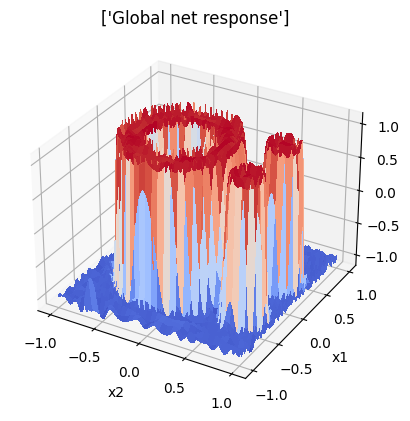

In [ ]:
itest=1;
if itest==1:
    xp=np.linspace(-1,1,101);xq=xp;lx=len(xp);zp=np.zeros((lx,lx));
    print('Plot response of the global net');
    for i in range(lx):
        for j in range(lx):
            xini=np.array([xp[i],xq[j]]);
            # i_ne=21;
            # ysola1,_ = percep_lag_pro261(xini,yref,coev21,coel21,indi21,lindi21,nft,i_ne,isele);
            # i_ne=22;
            # ysola2,_ = percep_lag_pro261(xini,yref,coev22,coel22,indi22,lindi22,nft,i_ne,isele);
            # i_ne=23;
            # ysola3,_ = percep_lag_pro261(xini,yref,coev23,coel23,indi23,lindi23,nft,i_ne,isele);
            # i_ne=24;
            # ysola4,_ = percep_lag_pro261(xini,yref,coev24,coel24,indi24,lindi24,nft,i_ne,isele);
            # i_ne=25;
            # ysola5,_ = percep_lag_pro261(xini,yref,coev25,coel25,indi25,lindi25,nft,i_ne,isele);
            # i_ne=26;
            # ysola6,_ = percep_lag_pro261(xini,yref,coev26,coel26,indi26,lindi26,nft,i_ne,isele);
            # i_ne=11;
            # xing=np.array([ysola1,ysola2,ysola3,ysola4,ysola5,ysola6]);
            # zp[i,j],_ = percep_lag_pro261(xing,yref,coev11,coel11,indi11,lindi11,nft,i_ne,isele);

            xing, _ = percep_lag_pro(xini[...,None], 0, F, W, Q, nft)
            #print(W_out[1:,:].T.shape, xing.shape)
            zp[i,j], _ = percep_lag_pro(xing.T, 0, F_out, W_out, Q_out, nft)
            #  percep_lag_pro(xing[:,[i]], y[i], F_out, W_out, Q_out, nft)


    fig, ax = plt.subplots(subplot_kw={"projection": "3d"})
    X,Y = np.meshgrid(xp,xq);
    surf = ax.plot_surface(X, Y, zp, cmap=cm.coolwarm,linewidth=0, antialiased=False)
    plt.xlabel('x2');plt.ylabel('x1');#plt.zlabel('x(x1,x2)');
    plt.title(['Global net response']);
    plt.show()

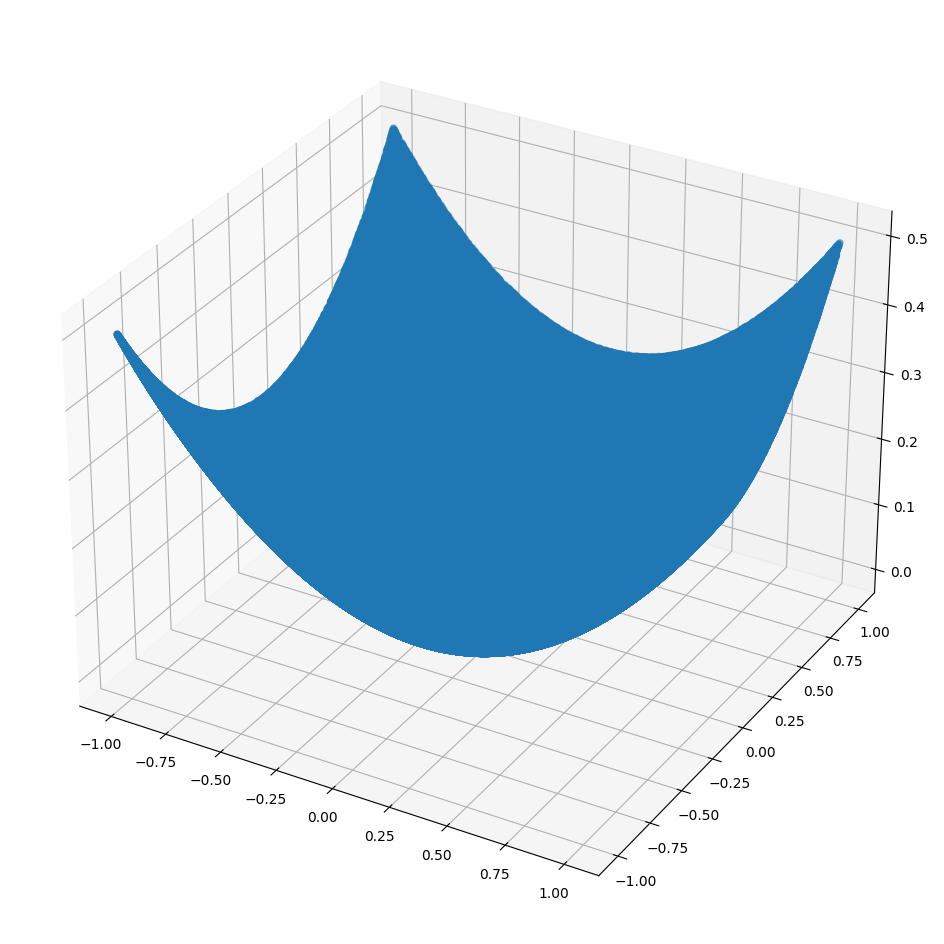

In [ ]:
fig = plt.figure(figsize=(12, 12))
ax = fig.add_subplot(projection='3d')
ax.scatter(xin[0,:], xin[1,:], yref)
plt.show()

Sample 0 / 800000
Sample 160000 / 800000
Sample 320000 / 800000
Sample 480000 / 800000
Sample 640000 / 800000
Sample 0 / 50000
Sample 10000 / 50000
Sample 20000 / 50000
Sample 30000 / 50000
Sample 40000 / 50000


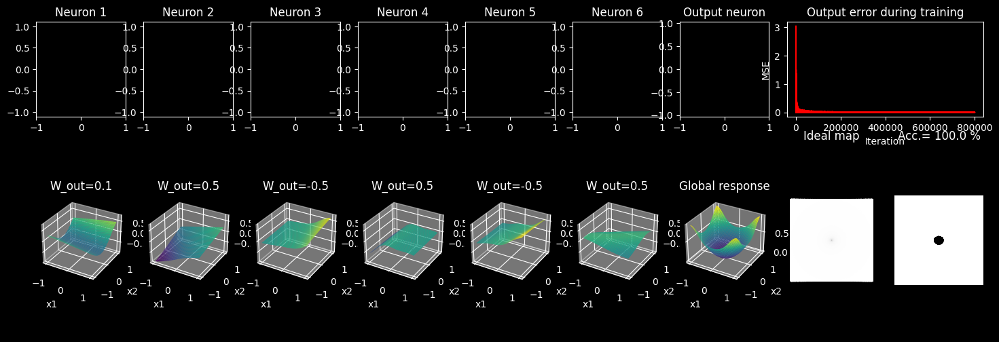

In [ ]:
# Define number of input variables
nvar = 2
# Define resolution for plots of NLC response
nft = 512
# Select function
isele = 13
# Number of samples available
nlea = 800000
# Number of neurons in the hidden layer
width = 6
# Number of DCT coefficients per neuron
n_coeffs = 6

#LMS parameters
alpha_W_hid = 0.001
alpha_F_hid = 0.0005
alpha_W_out = 0.0001
alpha_F_out = 0.00005
beta = 0.999
lms = LMS(alpha_F_hid, alpha_W_hid, alpha_F_out, alpha_W_out, beta)

# Generate reference at random with uniform distribution (-1,1)
#Create two variables: data_train and data_test
train_data = Dataset(nlea, isele)

#Initialize ENN
#W, F, W_out, F_out, Q, Q_out, pat, pat11_ = initialize(nvar, width, nft, n_coeffs)
enn = ENN(nvar, width, nft, n_coeffs)

# Axis for plots ndix
# andix = np.linspace(-1,1,nft+1)
# ndix=andix[:nft]

#Train network
#W, F, W_out, F_out, err = train(data, W, F, W_out, F_out, Q, Q_out, pat, pat11_, nft, 0.001, 0.0005, 0.0001, 0.00005, 0.999)

error_train = enn.train(train_data, lms)
# W = enn.W_hid
# F = enn.F_hid
# W_out = enn.W_out
# F_out = enn.F_out
# Q = enn.Q_hid
# Q_out = enn.Q_out
# pat = enn.p_hid
# pat11_ = enn.p_out

# # Plot NLC response
# for i_uso in range(1,8):
#     ydibu=np.zeros((nft));
#     if i_uso==1:
#         i_neuro=11;lindi=Q_out.shape[0];coevn=F_out[:,0];indi=Q_out[:,0]
#     elif i_uso==2:
#         i_neuro=21;lindi=Q.shape[0];coevn=F[:,0];indi=Q[:,0]
#     elif i_uso==3:
#         i_neuro=22;lindi=Q.shape[0];coevn=F[:,1];indi=Q[:,1]
#     elif i_uso==4:
#         i_neuro=23;lindi=Q.shape[0];coevn=F[:,2];indi=Q[:,2]
#     elif i_uso==5:
#         i_neuro=24;lindi=Q.shape[0];coevn=F[:,3];indi=Q[:,3]
#     elif i_uso==6:
#         i_neuro=25;lindi=Q.shape[0];coevn=F[:,4];indi=Q[:,4]
#     elif i_uso==7:
#         i_neuro=26;lindi=Q.shape[0];coevn=F[:,5];indi=Q[:,5]
#     # Compute graphic
#     for i3 in range(nft):
#         xuso=i3+1; #Plus one because the range starts at zero, and 1 in matlab
#         for i2 in range(lindi):
#             ydibu[i3]=ydibu[i3]+coevn[i2]*np.cos((np.pi/(2*nft))*(indi[i2]-1)*(2*xuso-1));
#     plt.figure(i_uso);plt.clf();plt.plot(ndix,ydibu,'-b','LineWidth',4); plt.grid();
#     plt.title(['Neuron ', i_neuro, ' NLC response']);

# Plot the error along the las nlast points
# nlast=5000;
# claroa=error_train**2
# lcla=len(claroa);
# plt.figure(40);plt.clf();plt.plot(np.arange(1,lcla+1),claroa,'b');plt.title('Output error');
# lini=nlea-nlast;lifi=nlea;
# print(lini,lifi,np.arange(lini,lifi).shape, claroa[lini:lifi].shape )
# plt.figure(41);plt.clf;plt.plot(np.arange(lini,lifi),claroa[lini:lifi],'g');
# plt.title(['output error:last ', nlast, ' samples']);

# Plot the response to the two variables

# # Test response 3D of the arquitecture
# xp=np.linspace(-1,1,101)      #Crear un Dataset que sigui uniforme
# xq=np.linspace(-1,1,101)
# lx=len(xp)
# zp=np.zeros((lx,lx))
# data = Dataset(1, isele)
# print('Plot response of the global net');
# for i in range(lx):
#     for j in range(lx):
#         xini = np.array([xp[i],xq[j]])
#         zp[i,j], _, _ = enn.forward(xini[...,None], 0)

# fig, ax = plt.subplots(subplot_kw={"projection": "3d"})
# X,Y = np.meshgrid(xp,xq);
# surf = ax.plot_surface(X, Y, zp, cmap=cm.coolwarm,linewidth=0, antialiased=False)
# plt.xlabel('x2');plt.ylabel('x1');#plt.zlabel('x(x1,x2)');
# plt.title(['Global net response']);
# plt.show()

# if data.category=="classification":
#     fig,_ = plt.figure(21),plt.clf();
#     cs = plt.contourf(xp,xq,zp,1, cmap ="hot")
#     plt.axis('equal')
# else:
#     fig,_ = plt.figure(21),plt.clf();
#     cs = plt.contourf(xp,xq,zp,50, cmap ="hot")
#     plt.axis('equal')

# Processing new data of the learned net
nleap=50000
data_test = Dataset(nleap, isele)
# #xin1 = data.x
# yref = data.y
# print('Processing new data');
#xin1, yref = generate_data(nleap, isele)
y_pred, error_test, metric = enn.test(data_test)

# # Display error percentage for classifiers
# if data.category=="classification":
#     s=['New data: Error rate.......... ', metric, '%']; print(s);
# else:
#     # Neuromorphic. Error histogram and MSE
#     lhis=round(np.sqrt(nleap));
#     s=[' MSE processing set... ', metric];print(s);
#     plt.figure(23);plt.clf();plt.hist(error_test,lhis);plt.grid();
#     plt.title('Error histogram');
#     plt.xlabel('error value');
#     plt.ylabel('# of values in cel');

plot_results(train_data, enn, error_train, metric)

# # Choose last nlas samples
# nlas=200;laso=nleap-nlas;nleao=nleap;xdi=np.arange(laso,nleao);
# print(['Shows the last ', nlas, ' samples of output,reference and error in Fig.42']);
# plt.figure(42);plt.clf();
# plt.plot(xdi,error_test[laso:nleao])
# plt.plot(xdi,data.y[laso:nleao],'r')
# plt.plot(xdi,y_pred[laso:nleao],'k')
# plt.grid();
# plt.xlabel('n');plt.ylabel('mv.');plt.title(['New data: Waveform error (blue), reference (red), output(black)']);
# plt.show()

# print('------- End of the program------');